# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](https://drive.google.com/file/d/1LV3mx6OJF55B91WGjBYXEnQGGyqcqSWH/view?usp=sharing)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train.

In [0]:
from google.colab import files
!mkdir assets

In [0]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [0]:
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))

In [0]:
!mkdir data

## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [5]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:09, 19.2MB/s]                           
SVHN Testing Set: 64.3MB [00:04, 13.8MB/s]                            


In [0]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

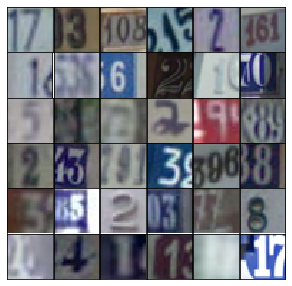

In [7]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

We need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [0]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [0]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Creating some placeholders like normal.

In [0]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Generator network: The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [0]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Discriminator Network: This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [0]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss

In [0]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [0]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

We can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [0]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Function for displaying generated images.

In [0]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

Another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [0]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [0]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2518... Generator Loss: 0.6611
Epoch 1/25... Discriminator Loss: 0.4277... Generator Loss: 1.8235
Epoch 1/25... Discriminator Loss: 0.2259... Generator Loss: 2.0611
Epoch 1/25... Discriminator Loss: 0.1653... Generator Loss: 2.4548
Epoch 1/25... Discriminator Loss: 0.1787... Generator Loss: 2.8638
Epoch 1/25... Discriminator Loss: 0.1160... Generator Loss: 2.7914
Epoch 1/25... Discriminator Loss: 0.1535... Generator Loss: 3.3878
Epoch 1/25... Discriminator Loss: 0.1581... Generator Loss: 3.1554
Epoch 1/25... Discriminator Loss: 0.3322... Generator Loss: 1.8724
Epoch 1/25... Discriminator Loss: 1.3320... Generator Loss: 1.8522


/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


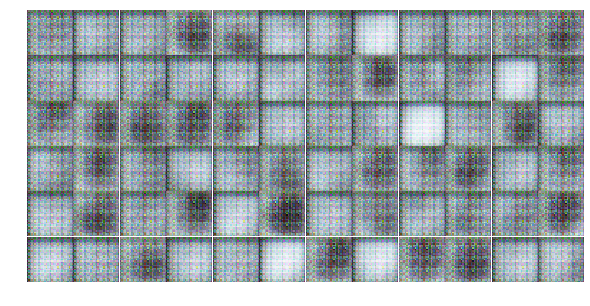

Epoch 1/25... Discriminator Loss: 0.5933... Generator Loss: 2.1695
Epoch 1/25... Discriminator Loss: 0.4658... Generator Loss: 1.9254
Epoch 1/25... Discriminator Loss: 0.4540... Generator Loss: 1.7411
Epoch 1/25... Discriminator Loss: 0.2846... Generator Loss: 2.0789
Epoch 1/25... Discriminator Loss: 1.0395... Generator Loss: 0.8106
Epoch 1/25... Discriminator Loss: 0.3897... Generator Loss: 1.6484
Epoch 1/25... Discriminator Loss: 0.4841... Generator Loss: 1.3629
Epoch 1/25... Discriminator Loss: 0.5021... Generator Loss: 1.3123
Epoch 1/25... Discriminator Loss: 0.2523... Generator Loss: 2.2709
Epoch 1/25... Discriminator Loss: 0.4880... Generator Loss: 2.3734


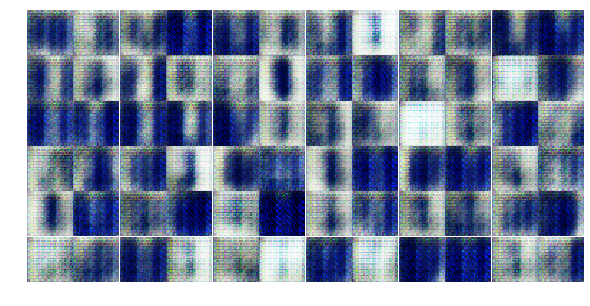

Epoch 1/25... Discriminator Loss: 0.5905... Generator Loss: 3.5933
Epoch 1/25... Discriminator Loss: 0.6015... Generator Loss: 1.1358
Epoch 1/25... Discriminator Loss: 0.7768... Generator Loss: 3.6304
Epoch 1/25... Discriminator Loss: 0.9408... Generator Loss: 0.7424
Epoch 1/25... Discriminator Loss: 0.4931... Generator Loss: 1.7739
Epoch 1/25... Discriminator Loss: 0.2614... Generator Loss: 3.2499
Epoch 1/25... Discriminator Loss: 0.2687... Generator Loss: 2.8631
Epoch 1/25... Discriminator Loss: 1.6070... Generator Loss: 0.4377
Epoch 1/25... Discriminator Loss: 0.6425... Generator Loss: 1.5819
Epoch 1/25... Discriminator Loss: 0.5755... Generator Loss: 1.6499


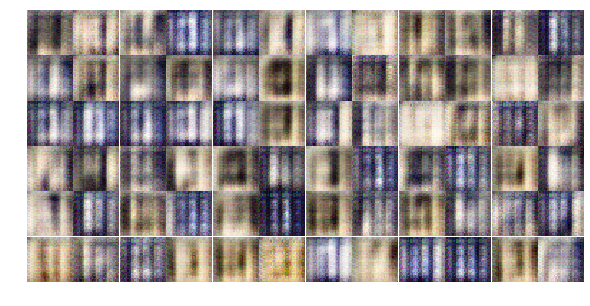

Epoch 1/25... Discriminator Loss: 0.6829... Generator Loss: 1.2585
Epoch 1/25... Discriminator Loss: 1.1389... Generator Loss: 0.8805
Epoch 1/25... Discriminator Loss: 1.0530... Generator Loss: 1.3505
Epoch 1/25... Discriminator Loss: 0.8782... Generator Loss: 1.0591
Epoch 1/25... Discriminator Loss: 1.0703... Generator Loss: 0.8991
Epoch 1/25... Discriminator Loss: 0.9209... Generator Loss: 0.9962
Epoch 1/25... Discriminator Loss: 0.5215... Generator Loss: 1.6107
Epoch 1/25... Discriminator Loss: 0.3947... Generator Loss: 2.6017
Epoch 1/25... Discriminator Loss: 0.5498... Generator Loss: 1.7297
Epoch 1/25... Discriminator Loss: 0.6486... Generator Loss: 1.7449


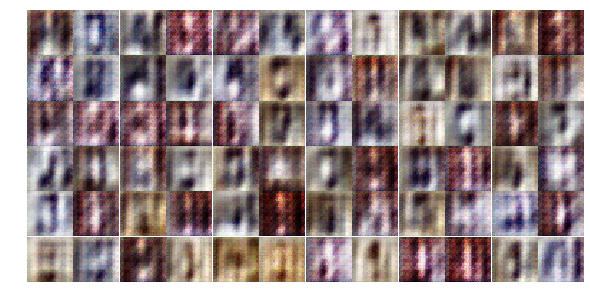

Epoch 1/25... Discriminator Loss: 1.1991... Generator Loss: 0.8291
Epoch 1/25... Discriminator Loss: 1.1762... Generator Loss: 0.9441
Epoch 1/25... Discriminator Loss: 0.7869... Generator Loss: 1.4101
Epoch 1/25... Discriminator Loss: 0.6688... Generator Loss: 1.1179
Epoch 1/25... Discriminator Loss: 1.0721... Generator Loss: 0.9245
Epoch 1/25... Discriminator Loss: 0.5932... Generator Loss: 1.3594
Epoch 1/25... Discriminator Loss: 0.8265... Generator Loss: 1.0454
Epoch 1/25... Discriminator Loss: 1.0295... Generator Loss: 1.0771
Epoch 1/25... Discriminator Loss: 0.9373... Generator Loss: 0.9044
Epoch 1/25... Discriminator Loss: 0.9246... Generator Loss: 1.4579


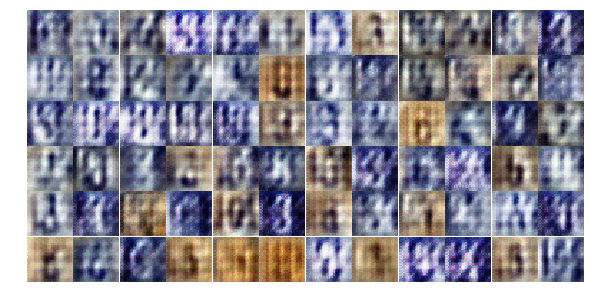

Epoch 1/25... Discriminator Loss: 0.8784... Generator Loss: 1.1712
Epoch 1/25... Discriminator Loss: 0.8925... Generator Loss: 1.4204
Epoch 1/25... Discriminator Loss: 0.8597... Generator Loss: 1.6998
Epoch 1/25... Discriminator Loss: 1.0955... Generator Loss: 1.1132
Epoch 1/25... Discriminator Loss: 0.8073... Generator Loss: 1.0372
Epoch 1/25... Discriminator Loss: 0.6898... Generator Loss: 1.6454
Epoch 1/25... Discriminator Loss: 0.6478... Generator Loss: 1.5651
Epoch 2/25... Discriminator Loss: 0.7336... Generator Loss: 1.3431
Epoch 2/25... Discriminator Loss: 0.6682... Generator Loss: 1.4348
Epoch 2/25... Discriminator Loss: 1.4620... Generator Loss: 0.4965


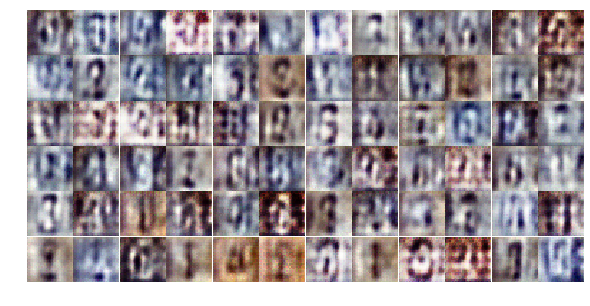

Epoch 2/25... Discriminator Loss: 1.0082... Generator Loss: 1.1529
Epoch 2/25... Discriminator Loss: 0.9678... Generator Loss: 1.0426
Epoch 2/25... Discriminator Loss: 1.0498... Generator Loss: 0.9505
Epoch 2/25... Discriminator Loss: 1.0759... Generator Loss: 1.6002
Epoch 2/25... Discriminator Loss: 1.1000... Generator Loss: 0.8496
Epoch 2/25... Discriminator Loss: 0.9850... Generator Loss: 1.1766
Epoch 2/25... Discriminator Loss: 1.0572... Generator Loss: 1.1695
Epoch 2/25... Discriminator Loss: 0.8556... Generator Loss: 1.2936
Epoch 2/25... Discriminator Loss: 1.0385... Generator Loss: 1.1348
Epoch 2/25... Discriminator Loss: 1.1173... Generator Loss: 0.7774


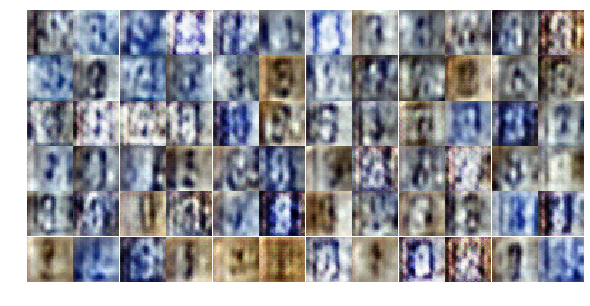

Epoch 2/25... Discriminator Loss: 1.1707... Generator Loss: 0.8936
Epoch 2/25... Discriminator Loss: 1.0755... Generator Loss: 1.1460
Epoch 2/25... Discriminator Loss: 1.1547... Generator Loss: 1.5762
Epoch 2/25... Discriminator Loss: 0.8170... Generator Loss: 1.2362
Epoch 2/25... Discriminator Loss: 0.9425... Generator Loss: 1.5573
Epoch 2/25... Discriminator Loss: 1.3471... Generator Loss: 0.6094
Epoch 2/25... Discriminator Loss: 1.1532... Generator Loss: 0.9513
Epoch 2/25... Discriminator Loss: 1.1119... Generator Loss: 0.7635
Epoch 2/25... Discriminator Loss: 1.1283... Generator Loss: 1.1324
Epoch 2/25... Discriminator Loss: 1.0883... Generator Loss: 0.8089


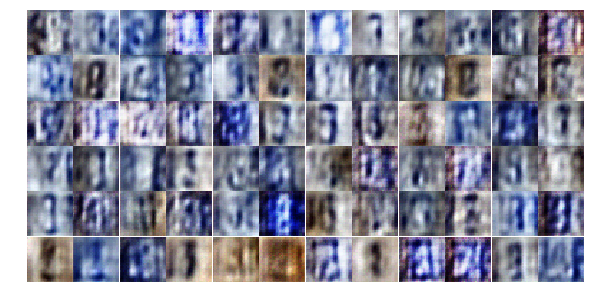

Epoch 2/25... Discriminator Loss: 1.1563... Generator Loss: 0.9111
Epoch 2/25... Discriminator Loss: 0.9201... Generator Loss: 1.2214
Epoch 2/25... Discriminator Loss: 0.9202... Generator Loss: 1.0914
Epoch 2/25... Discriminator Loss: 0.9394... Generator Loss: 1.2863
Epoch 2/25... Discriminator Loss: 1.0747... Generator Loss: 1.2248
Epoch 2/25... Discriminator Loss: 0.8087... Generator Loss: 0.9722
Epoch 2/25... Discriminator Loss: 1.0900... Generator Loss: 0.8304
Epoch 2/25... Discriminator Loss: 1.3937... Generator Loss: 0.5220
Epoch 2/25... Discriminator Loss: 1.2959... Generator Loss: 1.0198
Epoch 2/25... Discriminator Loss: 0.9306... Generator Loss: 0.9941


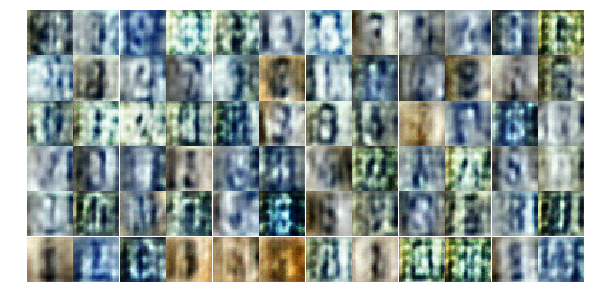

Epoch 2/25... Discriminator Loss: 1.1331... Generator Loss: 1.1124
Epoch 2/25... Discriminator Loss: 0.9399... Generator Loss: 1.0075
Epoch 2/25... Discriminator Loss: 1.2770... Generator Loss: 0.5304
Epoch 2/25... Discriminator Loss: 1.1577... Generator Loss: 0.8276
Epoch 2/25... Discriminator Loss: 0.7479... Generator Loss: 2.0321
Epoch 2/25... Discriminator Loss: 0.7700... Generator Loss: 1.5242
Epoch 2/25... Discriminator Loss: 0.9959... Generator Loss: 0.8818
Epoch 2/25... Discriminator Loss: 0.8918... Generator Loss: 2.2248
Epoch 2/25... Discriminator Loss: 1.1709... Generator Loss: 0.8176
Epoch 2/25... Discriminator Loss: 1.0200... Generator Loss: 2.6574


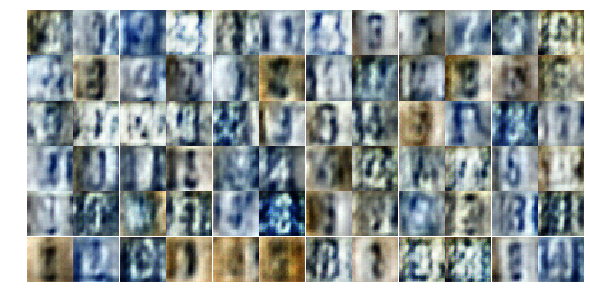

Epoch 2/25... Discriminator Loss: 0.9057... Generator Loss: 0.9265
Epoch 2/25... Discriminator Loss: 2.0007... Generator Loss: 2.5277
Epoch 2/25... Discriminator Loss: 1.0770... Generator Loss: 0.7878
Epoch 2/25... Discriminator Loss: 1.0264... Generator Loss: 1.0968
Epoch 2/25... Discriminator Loss: 0.9443... Generator Loss: 1.3701
Epoch 2/25... Discriminator Loss: 1.6021... Generator Loss: 0.3784
Epoch 2/25... Discriminator Loss: 1.0567... Generator Loss: 2.6653
Epoch 2/25... Discriminator Loss: 0.9514... Generator Loss: 1.7816
Epoch 2/25... Discriminator Loss: 0.4825... Generator Loss: 1.9046
Epoch 2/25... Discriminator Loss: 0.7124... Generator Loss: 1.2543


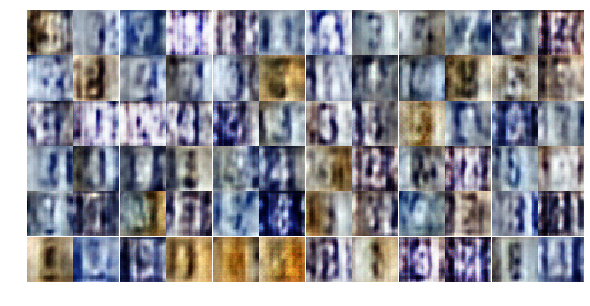

Epoch 2/25... Discriminator Loss: 1.0617... Generator Loss: 0.5595
Epoch 2/25... Discriminator Loss: 1.3628... Generator Loss: 0.3880
Epoch 2/25... Discriminator Loss: 1.7172... Generator Loss: 0.3022
Epoch 2/25... Discriminator Loss: 1.2536... Generator Loss: 0.8086
Epoch 3/25... Discriminator Loss: 0.6325... Generator Loss: 1.1963
Epoch 3/25... Discriminator Loss: 0.7740... Generator Loss: 2.7580
Epoch 3/25... Discriminator Loss: 1.4693... Generator Loss: 2.6519
Epoch 3/25... Discriminator Loss: 0.7546... Generator Loss: 1.0470
Epoch 3/25... Discriminator Loss: 0.8380... Generator Loss: 1.4076
Epoch 3/25... Discriminator Loss: 1.0058... Generator Loss: 1.0580


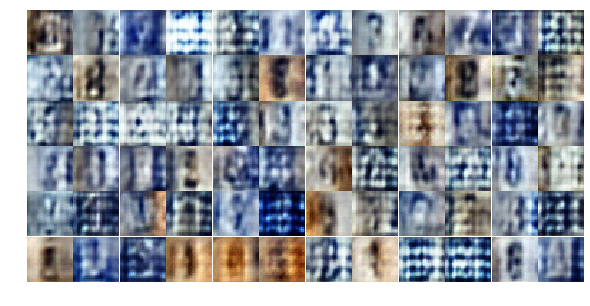

Epoch 3/25... Discriminator Loss: 0.4872... Generator Loss: 2.1356
Epoch 3/25... Discriminator Loss: 0.8922... Generator Loss: 1.6201
Epoch 3/25... Discriminator Loss: 0.7935... Generator Loss: 0.9337
Epoch 3/25... Discriminator Loss: 0.6165... Generator Loss: 1.1700
Epoch 3/25... Discriminator Loss: 1.5519... Generator Loss: 0.6860
Epoch 3/25... Discriminator Loss: 0.8109... Generator Loss: 1.3130
Epoch 3/25... Discriminator Loss: 0.5132... Generator Loss: 2.3223
Epoch 3/25... Discriminator Loss: 0.7661... Generator Loss: 2.1208
Epoch 3/25... Discriminator Loss: 1.0663... Generator Loss: 0.5858
Epoch 3/25... Discriminator Loss: 0.6619... Generator Loss: 2.1379


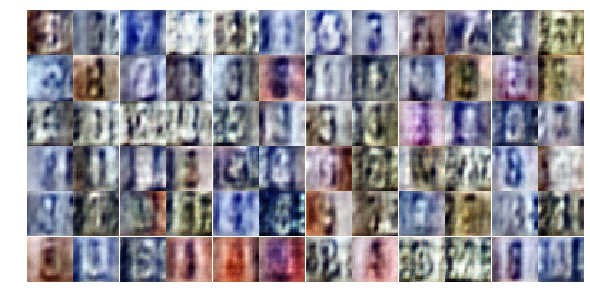

Epoch 3/25... Discriminator Loss: 0.7085... Generator Loss: 1.7434
Epoch 3/25... Discriminator Loss: 0.4420... Generator Loss: 1.3951
Epoch 3/25... Discriminator Loss: 0.9114... Generator Loss: 3.9060
Epoch 3/25... Discriminator Loss: 0.9984... Generator Loss: 1.7581
Epoch 3/25... Discriminator Loss: 0.8403... Generator Loss: 1.2899
Epoch 3/25... Discriminator Loss: 0.4048... Generator Loss: 2.3863
Epoch 3/25... Discriminator Loss: 1.2093... Generator Loss: 0.5033
Epoch 3/25... Discriminator Loss: 0.9064... Generator Loss: 2.2706
Epoch 3/25... Discriminator Loss: 0.5971... Generator Loss: 1.6443
Epoch 3/25... Discriminator Loss: 0.8561... Generator Loss: 0.8186


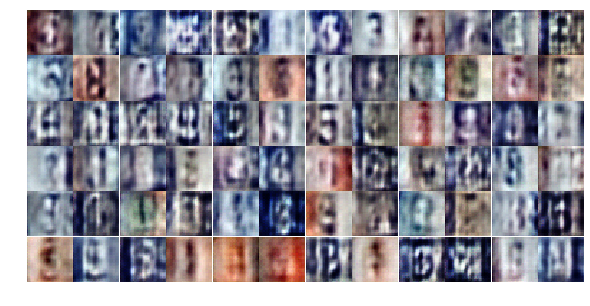

Epoch 3/25... Discriminator Loss: 0.5051... Generator Loss: 1.5492
Epoch 3/25... Discriminator Loss: 0.6499... Generator Loss: 1.1176
Epoch 3/25... Discriminator Loss: 0.7452... Generator Loss: 0.8795
Epoch 3/25... Discriminator Loss: 0.3442... Generator Loss: 2.1475
Epoch 3/25... Discriminator Loss: 0.6327... Generator Loss: 1.7085
Epoch 3/25... Discriminator Loss: 0.9675... Generator Loss: 3.2195
Epoch 3/25... Discriminator Loss: 0.9248... Generator Loss: 1.0863
Epoch 3/25... Discriminator Loss: 1.0540... Generator Loss: 0.6179
Epoch 3/25... Discriminator Loss: 0.4168... Generator Loss: 1.9596
Epoch 3/25... Discriminator Loss: 1.0002... Generator Loss: 0.6345


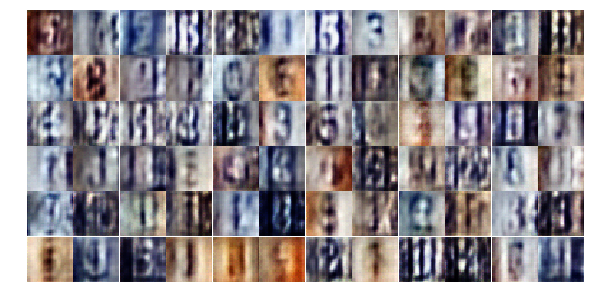

Epoch 3/25... Discriminator Loss: 0.9069... Generator Loss: 3.4012
Epoch 3/25... Discriminator Loss: 0.5907... Generator Loss: 3.0872
Epoch 3/25... Discriminator Loss: 0.4412... Generator Loss: 2.0035
Epoch 3/25... Discriminator Loss: 0.6949... Generator Loss: 1.1015
Epoch 3/25... Discriminator Loss: 0.5025... Generator Loss: 1.3447
Epoch 3/25... Discriminator Loss: 0.3268... Generator Loss: 2.2606
Epoch 3/25... Discriminator Loss: 0.5251... Generator Loss: 2.0071
Epoch 3/25... Discriminator Loss: 0.5328... Generator Loss: 1.3571
Epoch 3/25... Discriminator Loss: 1.4762... Generator Loss: 3.1174
Epoch 3/25... Discriminator Loss: 0.4744... Generator Loss: 3.0457


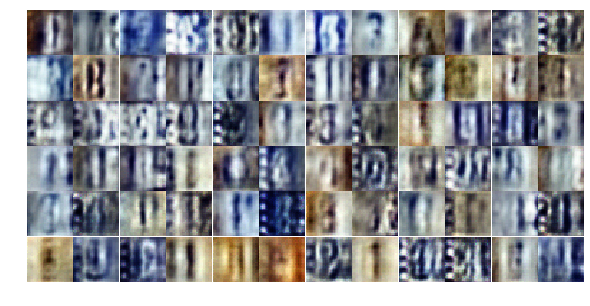

Epoch 3/25... Discriminator Loss: 0.9061... Generator Loss: 1.2637
Epoch 3/25... Discriminator Loss: 0.4736... Generator Loss: 1.5156
Epoch 3/25... Discriminator Loss: 0.8569... Generator Loss: 0.8551
Epoch 3/25... Discriminator Loss: 0.5187... Generator Loss: 1.3636
Epoch 3/25... Discriminator Loss: 0.2623... Generator Loss: 2.0631
Epoch 3/25... Discriminator Loss: 0.4002... Generator Loss: 1.6534
Epoch 3/25... Discriminator Loss: 0.6283... Generator Loss: 1.7292
Epoch 3/25... Discriminator Loss: 0.4848... Generator Loss: 2.1411
Epoch 3/25... Discriminator Loss: 0.3472... Generator Loss: 2.2453
Epoch 3/25... Discriminator Loss: 0.4305... Generator Loss: 2.0044


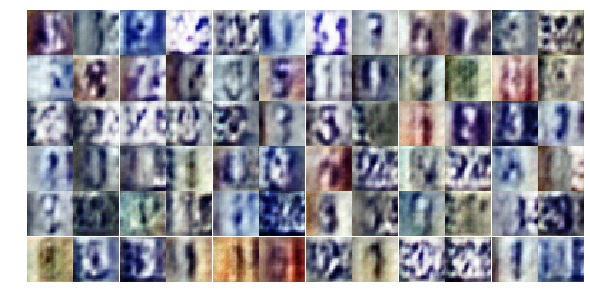

Epoch 3/25... Discriminator Loss: 0.6568... Generator Loss: 1.0875
Epoch 4/25... Discriminator Loss: 0.4991... Generator Loss: 1.8784
Epoch 4/25... Discriminator Loss: 0.5645... Generator Loss: 1.5229
Epoch 4/25... Discriminator Loss: 0.4239... Generator Loss: 2.5164
Epoch 4/25... Discriminator Loss: 0.8617... Generator Loss: 1.8688
Epoch 4/25... Discriminator Loss: 0.5886... Generator Loss: 2.7054
Epoch 4/25... Discriminator Loss: 0.6529... Generator Loss: 3.2322
Epoch 4/25... Discriminator Loss: 0.6953... Generator Loss: 2.3527
Epoch 4/25... Discriminator Loss: 0.4453... Generator Loss: 1.6480
Epoch 4/25... Discriminator Loss: 0.4822... Generator Loss: 1.4664


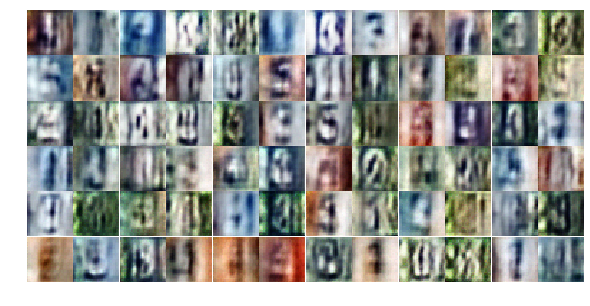

Epoch 4/25... Discriminator Loss: 0.6424... Generator Loss: 1.1712
Epoch 4/25... Discriminator Loss: 0.6366... Generator Loss: 1.7175
Epoch 4/25... Discriminator Loss: 0.5849... Generator Loss: 1.2015
Epoch 4/25... Discriminator Loss: 0.8122... Generator Loss: 0.9290
Epoch 4/25... Discriminator Loss: 0.6516... Generator Loss: 1.1114
Epoch 4/25... Discriminator Loss: 0.4293... Generator Loss: 1.6982
Epoch 4/25... Discriminator Loss: 0.7244... Generator Loss: 2.8964
Epoch 4/25... Discriminator Loss: 1.3238... Generator Loss: 0.7020
Epoch 4/25... Discriminator Loss: 0.6424... Generator Loss: 1.7011
Epoch 4/25... Discriminator Loss: 0.6316... Generator Loss: 2.1258


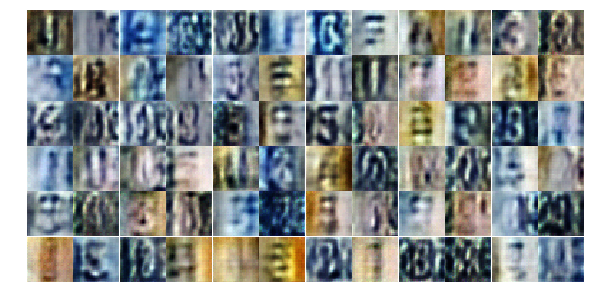

Epoch 4/25... Discriminator Loss: 1.0128... Generator Loss: 0.8228
Epoch 4/25... Discriminator Loss: 0.4627... Generator Loss: 1.9514
Epoch 4/25... Discriminator Loss: 1.0213... Generator Loss: 2.0155
Epoch 4/25... Discriminator Loss: 0.9307... Generator Loss: 0.8308
Epoch 4/25... Discriminator Loss: 0.6913... Generator Loss: 1.1020
Epoch 4/25... Discriminator Loss: 0.5000... Generator Loss: 2.0723
Epoch 4/25... Discriminator Loss: 0.6632... Generator Loss: 1.2173
Epoch 4/25... Discriminator Loss: 1.6355... Generator Loss: 3.4065
Epoch 4/25... Discriminator Loss: 0.5507... Generator Loss: 1.8385
Epoch 4/25... Discriminator Loss: 0.9764... Generator Loss: 0.7240


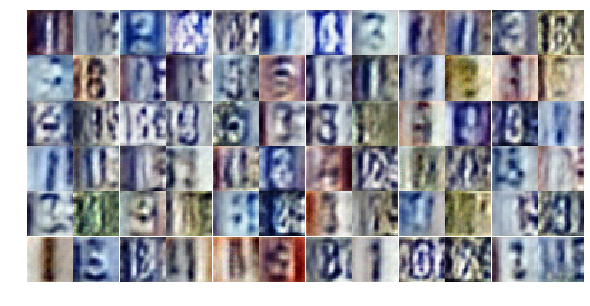

Epoch 4/25... Discriminator Loss: 0.3555... Generator Loss: 1.9669
Epoch 4/25... Discriminator Loss: 0.5100... Generator Loss: 1.6540
Epoch 4/25... Discriminator Loss: 0.5413... Generator Loss: 1.3318
Epoch 4/25... Discriminator Loss: 0.6695... Generator Loss: 1.7698
Epoch 4/25... Discriminator Loss: 0.4283... Generator Loss: 1.4609
Epoch 4/25... Discriminator Loss: 0.5021... Generator Loss: 1.8808
Epoch 4/25... Discriminator Loss: 0.8060... Generator Loss: 2.6761
Epoch 4/25... Discriminator Loss: 0.5392... Generator Loss: 2.5399
Epoch 4/25... Discriminator Loss: 0.5713... Generator Loss: 1.7843
Epoch 4/25... Discriminator Loss: 0.6061... Generator Loss: 1.3307


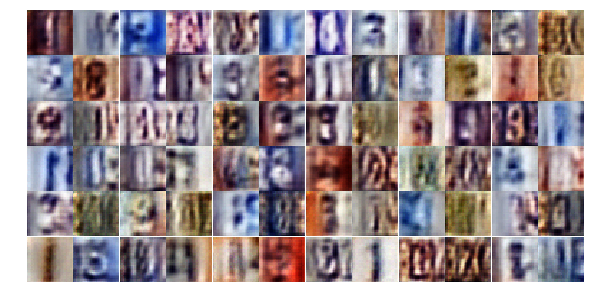

Epoch 4/25... Discriminator Loss: 0.5677... Generator Loss: 1.3601
Epoch 4/25... Discriminator Loss: 0.4512... Generator Loss: 1.8218
Epoch 4/25... Discriminator Loss: 0.4890... Generator Loss: 1.8584
Epoch 4/25... Discriminator Loss: 0.3688... Generator Loss: 2.4338
Epoch 4/25... Discriminator Loss: 0.4320... Generator Loss: 1.6111
Epoch 4/25... Discriminator Loss: 3.6456... Generator Loss: 5.1336
Epoch 4/25... Discriminator Loss: 0.8000... Generator Loss: 0.9156
Epoch 4/25... Discriminator Loss: 0.9232... Generator Loss: 1.2977
Epoch 4/25... Discriminator Loss: 0.6629... Generator Loss: 1.3269
Epoch 4/25... Discriminator Loss: 0.5205... Generator Loss: 1.7225


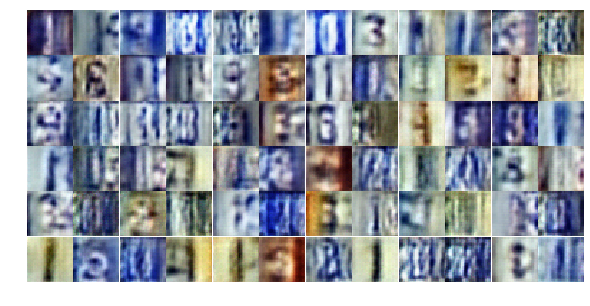

Epoch 4/25... Discriminator Loss: 0.4114... Generator Loss: 1.8755
Epoch 4/25... Discriminator Loss: 0.4039... Generator Loss: 2.1332
Epoch 4/25... Discriminator Loss: 0.4952... Generator Loss: 1.3626
Epoch 4/25... Discriminator Loss: 0.6350... Generator Loss: 1.2085
Epoch 4/25... Discriminator Loss: 0.8380... Generator Loss: 0.9339
Epoch 4/25... Discriminator Loss: 0.5030... Generator Loss: 1.5645
Epoch 4/25... Discriminator Loss: 0.5153... Generator Loss: 1.5724
Epoch 4/25... Discriminator Loss: 0.6596... Generator Loss: 2.5015
Epoch 4/25... Discriminator Loss: 0.7348... Generator Loss: 1.1593
Epoch 5/25... Discriminator Loss: 0.3416... Generator Loss: 1.9043


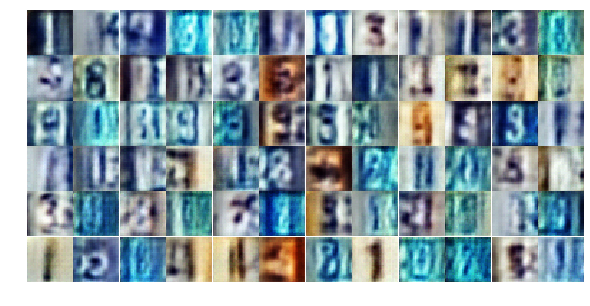

Epoch 5/25... Discriminator Loss: 0.6349... Generator Loss: 1.2547
Epoch 5/25... Discriminator Loss: 0.6159... Generator Loss: 1.1626
Epoch 5/25... Discriminator Loss: 1.0428... Generator Loss: 3.2372
Epoch 5/25... Discriminator Loss: 0.9721... Generator Loss: 0.6926
Epoch 5/25... Discriminator Loss: 0.4266... Generator Loss: 1.7632
Epoch 5/25... Discriminator Loss: 0.5666... Generator Loss: 1.3420
Epoch 5/25... Discriminator Loss: 0.6505... Generator Loss: 2.2345
Epoch 5/25... Discriminator Loss: 0.6542... Generator Loss: 1.0605
Epoch 5/25... Discriminator Loss: 0.6332... Generator Loss: 1.4201
Epoch 5/25... Discriminator Loss: 0.5405... Generator Loss: 1.3973


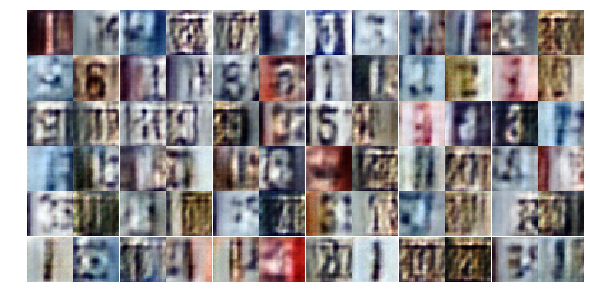

Epoch 5/25... Discriminator Loss: 0.9343... Generator Loss: 0.7244
Epoch 5/25... Discriminator Loss: 0.6029... Generator Loss: 1.1620
Epoch 5/25... Discriminator Loss: 0.5098... Generator Loss: 2.2508
Epoch 5/25... Discriminator Loss: 1.3204... Generator Loss: 0.4517
Epoch 5/25... Discriminator Loss: 0.4509... Generator Loss: 1.5779
Epoch 5/25... Discriminator Loss: 0.9277... Generator Loss: 0.7271
Epoch 5/25... Discriminator Loss: 0.4912... Generator Loss: 1.5261
Epoch 5/25... Discriminator Loss: 0.4940... Generator Loss: 1.5747
Epoch 5/25... Discriminator Loss: 0.4445... Generator Loss: 1.7027
Epoch 5/25... Discriminator Loss: 0.4058... Generator Loss: 1.9699


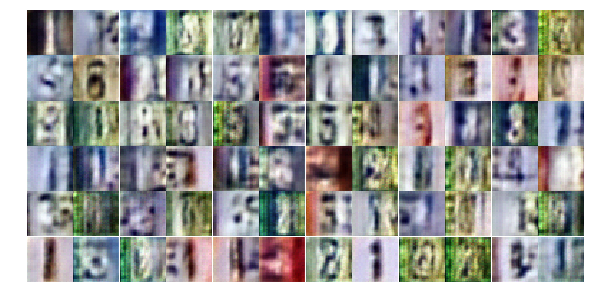

Epoch 5/25... Discriminator Loss: 0.6660... Generator Loss: 1.4035
Epoch 5/25... Discriminator Loss: 0.7853... Generator Loss: 2.1671
Epoch 5/25... Discriminator Loss: 0.5776... Generator Loss: 1.3827
Epoch 5/25... Discriminator Loss: 0.5250... Generator Loss: 1.4017
Epoch 5/25... Discriminator Loss: 1.1950... Generator Loss: 0.4821
Epoch 5/25... Discriminator Loss: 0.4111... Generator Loss: 1.5662
Epoch 5/25... Discriminator Loss: 0.6518... Generator Loss: 1.1711
Epoch 5/25... Discriminator Loss: 0.8114... Generator Loss: 0.8252
Epoch 5/25... Discriminator Loss: 0.6693... Generator Loss: 1.0385
Epoch 5/25... Discriminator Loss: 0.3850... Generator Loss: 1.7948


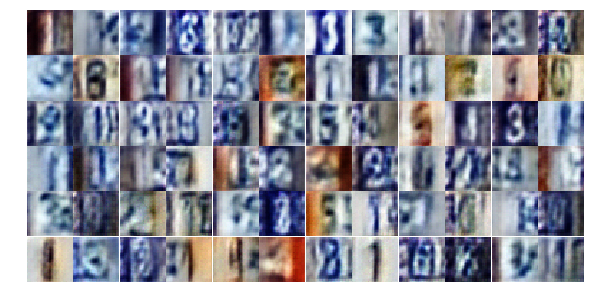

Epoch 5/25... Discriminator Loss: 0.4897... Generator Loss: 1.8970
Epoch 5/25... Discriminator Loss: 0.3152... Generator Loss: 1.8670
Epoch 5/25... Discriminator Loss: 0.6253... Generator Loss: 2.5853
Epoch 5/25... Discriminator Loss: 0.4903... Generator Loss: 1.3451
Epoch 5/25... Discriminator Loss: 0.4223... Generator Loss: 2.1579
Epoch 5/25... Discriminator Loss: 0.4612... Generator Loss: 2.2917
Epoch 5/25... Discriminator Loss: 0.9235... Generator Loss: 0.7097
Epoch 5/25... Discriminator Loss: 0.4595... Generator Loss: 1.5295
Epoch 5/25... Discriminator Loss: 0.8946... Generator Loss: 0.7263
Epoch 5/25... Discriminator Loss: 0.4781... Generator Loss: 1.4332


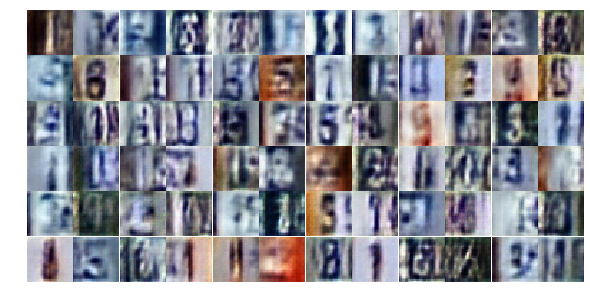

Epoch 5/25... Discriminator Loss: 0.5722... Generator Loss: 1.1724
Epoch 5/25... Discriminator Loss: 1.2416... Generator Loss: 0.4387
Epoch 5/25... Discriminator Loss: 0.5309... Generator Loss: 1.5488
Epoch 5/25... Discriminator Loss: 0.4008... Generator Loss: 1.6313
Epoch 5/25... Discriminator Loss: 0.9629... Generator Loss: 0.7483
Epoch 5/25... Discriminator Loss: 1.0644... Generator Loss: 0.5575
Epoch 5/25... Discriminator Loss: 1.3814... Generator Loss: 0.3997
Epoch 5/25... Discriminator Loss: 0.5926... Generator Loss: 1.4463
Epoch 5/25... Discriminator Loss: 0.4911... Generator Loss: 1.5208
Epoch 5/25... Discriminator Loss: 0.3814... Generator Loss: 1.9698


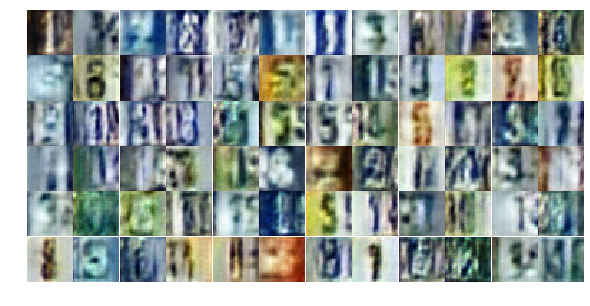

Epoch 5/25... Discriminator Loss: 0.9834... Generator Loss: 1.1462
Epoch 5/25... Discriminator Loss: 1.0497... Generator Loss: 0.5687
Epoch 5/25... Discriminator Loss: 0.7359... Generator Loss: 1.3073
Epoch 5/25... Discriminator Loss: 0.6337... Generator Loss: 1.6251
Epoch 5/25... Discriminator Loss: 0.5312... Generator Loss: 1.2657
Epoch 5/25... Discriminator Loss: 1.1056... Generator Loss: 0.5473
Epoch 6/25... Discriminator Loss: 0.8123... Generator Loss: 0.8013
Epoch 6/25... Discriminator Loss: 0.5259... Generator Loss: 1.2377
Epoch 6/25... Discriminator Loss: 0.5319... Generator Loss: 1.3133
Epoch 6/25... Discriminator Loss: 1.0058... Generator Loss: 0.6573


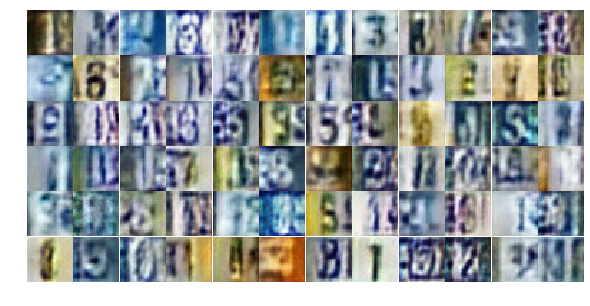

Epoch 6/25... Discriminator Loss: 0.5033... Generator Loss: 1.2715
Epoch 6/25... Discriminator Loss: 0.4546... Generator Loss: 1.7399
Epoch 6/25... Discriminator Loss: 0.6570... Generator Loss: 1.0273
Epoch 6/25... Discriminator Loss: 0.5691... Generator Loss: 1.6898
Epoch 6/25... Discriminator Loss: 0.9931... Generator Loss: 0.6875
Epoch 6/25... Discriminator Loss: 0.4381... Generator Loss: 1.4749
Epoch 6/25... Discriminator Loss: 0.4489... Generator Loss: 1.8865
Epoch 6/25... Discriminator Loss: 0.7601... Generator Loss: 2.0347
Epoch 6/25... Discriminator Loss: 0.8454... Generator Loss: 1.7657
Epoch 6/25... Discriminator Loss: 0.6843... Generator Loss: 1.2842


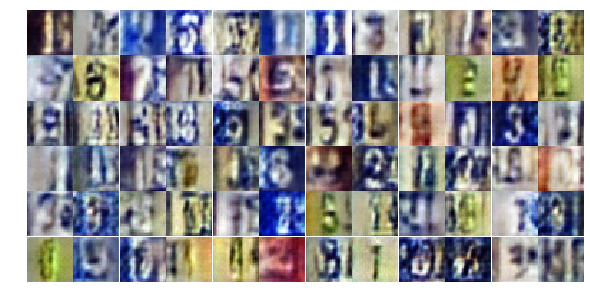

Epoch 6/25... Discriminator Loss: 0.4469... Generator Loss: 1.6727
Epoch 6/25... Discriminator Loss: 0.5155... Generator Loss: 1.4656
Epoch 6/25... Discriminator Loss: 1.2310... Generator Loss: 0.4798
Epoch 6/25... Discriminator Loss: 0.3000... Generator Loss: 2.2688
Epoch 6/25... Discriminator Loss: 0.5692... Generator Loss: 1.2261
Epoch 6/25... Discriminator Loss: 0.4833... Generator Loss: 1.6335
Epoch 6/25... Discriminator Loss: 0.5546... Generator Loss: 1.2878
Epoch 6/25... Discriminator Loss: 0.6349... Generator Loss: 1.0599
Epoch 6/25... Discriminator Loss: 0.4598... Generator Loss: 2.1915
Epoch 6/25... Discriminator Loss: 0.5627... Generator Loss: 1.2343


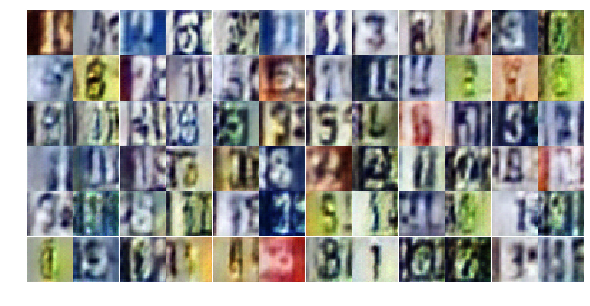

Epoch 6/25... Discriminator Loss: 0.7854... Generator Loss: 0.8175
Epoch 6/25... Discriminator Loss: 1.1472... Generator Loss: 0.5061
Epoch 6/25... Discriminator Loss: 0.9058... Generator Loss: 0.7255
Epoch 6/25... Discriminator Loss: 0.4623... Generator Loss: 1.2887
Epoch 6/25... Discriminator Loss: 1.4238... Generator Loss: 4.2181
Epoch 6/25... Discriminator Loss: 1.6348... Generator Loss: 0.3807
Epoch 6/25... Discriminator Loss: 0.5627... Generator Loss: 1.3566
Epoch 6/25... Discriminator Loss: 0.3221... Generator Loss: 1.9175
Epoch 6/25... Discriminator Loss: 0.6713... Generator Loss: 1.0627
Epoch 6/25... Discriminator Loss: 0.4788... Generator Loss: 1.6469


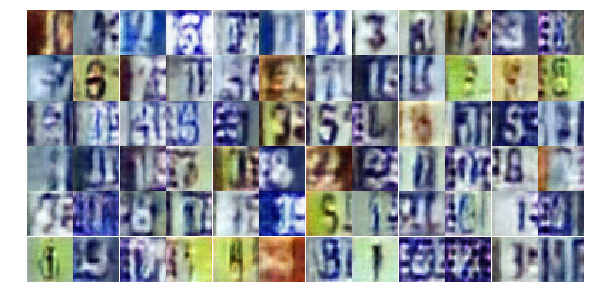

Epoch 6/25... Discriminator Loss: 0.5790... Generator Loss: 1.0962
Epoch 6/25... Discriminator Loss: 0.6020... Generator Loss: 1.3864
Epoch 6/25... Discriminator Loss: 0.8547... Generator Loss: 0.7298
Epoch 6/25... Discriminator Loss: 0.6668... Generator Loss: 1.1847
Epoch 6/25... Discriminator Loss: 0.7349... Generator Loss: 0.9761
Epoch 6/25... Discriminator Loss: 0.6300... Generator Loss: 1.0585
Epoch 6/25... Discriminator Loss: 0.4193... Generator Loss: 1.6335
Epoch 6/25... Discriminator Loss: 0.4268... Generator Loss: 1.8896
Epoch 6/25... Discriminator Loss: 0.8867... Generator Loss: 0.7283
Epoch 6/25... Discriminator Loss: 0.3341... Generator Loss: 1.6631


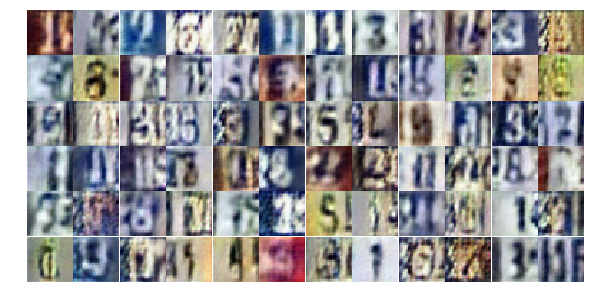

Epoch 6/25... Discriminator Loss: 0.8492... Generator Loss: 0.8732
Epoch 6/25... Discriminator Loss: 1.4774... Generator Loss: 0.4122
Epoch 6/25... Discriminator Loss: 0.9234... Generator Loss: 0.7083
Epoch 6/25... Discriminator Loss: 0.6765... Generator Loss: 1.8597
Epoch 6/25... Discriminator Loss: 0.5348... Generator Loss: 1.7058
Epoch 6/25... Discriminator Loss: 0.3924... Generator Loss: 2.0126
Epoch 6/25... Discriminator Loss: 0.6691... Generator Loss: 1.1108
Epoch 6/25... Discriminator Loss: 0.8122... Generator Loss: 0.8024
Epoch 6/25... Discriminator Loss: 0.5897... Generator Loss: 1.2425
Epoch 6/25... Discriminator Loss: 1.7822... Generator Loss: 0.2729


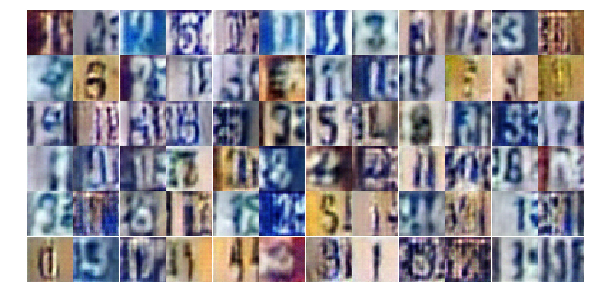

Epoch 6/25... Discriminator Loss: 0.5145... Generator Loss: 1.2240
Epoch 6/25... Discriminator Loss: 0.8653... Generator Loss: 0.7135
Epoch 6/25... Discriminator Loss: 0.5969... Generator Loss: 1.1875
Epoch 7/25... Discriminator Loss: 0.6582... Generator Loss: 1.6195
Epoch 7/25... Discriminator Loss: 0.5924... Generator Loss: 1.3008
Epoch 7/25... Discriminator Loss: 0.7189... Generator Loss: 1.6895
Epoch 7/25... Discriminator Loss: 1.6367... Generator Loss: 0.3133
Epoch 7/25... Discriminator Loss: 0.5306... Generator Loss: 1.6391
Epoch 7/25... Discriminator Loss: 0.6110... Generator Loss: 1.2267
Epoch 7/25... Discriminator Loss: 0.7366... Generator Loss: 0.9087


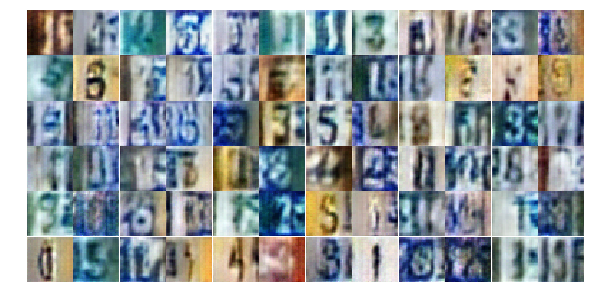

Epoch 7/25... Discriminator Loss: 0.6278... Generator Loss: 1.1063
Epoch 7/25... Discriminator Loss: 0.7797... Generator Loss: 0.9031
Epoch 7/25... Discriminator Loss: 0.4468... Generator Loss: 1.6278
Epoch 7/25... Discriminator Loss: 0.3806... Generator Loss: 1.7230
Epoch 7/25... Discriminator Loss: 0.5620... Generator Loss: 1.1953
Epoch 7/25... Discriminator Loss: 0.5172... Generator Loss: 1.2942
Epoch 7/25... Discriminator Loss: 0.8405... Generator Loss: 2.7677
Epoch 7/25... Discriminator Loss: 1.2402... Generator Loss: 3.1174
Epoch 7/25... Discriminator Loss: 0.5182... Generator Loss: 1.9543
Epoch 7/25... Discriminator Loss: 1.2454... Generator Loss: 0.4824


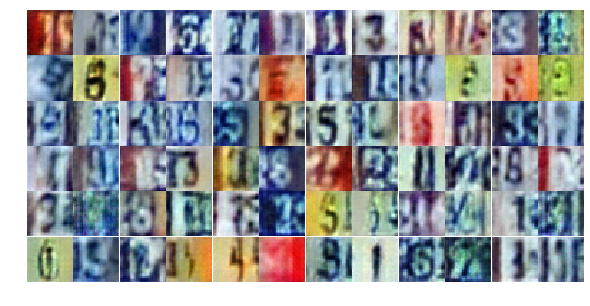

Epoch 7/25... Discriminator Loss: 0.7530... Generator Loss: 0.9820
Epoch 7/25... Discriminator Loss: 0.3288... Generator Loss: 2.1679
Epoch 7/25... Discriminator Loss: 0.8875... Generator Loss: 0.7359
Epoch 7/25... Discriminator Loss: 0.4644... Generator Loss: 1.4528
Epoch 7/25... Discriminator Loss: 0.4271... Generator Loss: 1.6099
Epoch 7/25... Discriminator Loss: 0.5147... Generator Loss: 2.4725
Epoch 7/25... Discriminator Loss: 0.6415... Generator Loss: 1.0952
Epoch 7/25... Discriminator Loss: 0.7066... Generator Loss: 1.0203
Epoch 7/25... Discriminator Loss: 0.3588... Generator Loss: 1.8967
Epoch 7/25... Discriminator Loss: 0.7011... Generator Loss: 2.3519


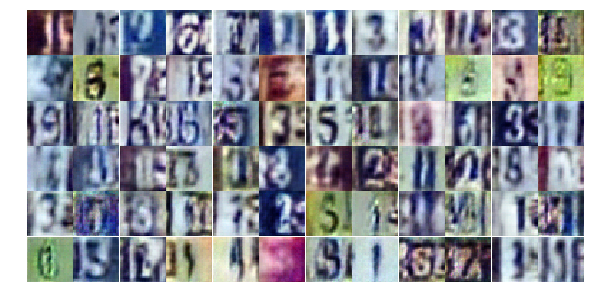

Epoch 7/25... Discriminator Loss: 0.3425... Generator Loss: 1.6851
Epoch 7/25... Discriminator Loss: 0.6452... Generator Loss: 1.0153
Epoch 7/25... Discriminator Loss: 0.7335... Generator Loss: 1.4905
Epoch 7/25... Discriminator Loss: 0.4932... Generator Loss: 1.5097
Epoch 7/25... Discriminator Loss: 0.5978... Generator Loss: 1.1940
Epoch 7/25... Discriminator Loss: 0.8354... Generator Loss: 0.8218
Epoch 7/25... Discriminator Loss: 0.5578... Generator Loss: 1.2851
Epoch 7/25... Discriminator Loss: 1.4085... Generator Loss: 0.3739
Epoch 7/25... Discriminator Loss: 1.0893... Generator Loss: 0.5857
Epoch 7/25... Discriminator Loss: 0.5410... Generator Loss: 2.8429


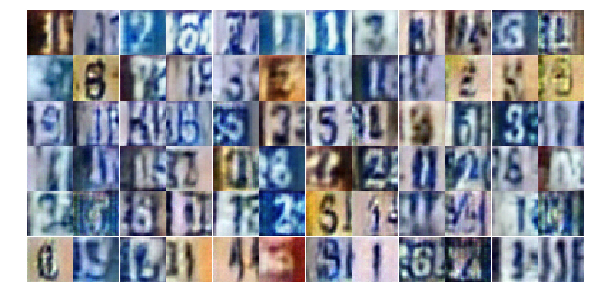

Epoch 7/25... Discriminator Loss: 1.0849... Generator Loss: 0.5962
Epoch 7/25... Discriminator Loss: 0.6540... Generator Loss: 1.0252
Epoch 7/25... Discriminator Loss: 0.3430... Generator Loss: 1.7710
Epoch 7/25... Discriminator Loss: 0.4943... Generator Loss: 1.9265
Epoch 7/25... Discriminator Loss: 0.7179... Generator Loss: 0.8794
Epoch 7/25... Discriminator Loss: 0.3960... Generator Loss: 1.6561
Epoch 7/25... Discriminator Loss: 0.3649... Generator Loss: 1.9549
Epoch 7/25... Discriminator Loss: 0.7317... Generator Loss: 1.5814
Epoch 7/25... Discriminator Loss: 0.3739... Generator Loss: 3.1694
Epoch 7/25... Discriminator Loss: 0.9638... Generator Loss: 0.8113


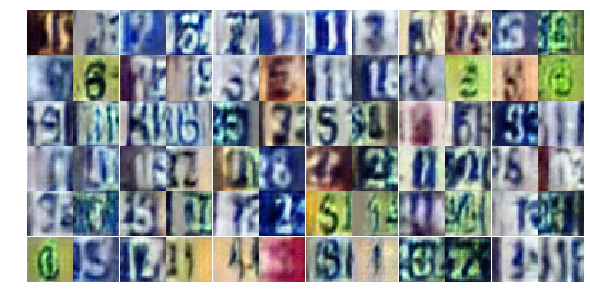

Epoch 7/25... Discriminator Loss: 0.5014... Generator Loss: 1.8752
Epoch 7/25... Discriminator Loss: 0.4278... Generator Loss: 1.5657
Epoch 7/25... Discriminator Loss: 0.8114... Generator Loss: 0.7828
Epoch 7/25... Discriminator Loss: 0.5595... Generator Loss: 1.3583
Epoch 7/25... Discriminator Loss: 0.5719... Generator Loss: 1.1824
Epoch 7/25... Discriminator Loss: 0.9655... Generator Loss: 0.7154
Epoch 7/25... Discriminator Loss: 1.6602... Generator Loss: 0.2909
Epoch 7/25... Discriminator Loss: 0.7207... Generator Loss: 1.1048
Epoch 7/25... Discriminator Loss: 0.5647... Generator Loss: 1.2879
Epoch 7/25... Discriminator Loss: 0.5696... Generator Loss: 1.0851


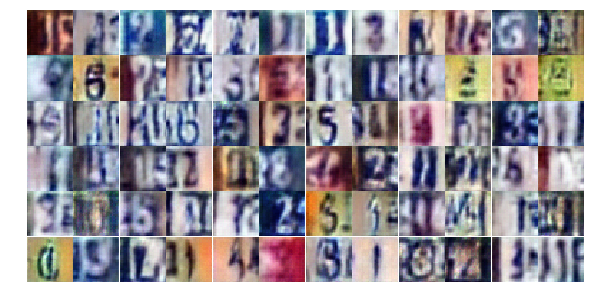

Epoch 7/25... Discriminator Loss: 0.4804... Generator Loss: 2.1851
Epoch 8/25... Discriminator Loss: 0.5136... Generator Loss: 1.2166
Epoch 8/25... Discriminator Loss: 0.8149... Generator Loss: 0.7383
Epoch 8/25... Discriminator Loss: 0.8668... Generator Loss: 0.7499
Epoch 8/25... Discriminator Loss: 0.6858... Generator Loss: 1.0097
Epoch 8/25... Discriminator Loss: 1.1085... Generator Loss: 0.6308
Epoch 8/25... Discriminator Loss: 1.2558... Generator Loss: 0.4449
Epoch 8/25... Discriminator Loss: 0.6172... Generator Loss: 2.2761
Epoch 8/25... Discriminator Loss: 1.7976... Generator Loss: 0.2910
Epoch 8/25... Discriminator Loss: 0.9458... Generator Loss: 0.8786


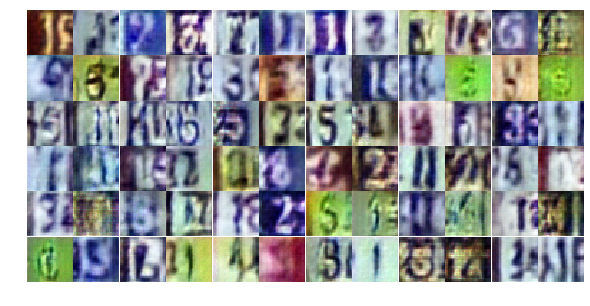

Epoch 8/25... Discriminator Loss: 0.4366... Generator Loss: 1.9192
Epoch 8/25... Discriminator Loss: 0.4351... Generator Loss: 2.4235
Epoch 8/25... Discriminator Loss: 0.8861... Generator Loss: 0.7369
Epoch 8/25... Discriminator Loss: 0.4144... Generator Loss: 1.5663
Epoch 8/25... Discriminator Loss: 0.9496... Generator Loss: 0.6774
Epoch 8/25... Discriminator Loss: 0.6429... Generator Loss: 1.5464
Epoch 8/25... Discriminator Loss: 0.5978... Generator Loss: 1.3105
Epoch 8/25... Discriminator Loss: 0.4251... Generator Loss: 1.6600
Epoch 8/25... Discriminator Loss: 0.4502... Generator Loss: 1.6009
Epoch 8/25... Discriminator Loss: 1.1121... Generator Loss: 0.5975


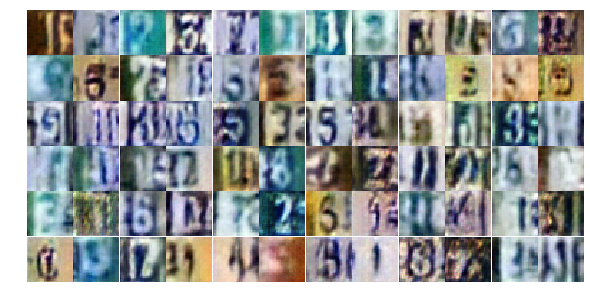

Epoch 8/25... Discriminator Loss: 0.4412... Generator Loss: 1.6597
Epoch 8/25... Discriminator Loss: 0.6635... Generator Loss: 1.0231
Epoch 8/25... Discriminator Loss: 0.6066... Generator Loss: 1.1774
Epoch 8/25... Discriminator Loss: 0.6410... Generator Loss: 1.0543
Epoch 8/25... Discriminator Loss: 0.4588... Generator Loss: 1.4535
Epoch 8/25... Discriminator Loss: 0.5918... Generator Loss: 1.1057
Epoch 8/25... Discriminator Loss: 0.6366... Generator Loss: 1.4060
Epoch 8/25... Discriminator Loss: 0.3050... Generator Loss: 1.7488
Epoch 8/25... Discriminator Loss: 0.7031... Generator Loss: 2.5421
Epoch 8/25... Discriminator Loss: 0.9506... Generator Loss: 0.8241


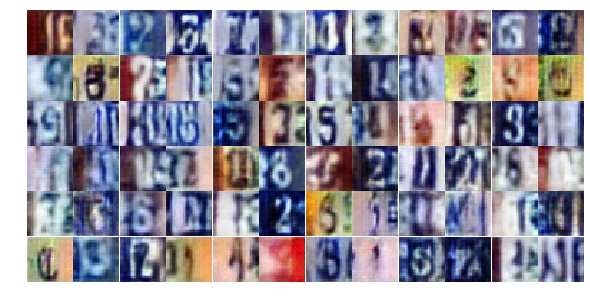

Epoch 8/25... Discriminator Loss: 0.6139... Generator Loss: 1.4425
Epoch 8/25... Discriminator Loss: 0.7885... Generator Loss: 0.8275
Epoch 8/25... Discriminator Loss: 0.5052... Generator Loss: 1.4436
Epoch 8/25... Discriminator Loss: 0.8729... Generator Loss: 0.7711
Epoch 8/25... Discriminator Loss: 0.6650... Generator Loss: 0.9753
Epoch 8/25... Discriminator Loss: 0.5294... Generator Loss: 1.1905
Epoch 8/25... Discriminator Loss: 0.6598... Generator Loss: 1.8552
Epoch 8/25... Discriminator Loss: 0.9024... Generator Loss: 0.6841
Epoch 8/25... Discriminator Loss: 0.7415... Generator Loss: 1.0687
Epoch 8/25... Discriminator Loss: 0.3870... Generator Loss: 1.4933


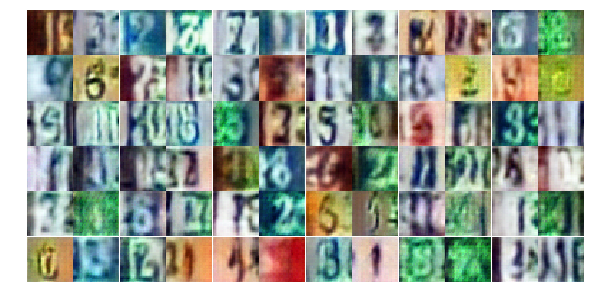

Epoch 8/25... Discriminator Loss: 0.4191... Generator Loss: 2.2183
Epoch 8/25... Discriminator Loss: 0.9744... Generator Loss: 0.6724
Epoch 8/25... Discriminator Loss: 0.5862... Generator Loss: 1.1032
Epoch 8/25... Discriminator Loss: 0.5474... Generator Loss: 1.2204
Epoch 8/25... Discriminator Loss: 0.6810... Generator Loss: 1.7256
Epoch 8/25... Discriminator Loss: 0.3937... Generator Loss: 1.6487
Epoch 8/25... Discriminator Loss: 0.3556... Generator Loss: 1.7931
Epoch 8/25... Discriminator Loss: 1.0335... Generator Loss: 0.6309
Epoch 8/25... Discriminator Loss: 1.0159... Generator Loss: 0.6250
Epoch 8/25... Discriminator Loss: 0.5487... Generator Loss: 1.4902


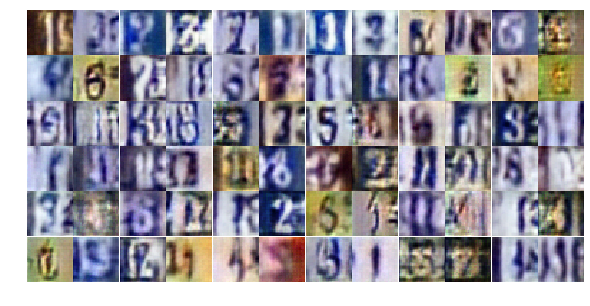

Epoch 8/25... Discriminator Loss: 0.4302... Generator Loss: 2.0147
Epoch 8/25... Discriminator Loss: 0.3938... Generator Loss: 1.7955
Epoch 8/25... Discriminator Loss: 0.5384... Generator Loss: 1.1180
Epoch 8/25... Discriminator Loss: 0.9363... Generator Loss: 0.6659
Epoch 8/25... Discriminator Loss: 0.5182... Generator Loss: 1.3833
Epoch 8/25... Discriminator Loss: 1.0078... Generator Loss: 0.6749
Epoch 8/25... Discriminator Loss: 0.3799... Generator Loss: 1.6158
Epoch 8/25... Discriminator Loss: 0.7897... Generator Loss: 2.7126
Epoch 9/25... Discriminator Loss: 0.9913... Generator Loss: 0.7021
Epoch 9/25... Discriminator Loss: 1.2427... Generator Loss: 0.4344


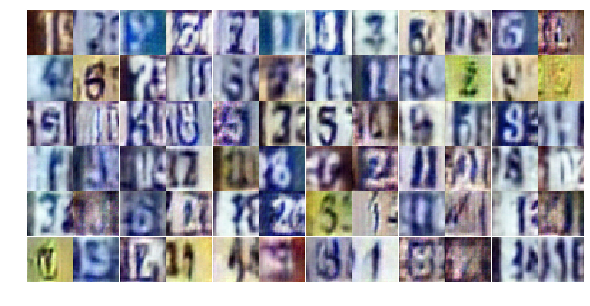

Epoch 9/25... Discriminator Loss: 0.5496... Generator Loss: 1.3452
Epoch 9/25... Discriminator Loss: 0.5633... Generator Loss: 1.7932
Epoch 9/25... Discriminator Loss: 0.9252... Generator Loss: 0.6629
Epoch 9/25... Discriminator Loss: 0.4514... Generator Loss: 1.5102
Epoch 9/25... Discriminator Loss: 1.2493... Generator Loss: 0.5375
Epoch 9/25... Discriminator Loss: 0.5564... Generator Loss: 1.5885
Epoch 9/25... Discriminator Loss: 0.7873... Generator Loss: 0.9668
Epoch 9/25... Discriminator Loss: 0.7100... Generator Loss: 0.8773
Epoch 9/25... Discriminator Loss: 0.6348... Generator Loss: 1.1732
Epoch 9/25... Discriminator Loss: 0.5908... Generator Loss: 1.6861


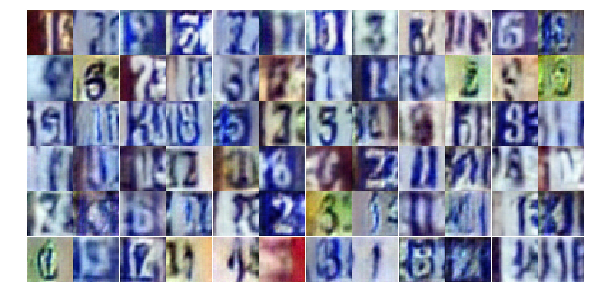

Epoch 9/25... Discriminator Loss: 0.8550... Generator Loss: 0.7499
Epoch 9/25... Discriminator Loss: 1.1638... Generator Loss: 0.4847
Epoch 9/25... Discriminator Loss: 0.7552... Generator Loss: 1.5194
Epoch 9/25... Discriminator Loss: 0.8360... Generator Loss: 0.7742
Epoch 9/25... Discriminator Loss: 0.4345... Generator Loss: 1.4877
Epoch 9/25... Discriminator Loss: 1.4035... Generator Loss: 0.3798
Epoch 9/25... Discriminator Loss: 1.1474... Generator Loss: 0.5078
Epoch 9/25... Discriminator Loss: 0.4714... Generator Loss: 1.3475
Epoch 9/25... Discriminator Loss: 1.0749... Generator Loss: 0.5468
Epoch 9/25... Discriminator Loss: 0.8419... Generator Loss: 0.7724


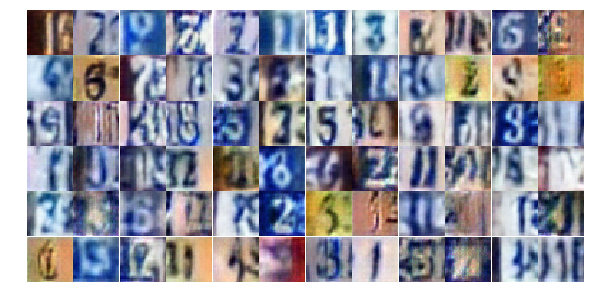

Epoch 9/25... Discriminator Loss: 1.0496... Generator Loss: 0.6524
Epoch 9/25... Discriminator Loss: 0.4649... Generator Loss: 1.6568
Epoch 9/25... Discriminator Loss: 0.5304... Generator Loss: 1.4312
Epoch 9/25... Discriminator Loss: 0.5913... Generator Loss: 1.1349
Epoch 9/25... Discriminator Loss: 0.4976... Generator Loss: 1.3011
Epoch 9/25... Discriminator Loss: 0.5658... Generator Loss: 1.2937
Epoch 9/25... Discriminator Loss: 1.5248... Generator Loss: 0.4701
Epoch 9/25... Discriminator Loss: 0.5695... Generator Loss: 2.4201
Epoch 9/25... Discriminator Loss: 0.6085... Generator Loss: 1.2738
Epoch 9/25... Discriminator Loss: 0.4299... Generator Loss: 1.3593


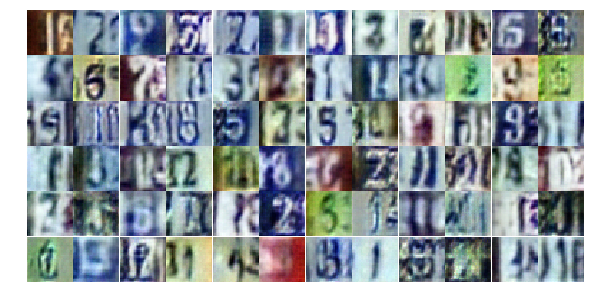

Epoch 9/25... Discriminator Loss: 0.4240... Generator Loss: 1.4748
Epoch 9/25... Discriminator Loss: 0.5783... Generator Loss: 1.2257
Epoch 9/25... Discriminator Loss: 1.1618... Generator Loss: 0.5113
Epoch 9/25... Discriminator Loss: 0.5007... Generator Loss: 1.3088
Epoch 9/25... Discriminator Loss: 0.7009... Generator Loss: 1.3958
Epoch 9/25... Discriminator Loss: 0.7083... Generator Loss: 1.0842
Epoch 9/25... Discriminator Loss: 0.5562... Generator Loss: 1.4262
Epoch 9/25... Discriminator Loss: 0.3650... Generator Loss: 1.7175
Epoch 9/25... Discriminator Loss: 0.5696... Generator Loss: 1.3691
Epoch 9/25... Discriminator Loss: 0.5967... Generator Loss: 1.0417


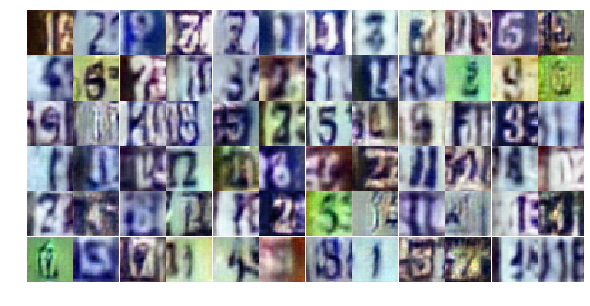

Epoch 9/25... Discriminator Loss: 0.5055... Generator Loss: 1.4737
Epoch 9/25... Discriminator Loss: 0.4998... Generator Loss: 1.2540
Epoch 9/25... Discriminator Loss: 0.7762... Generator Loss: 1.3120
Epoch 9/25... Discriminator Loss: 1.0833... Generator Loss: 0.6682
Epoch 9/25... Discriminator Loss: 0.4848... Generator Loss: 1.5400
Epoch 9/25... Discriminator Loss: 0.9369... Generator Loss: 0.7952
Epoch 9/25... Discriminator Loss: 0.5516... Generator Loss: 1.6182
Epoch 9/25... Discriminator Loss: 1.0351... Generator Loss: 0.5861
Epoch 9/25... Discriminator Loss: 0.4468... Generator Loss: 1.5354
Epoch 9/25... Discriminator Loss: 0.9154... Generator Loss: 3.0376


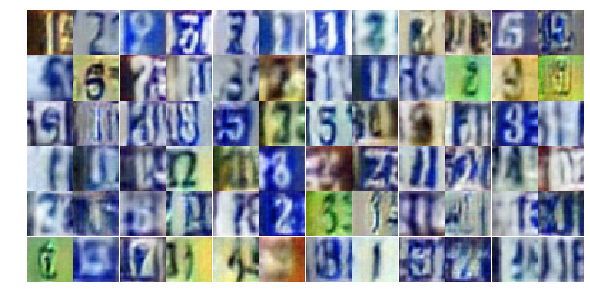

Epoch 9/25... Discriminator Loss: 0.6151... Generator Loss: 2.0461
Epoch 9/25... Discriminator Loss: 0.5651... Generator Loss: 1.8584
Epoch 9/25... Discriminator Loss: 0.7130... Generator Loss: 1.0818
Epoch 9/25... Discriminator Loss: 1.5614... Generator Loss: 0.3326
Epoch 9/25... Discriminator Loss: 0.4911... Generator Loss: 1.4224
Epoch 10/25... Discriminator Loss: 0.4553... Generator Loss: 1.7341
Epoch 10/25... Discriminator Loss: 0.4909... Generator Loss: 1.8606
Epoch 10/25... Discriminator Loss: 0.4837... Generator Loss: 1.4051
Epoch 10/25... Discriminator Loss: 0.6979... Generator Loss: 0.9776
Epoch 10/25... Discriminator Loss: 1.1137... Generator Loss: 0.4995


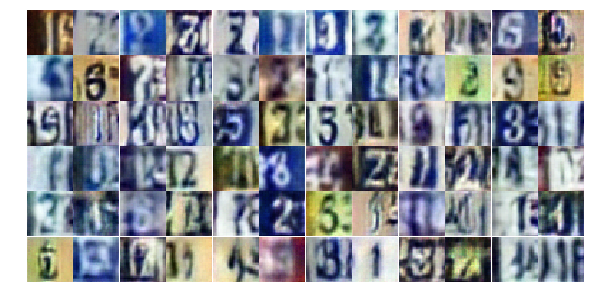

Epoch 10/25... Discriminator Loss: 0.6640... Generator Loss: 0.9528
Epoch 10/25... Discriminator Loss: 1.5685... Generator Loss: 4.8387
Epoch 10/25... Discriminator Loss: 1.8900... Generator Loss: 0.3014
Epoch 10/25... Discriminator Loss: 0.6506... Generator Loss: 1.4639
Epoch 10/25... Discriminator Loss: 0.6272... Generator Loss: 1.6509
Epoch 10/25... Discriminator Loss: 0.7329... Generator Loss: 0.9387
Epoch 10/25... Discriminator Loss: 0.4980... Generator Loss: 1.3625
Epoch 10/25... Discriminator Loss: 1.0164... Generator Loss: 0.6559
Epoch 10/25... Discriminator Loss: 0.9955... Generator Loss: 0.6712
Epoch 10/25... Discriminator Loss: 0.6310... Generator Loss: 1.2978


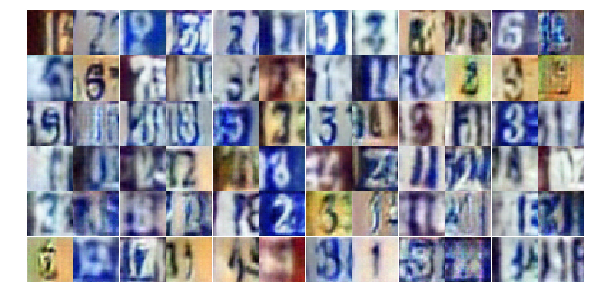

Epoch 10/25... Discriminator Loss: 0.6026... Generator Loss: 1.7541
Epoch 10/25... Discriminator Loss: 0.7758... Generator Loss: 0.8768
Epoch 10/25... Discriminator Loss: 0.7953... Generator Loss: 0.8750
Epoch 10/25... Discriminator Loss: 1.3777... Generator Loss: 0.3857
Epoch 10/25... Discriminator Loss: 0.5740... Generator Loss: 1.2952
Epoch 10/25... Discriminator Loss: 0.4610... Generator Loss: 1.5917
Epoch 10/25... Discriminator Loss: 0.8334... Generator Loss: 0.7826
Epoch 10/25... Discriminator Loss: 0.4897... Generator Loss: 1.4481
Epoch 10/25... Discriminator Loss: 0.5666... Generator Loss: 1.1368
Epoch 10/25... Discriminator Loss: 0.3830... Generator Loss: 2.1612


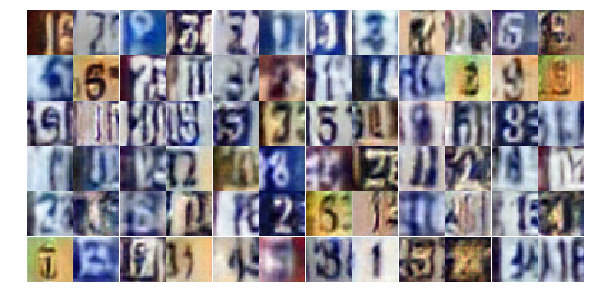

Epoch 10/25... Discriminator Loss: 0.6544... Generator Loss: 1.0231
Epoch 10/25... Discriminator Loss: 0.4952... Generator Loss: 1.5768
Epoch 10/25... Discriminator Loss: 0.3630... Generator Loss: 1.8862
Epoch 10/25... Discriminator Loss: 0.4605... Generator Loss: 2.5057
Epoch 10/25... Discriminator Loss: 1.1349... Generator Loss: 0.5350
Epoch 10/25... Discriminator Loss: 0.5576... Generator Loss: 1.5103
Epoch 10/25... Discriminator Loss: 0.4131... Generator Loss: 1.5225
Epoch 10/25... Discriminator Loss: 0.6487... Generator Loss: 1.1897
Epoch 10/25... Discriminator Loss: 0.6839... Generator Loss: 0.9694
Epoch 10/25... Discriminator Loss: 1.1563... Generator Loss: 2.5917


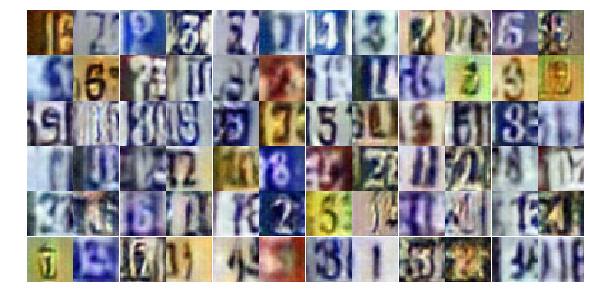

Epoch 10/25... Discriminator Loss: 0.7560... Generator Loss: 1.6318
Epoch 10/25... Discriminator Loss: 0.4638... Generator Loss: 1.6546
Epoch 10/25... Discriminator Loss: 0.4913... Generator Loss: 2.3851
Epoch 10/25... Discriminator Loss: 0.5530... Generator Loss: 1.4130
Epoch 10/25... Discriminator Loss: 0.6761... Generator Loss: 0.9861
Epoch 10/25... Discriminator Loss: 0.6713... Generator Loss: 1.1016
Epoch 10/25... Discriminator Loss: 0.4843... Generator Loss: 1.4013
Epoch 10/25... Discriminator Loss: 0.9773... Generator Loss: 0.7131
Epoch 10/25... Discriminator Loss: 0.4986... Generator Loss: 1.3203
Epoch 10/25... Discriminator Loss: 0.3605... Generator Loss: 1.9263


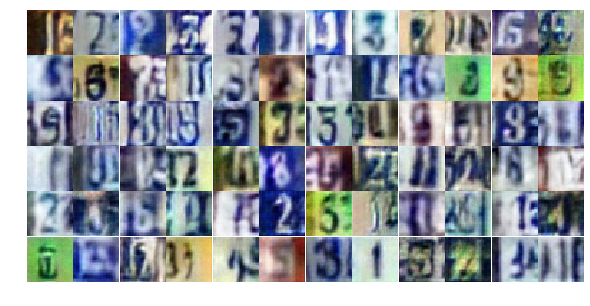

Epoch 10/25... Discriminator Loss: 0.8814... Generator Loss: 0.8304
Epoch 10/25... Discriminator Loss: 0.4624... Generator Loss: 1.6663
Epoch 10/25... Discriminator Loss: 0.9850... Generator Loss: 0.6192
Epoch 10/25... Discriminator Loss: 0.8503... Generator Loss: 0.8584
Epoch 10/25... Discriminator Loss: 0.5175... Generator Loss: 1.6598
Epoch 10/25... Discriminator Loss: 0.6407... Generator Loss: 1.2514
Epoch 10/25... Discriminator Loss: 0.5335... Generator Loss: 1.2504
Epoch 10/25... Discriminator Loss: 0.7862... Generator Loss: 3.0009
Epoch 10/25... Discriminator Loss: 0.7641... Generator Loss: 1.7661
Epoch 10/25... Discriminator Loss: 0.7875... Generator Loss: 0.9906


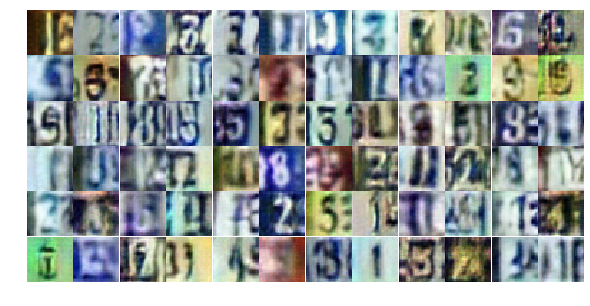

Epoch 10/25... Discriminator Loss: 0.7538... Generator Loss: 1.5640
Epoch 10/25... Discriminator Loss: 0.6022... Generator Loss: 1.1958
Epoch 10/25... Discriminator Loss: 0.4958... Generator Loss: 1.6638
Epoch 11/25... Discriminator Loss: 1.0631... Generator Loss: 0.5768
Epoch 11/25... Discriminator Loss: 0.7726... Generator Loss: 0.8382
Epoch 11/25... Discriminator Loss: 0.9758... Generator Loss: 0.7294
Epoch 11/25... Discriminator Loss: 0.6368... Generator Loss: 1.0198
Epoch 11/25... Discriminator Loss: 0.5494... Generator Loss: 2.5981
Epoch 11/25... Discriminator Loss: 1.0753... Generator Loss: 0.8782
Epoch 11/25... Discriminator Loss: 0.6233... Generator Loss: 1.1868


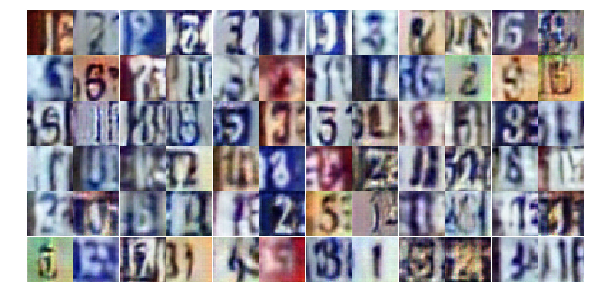

Epoch 11/25... Discriminator Loss: 0.4249... Generator Loss: 1.5055
Epoch 11/25... Discriminator Loss: 0.7316... Generator Loss: 0.8934
Epoch 11/25... Discriminator Loss: 0.4072... Generator Loss: 1.6004
Epoch 11/25... Discriminator Loss: 0.6947... Generator Loss: 0.9510
Epoch 11/25... Discriminator Loss: 0.6086... Generator Loss: 1.2194
Epoch 11/25... Discriminator Loss: 0.5456... Generator Loss: 1.1078
Epoch 11/25... Discriminator Loss: 0.7427... Generator Loss: 0.9449
Epoch 11/25... Discriminator Loss: 0.4007... Generator Loss: 1.8571
Epoch 11/25... Discriminator Loss: 0.6626... Generator Loss: 0.9903
Epoch 11/25... Discriminator Loss: 1.6206... Generator Loss: 0.3214


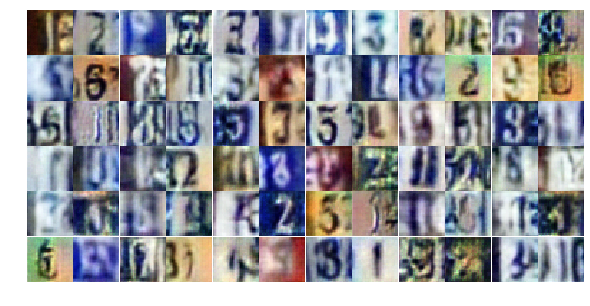

Epoch 11/25... Discriminator Loss: 0.9270... Generator Loss: 0.8584
Epoch 11/25... Discriminator Loss: 0.4672... Generator Loss: 2.2125
Epoch 11/25... Discriminator Loss: 1.0025... Generator Loss: 0.6146
Epoch 11/25... Discriminator Loss: 0.8327... Generator Loss: 0.8675
Epoch 11/25... Discriminator Loss: 0.4405... Generator Loss: 2.0651
Epoch 11/25... Discriminator Loss: 0.4432... Generator Loss: 1.6452
Epoch 11/25... Discriminator Loss: 0.4036... Generator Loss: 1.7363
Epoch 11/25... Discriminator Loss: 0.9120... Generator Loss: 0.7083
Epoch 11/25... Discriminator Loss: 0.3378... Generator Loss: 1.7978
Epoch 11/25... Discriminator Loss: 0.7482... Generator Loss: 0.9253


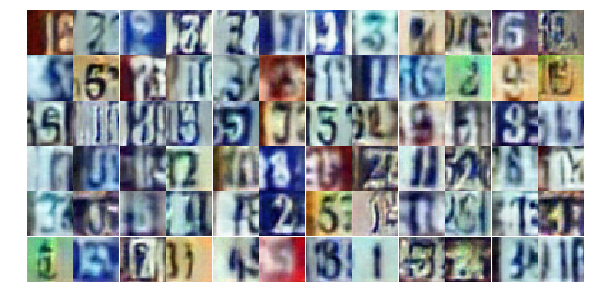

Epoch 11/25... Discriminator Loss: 1.1271... Generator Loss: 0.5189
Epoch 11/25... Discriminator Loss: 0.6119... Generator Loss: 1.1301
Epoch 11/25... Discriminator Loss: 0.6352... Generator Loss: 1.2155
Epoch 11/25... Discriminator Loss: 0.4109... Generator Loss: 1.5263
Epoch 11/25... Discriminator Loss: 0.5790... Generator Loss: 1.0965
Epoch 11/25... Discriminator Loss: 0.8495... Generator Loss: 0.7417
Epoch 11/25... Discriminator Loss: 1.0327... Generator Loss: 0.6155
Epoch 11/25... Discriminator Loss: 1.0253... Generator Loss: 0.6100
Epoch 11/25... Discriminator Loss: 0.4845... Generator Loss: 1.4054
Epoch 11/25... Discriminator Loss: 1.8767... Generator Loss: 0.2329


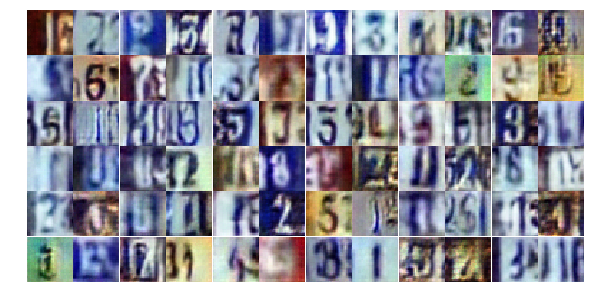

Epoch 11/25... Discriminator Loss: 0.7372... Generator Loss: 1.3078
Epoch 11/25... Discriminator Loss: 0.6062... Generator Loss: 1.3087
Epoch 11/25... Discriminator Loss: 1.2059... Generator Loss: 0.4778
Epoch 11/25... Discriminator Loss: 0.7332... Generator Loss: 1.1277
Epoch 11/25... Discriminator Loss: 0.7669... Generator Loss: 0.7830
Epoch 11/25... Discriminator Loss: 0.5846... Generator Loss: 1.1607
Epoch 11/25... Discriminator Loss: 0.3167... Generator Loss: 2.5567
Epoch 11/25... Discriminator Loss: 0.6474... Generator Loss: 1.1547
Epoch 11/25... Discriminator Loss: 1.4644... Generator Loss: 0.3777
Epoch 11/25... Discriminator Loss: 0.4741... Generator Loss: 1.4896


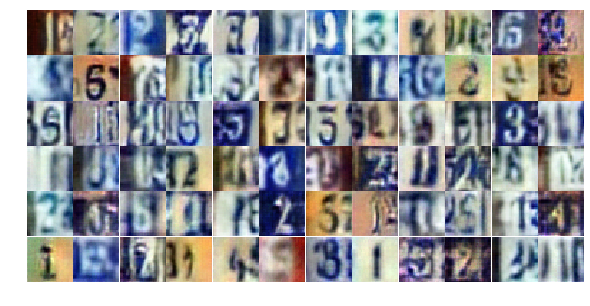

Epoch 11/25... Discriminator Loss: 0.6867... Generator Loss: 1.0186
Epoch 11/25... Discriminator Loss: 0.2851... Generator Loss: 1.9369
Epoch 11/25... Discriminator Loss: 0.7831... Generator Loss: 0.9340
Epoch 11/25... Discriminator Loss: 0.8147... Generator Loss: 0.8561
Epoch 11/25... Discriminator Loss: 1.1331... Generator Loss: 0.5927
Epoch 11/25... Discriminator Loss: 0.9715... Generator Loss: 0.7061
Epoch 11/25... Discriminator Loss: 0.8530... Generator Loss: 0.7946
Epoch 11/25... Discriminator Loss: 0.5048... Generator Loss: 1.8653
Epoch 11/25... Discriminator Loss: 0.7345... Generator Loss: 1.1176
Epoch 11/25... Discriminator Loss: 0.7793... Generator Loss: 0.9108


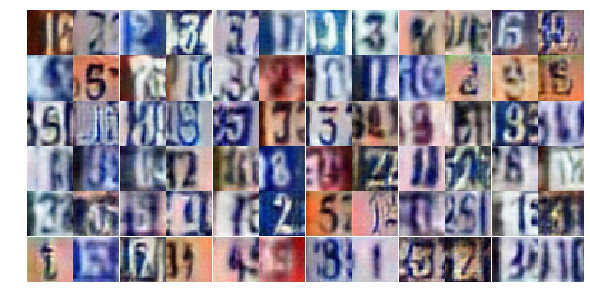

Epoch 12/25... Discriminator Loss: 0.6374... Generator Loss: 1.5424
Epoch 12/25... Discriminator Loss: 0.6689... Generator Loss: 1.1134
Epoch 12/25... Discriminator Loss: 0.6426... Generator Loss: 1.0242
Epoch 12/25... Discriminator Loss: 0.4851... Generator Loss: 1.4925
Epoch 12/25... Discriminator Loss: 0.4063... Generator Loss: 1.8256
Epoch 12/25... Discriminator Loss: 0.6448... Generator Loss: 1.2792
Epoch 12/25... Discriminator Loss: 0.5726... Generator Loss: 2.2911
Epoch 12/25... Discriminator Loss: 0.5372... Generator Loss: 1.5128
Epoch 12/25... Discriminator Loss: 0.7376... Generator Loss: 0.8823
Epoch 12/25... Discriminator Loss: 0.9194... Generator Loss: 0.7215


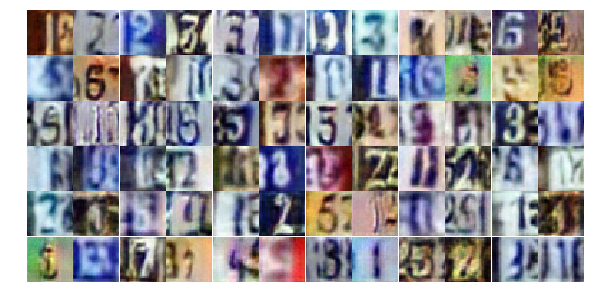

Epoch 12/25... Discriminator Loss: 0.4463... Generator Loss: 1.4984
Epoch 12/25... Discriminator Loss: 0.8938... Generator Loss: 0.7175
Epoch 12/25... Discriminator Loss: 0.4642... Generator Loss: 1.7002
Epoch 12/25... Discriminator Loss: 0.5807... Generator Loss: 1.7291
Epoch 12/25... Discriminator Loss: 0.4313... Generator Loss: 1.5285
Epoch 12/25... Discriminator Loss: 0.6099... Generator Loss: 1.6113
Epoch 12/25... Discriminator Loss: 1.6670... Generator Loss: 0.2844
Epoch 12/25... Discriminator Loss: 0.5544... Generator Loss: 1.6842
Epoch 12/25... Discriminator Loss: 0.5506... Generator Loss: 1.2896
Epoch 12/25... Discriminator Loss: 0.7061... Generator Loss: 0.9615


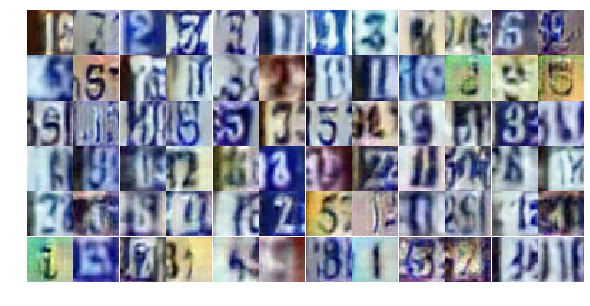

Epoch 12/25... Discriminator Loss: 0.3522... Generator Loss: 1.6539
Epoch 12/25... Discriminator Loss: 0.4231... Generator Loss: 1.6005
Epoch 12/25... Discriminator Loss: 0.5707... Generator Loss: 1.2899
Epoch 12/25... Discriminator Loss: 0.4113... Generator Loss: 1.6264
Epoch 12/25... Discriminator Loss: 0.4159... Generator Loss: 1.5014
Epoch 12/25... Discriminator Loss: 0.5481... Generator Loss: 1.3414
Epoch 12/25... Discriminator Loss: 0.5872... Generator Loss: 1.1018
Epoch 12/25... Discriminator Loss: 0.4368... Generator Loss: 1.8670
Epoch 12/25... Discriminator Loss: 0.6163... Generator Loss: 1.2273
Epoch 12/25... Discriminator Loss: 0.5157... Generator Loss: 1.5352


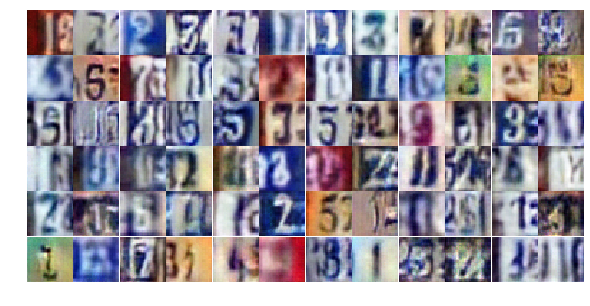

Epoch 12/25... Discriminator Loss: 0.5614... Generator Loss: 1.2849
Epoch 12/25... Discriminator Loss: 0.8511... Generator Loss: 0.8402
Epoch 12/25... Discriminator Loss: 0.8932... Generator Loss: 0.7219
Epoch 12/25... Discriminator Loss: 1.5617... Generator Loss: 0.3494
Epoch 12/25... Discriminator Loss: 0.5926... Generator Loss: 1.7738
Epoch 12/25... Discriminator Loss: 0.8646... Generator Loss: 0.8115
Epoch 12/25... Discriminator Loss: 0.8000... Generator Loss: 0.8124
Epoch 12/25... Discriminator Loss: 0.8364... Generator Loss: 0.8353
Epoch 12/25... Discriminator Loss: 0.4961... Generator Loss: 1.8173
Epoch 12/25... Discriminator Loss: 0.3967... Generator Loss: 2.0794


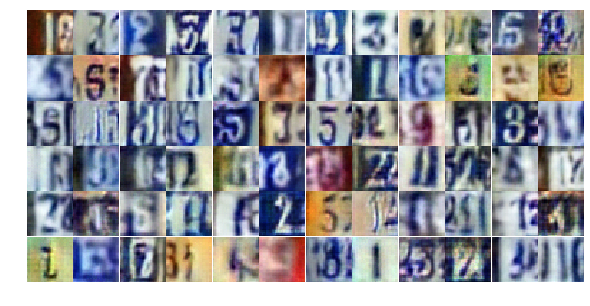

Epoch 12/25... Discriminator Loss: 0.5104... Generator Loss: 1.2898
Epoch 12/25... Discriminator Loss: 0.3986... Generator Loss: 1.4865
Epoch 12/25... Discriminator Loss: 0.4323... Generator Loss: 1.4574
Epoch 12/25... Discriminator Loss: 1.1788... Generator Loss: 0.5710
Epoch 12/25... Discriminator Loss: 0.7657... Generator Loss: 0.9399
Epoch 12/25... Discriminator Loss: 1.4373... Generator Loss: 0.4072
Epoch 12/25... Discriminator Loss: 0.6656... Generator Loss: 1.0451
Epoch 12/25... Discriminator Loss: 0.8504... Generator Loss: 0.8061
Epoch 12/25... Discriminator Loss: 0.6736... Generator Loss: 0.9801
Epoch 12/25... Discriminator Loss: 0.9594... Generator Loss: 0.6828


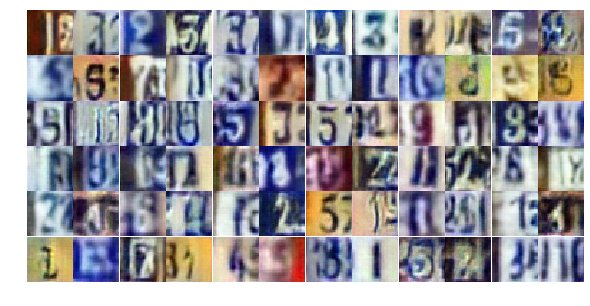

Epoch 12/25... Discriminator Loss: 1.0593... Generator Loss: 0.5837
Epoch 12/25... Discriminator Loss: 0.8191... Generator Loss: 0.8810
Epoch 12/25... Discriminator Loss: 0.5495... Generator Loss: 2.2070
Epoch 12/25... Discriminator Loss: 1.7232... Generator Loss: 0.2952
Epoch 12/25... Discriminator Loss: 0.6649... Generator Loss: 0.9823
Epoch 12/25... Discriminator Loss: 0.7583... Generator Loss: 1.6281
Epoch 12/25... Discriminator Loss: 0.9640... Generator Loss: 0.7265
Epoch 13/25... Discriminator Loss: 0.5483... Generator Loss: 1.1913
Epoch 13/25... Discriminator Loss: 0.4821... Generator Loss: 1.3998
Epoch 13/25... Discriminator Loss: 0.8579... Generator Loss: 0.8135


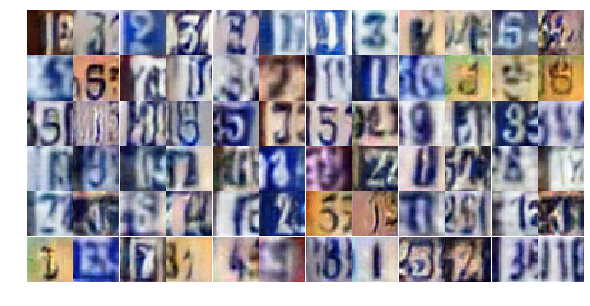

Epoch 13/25... Discriminator Loss: 0.6405... Generator Loss: 2.2828
Epoch 13/25... Discriminator Loss: 0.7521... Generator Loss: 1.9936
Epoch 13/25... Discriminator Loss: 1.3715... Generator Loss: 0.3857
Epoch 13/25... Discriminator Loss: 1.2519... Generator Loss: 0.5261
Epoch 13/25... Discriminator Loss: 0.6850... Generator Loss: 0.9797
Epoch 13/25... Discriminator Loss: 0.4395... Generator Loss: 1.6005
Epoch 13/25... Discriminator Loss: 0.2917... Generator Loss: 2.0178
Epoch 13/25... Discriminator Loss: 0.6166... Generator Loss: 1.0198
Epoch 13/25... Discriminator Loss: 0.6710... Generator Loss: 0.9850
Epoch 13/25... Discriminator Loss: 0.5138... Generator Loss: 1.2723


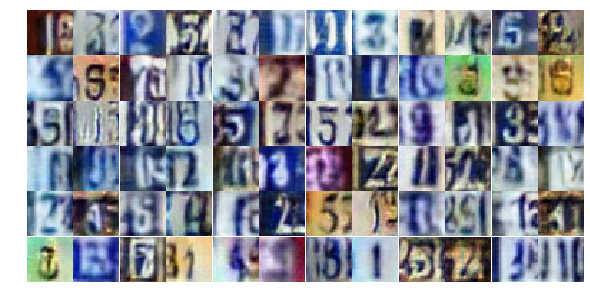

Epoch 13/25... Discriminator Loss: 0.8320... Generator Loss: 1.1873
Epoch 13/25... Discriminator Loss: 0.6568... Generator Loss: 0.9789
Epoch 13/25... Discriminator Loss: 1.0228... Generator Loss: 0.6367
Epoch 13/25... Discriminator Loss: 0.3892... Generator Loss: 1.6974
Epoch 13/25... Discriminator Loss: 0.5251... Generator Loss: 1.5154
Epoch 13/25... Discriminator Loss: 1.2054... Generator Loss: 0.6693
Epoch 13/25... Discriminator Loss: 0.5895... Generator Loss: 1.2648
Epoch 13/25... Discriminator Loss: 0.8765... Generator Loss: 0.8125
Epoch 13/25... Discriminator Loss: 0.4661... Generator Loss: 1.8858
Epoch 13/25... Discriminator Loss: 0.8077... Generator Loss: 0.8119


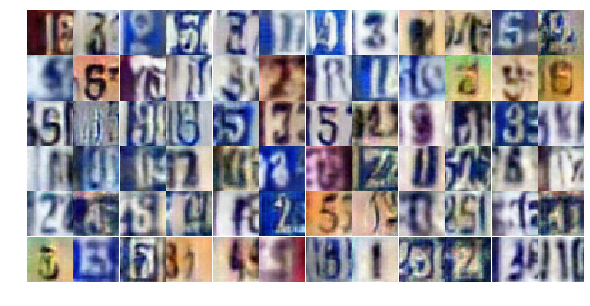

Epoch 13/25... Discriminator Loss: 0.6546... Generator Loss: 1.0236
Epoch 13/25... Discriminator Loss: 0.8541... Generator Loss: 0.7771
Epoch 13/25... Discriminator Loss: 0.5184... Generator Loss: 1.9803
Epoch 13/25... Discriminator Loss: 0.5499... Generator Loss: 1.2476
Epoch 13/25... Discriminator Loss: 0.6538... Generator Loss: 1.0607
Epoch 13/25... Discriminator Loss: 1.5282... Generator Loss: 0.3386
Epoch 13/25... Discriminator Loss: 0.7845... Generator Loss: 0.9850
Epoch 13/25... Discriminator Loss: 0.4391... Generator Loss: 1.5744
Epoch 13/25... Discriminator Loss: 0.4836... Generator Loss: 1.3964
Epoch 13/25... Discriminator Loss: 0.5289... Generator Loss: 1.2867


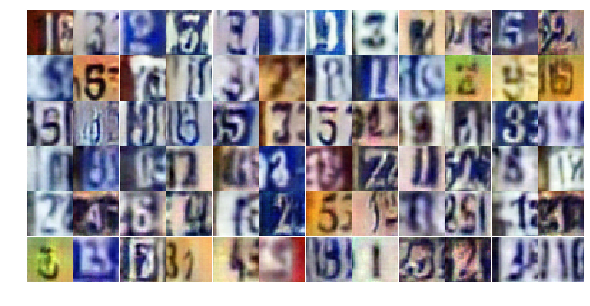

Epoch 13/25... Discriminator Loss: 0.8568... Generator Loss: 0.7953
Epoch 13/25... Discriminator Loss: 0.8682... Generator Loss: 2.0696
Epoch 13/25... Discriminator Loss: 0.9086... Generator Loss: 0.7312
Epoch 13/25... Discriminator Loss: 1.0456... Generator Loss: 0.6232
Epoch 13/25... Discriminator Loss: 0.5616... Generator Loss: 1.2130
Epoch 13/25... Discriminator Loss: 0.4293... Generator Loss: 1.5164
Epoch 13/25... Discriminator Loss: 0.6236... Generator Loss: 1.1052
Epoch 13/25... Discriminator Loss: 0.7829... Generator Loss: 0.9579
Epoch 13/25... Discriminator Loss: 0.9164... Generator Loss: 0.7051
Epoch 13/25... Discriminator Loss: 0.6929... Generator Loss: 0.9455


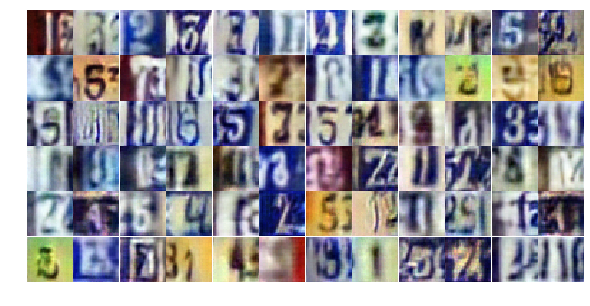

Epoch 13/25... Discriminator Loss: 0.5228... Generator Loss: 1.3473
Epoch 13/25... Discriminator Loss: 1.6478... Generator Loss: 0.7373
Epoch 13/25... Discriminator Loss: 0.8049... Generator Loss: 1.0864
Epoch 13/25... Discriminator Loss: 0.7966... Generator Loss: 0.8438
Epoch 13/25... Discriminator Loss: 0.9871... Generator Loss: 0.6691
Epoch 13/25... Discriminator Loss: 0.4971... Generator Loss: 1.7345
Epoch 13/25... Discriminator Loss: 0.9974... Generator Loss: 0.6858
Epoch 13/25... Discriminator Loss: 0.7524... Generator Loss: 0.8635
Epoch 13/25... Discriminator Loss: 0.7471... Generator Loss: 0.9346
Epoch 13/25... Discriminator Loss: 0.7037... Generator Loss: 0.8824


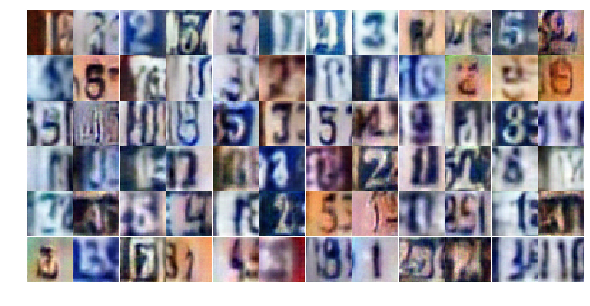

Epoch 13/25... Discriminator Loss: 0.2664... Generator Loss: 2.4322
Epoch 13/25... Discriminator Loss: 1.2936... Generator Loss: 0.4616
Epoch 13/25... Discriminator Loss: 0.6121... Generator Loss: 1.1631
Epoch 13/25... Discriminator Loss: 0.8849... Generator Loss: 0.6774
Epoch 14/25... Discriminator Loss: 1.3277... Generator Loss: 0.4304
Epoch 14/25... Discriminator Loss: 0.4957... Generator Loss: 1.4260
Epoch 14/25... Discriminator Loss: 0.9669... Generator Loss: 0.7270
Epoch 14/25... Discriminator Loss: 0.4835... Generator Loss: 1.3841
Epoch 14/25... Discriminator Loss: 0.5181... Generator Loss: 1.4600
Epoch 14/25... Discriminator Loss: 1.4221... Generator Loss: 0.4589


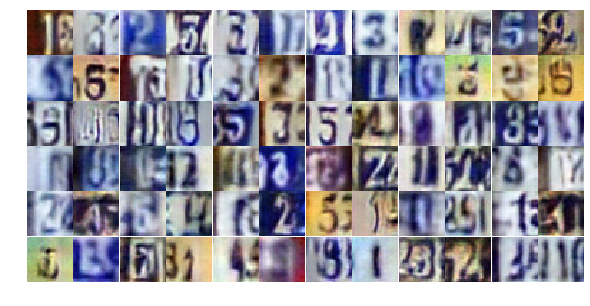

Epoch 14/25... Discriminator Loss: 1.1645... Generator Loss: 2.6603
Epoch 14/25... Discriminator Loss: 1.1434... Generator Loss: 0.5466
Epoch 14/25... Discriminator Loss: 0.5899... Generator Loss: 1.1914
Epoch 14/25... Discriminator Loss: 0.8723... Generator Loss: 0.7839
Epoch 14/25... Discriminator Loss: 0.9674... Generator Loss: 0.7905
Epoch 14/25... Discriminator Loss: 0.2605... Generator Loss: 1.8979
Epoch 14/25... Discriminator Loss: 0.4327... Generator Loss: 3.1040
Epoch 14/25... Discriminator Loss: 1.6732... Generator Loss: 0.2819
Epoch 14/25... Discriminator Loss: 1.3994... Generator Loss: 0.3821
Epoch 14/25... Discriminator Loss: 1.3218... Generator Loss: 0.4638


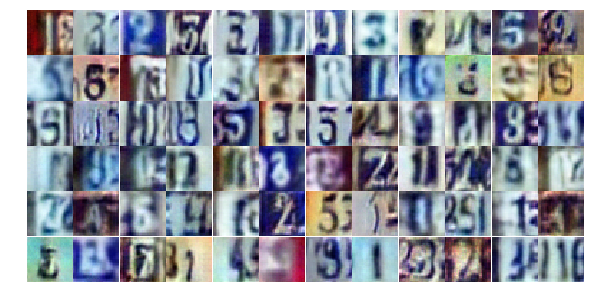

Epoch 14/25... Discriminator Loss: 0.4824... Generator Loss: 1.3487
Epoch 14/25... Discriminator Loss: 0.5836... Generator Loss: 1.2325
Epoch 14/25... Discriminator Loss: 1.1055... Generator Loss: 0.5963
Epoch 14/25... Discriminator Loss: 0.3871... Generator Loss: 1.7180
Epoch 14/25... Discriminator Loss: 0.7117... Generator Loss: 1.1008
Epoch 14/25... Discriminator Loss: 0.7030... Generator Loss: 0.9796
Epoch 14/25... Discriminator Loss: 0.6202... Generator Loss: 1.1337
Epoch 14/25... Discriminator Loss: 0.7037... Generator Loss: 0.9403
Epoch 14/25... Discriminator Loss: 0.5136... Generator Loss: 1.2371
Epoch 14/25... Discriminator Loss: 0.3290... Generator Loss: 1.9697


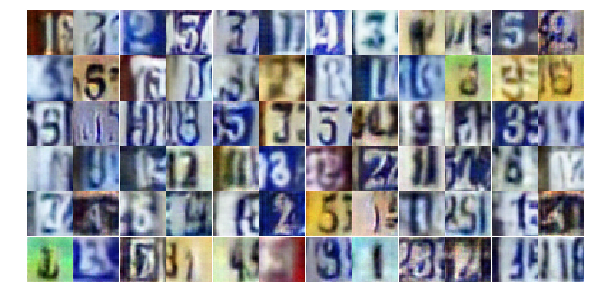

Epoch 14/25... Discriminator Loss: 1.8858... Generator Loss: 0.2642
Epoch 14/25... Discriminator Loss: 0.4337... Generator Loss: 1.3404
Epoch 14/25... Discriminator Loss: 0.5435... Generator Loss: 1.2237
Epoch 14/25... Discriminator Loss: 0.5832... Generator Loss: 1.1554
Epoch 14/25... Discriminator Loss: 0.7329... Generator Loss: 0.9206
Epoch 14/25... Discriminator Loss: 0.5861... Generator Loss: 1.2327
Epoch 14/25... Discriminator Loss: 0.8438... Generator Loss: 0.8416
Epoch 14/25... Discriminator Loss: 0.3525... Generator Loss: 1.8174
Epoch 14/25... Discriminator Loss: 0.4410... Generator Loss: 2.6400
Epoch 14/25... Discriminator Loss: 0.7884... Generator Loss: 0.8882


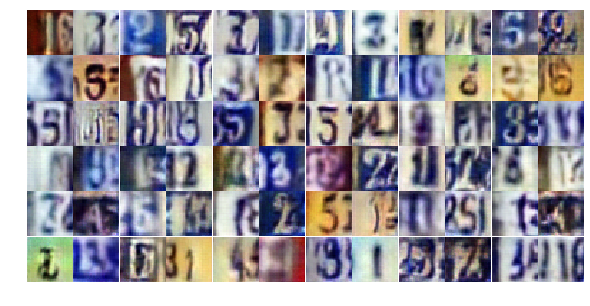

Epoch 14/25... Discriminator Loss: 0.9103... Generator Loss: 0.6907
Epoch 14/25... Discriminator Loss: 0.7277... Generator Loss: 1.1355
Epoch 14/25... Discriminator Loss: 0.8605... Generator Loss: 0.7306
Epoch 14/25... Discriminator Loss: 1.1589... Generator Loss: 0.5624
Epoch 14/25... Discriminator Loss: 1.2002... Generator Loss: 0.4818
Epoch 14/25... Discriminator Loss: 0.6204... Generator Loss: 1.1359
Epoch 14/25... Discriminator Loss: 0.5266... Generator Loss: 1.2717
Epoch 14/25... Discriminator Loss: 0.4619... Generator Loss: 1.3533
Epoch 14/25... Discriminator Loss: 1.7260... Generator Loss: 0.3803
Epoch 14/25... Discriminator Loss: 0.9931... Generator Loss: 0.6398


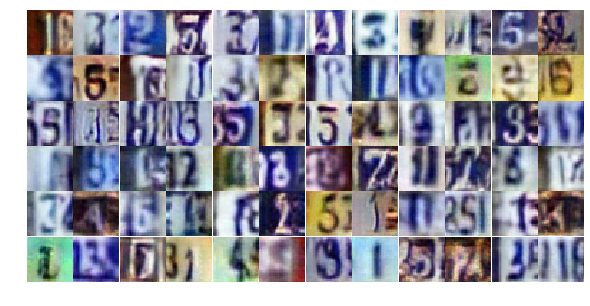

Epoch 14/25... Discriminator Loss: 0.8182... Generator Loss: 2.0900
Epoch 14/25... Discriminator Loss: 1.3043... Generator Loss: 0.4279
Epoch 14/25... Discriminator Loss: 0.6209... Generator Loss: 1.0680
Epoch 14/25... Discriminator Loss: 1.8134... Generator Loss: 0.2475
Epoch 14/25... Discriminator Loss: 1.0476... Generator Loss: 0.6526
Epoch 14/25... Discriminator Loss: 0.8836... Generator Loss: 0.7850
Epoch 14/25... Discriminator Loss: 0.4290... Generator Loss: 1.8473
Epoch 14/25... Discriminator Loss: 0.6938... Generator Loss: 1.0256
Epoch 14/25... Discriminator Loss: 0.6995... Generator Loss: 1.4395
Epoch 14/25... Discriminator Loss: 1.0769... Generator Loss: 0.6015


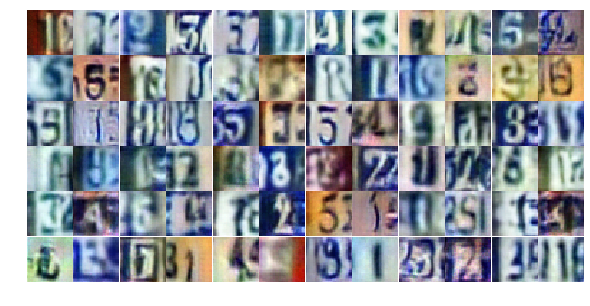

Epoch 14/25... Discriminator Loss: 0.7164... Generator Loss: 1.0118
Epoch 14/25... Discriminator Loss: 1.3609... Generator Loss: 0.4516
Epoch 15/25... Discriminator Loss: 0.7132... Generator Loss: 1.0905
Epoch 15/25... Discriminator Loss: 0.5089... Generator Loss: 1.6479
Epoch 15/25... Discriminator Loss: 0.4300... Generator Loss: 1.6022
Epoch 15/25... Discriminator Loss: 0.9730... Generator Loss: 0.6921
Epoch 15/25... Discriminator Loss: 1.3738... Generator Loss: 0.4295
Epoch 15/25... Discriminator Loss: 0.6197... Generator Loss: 1.3497
Epoch 15/25... Discriminator Loss: 1.2013... Generator Loss: 0.5491
Epoch 15/25... Discriminator Loss: 0.7195... Generator Loss: 0.9940


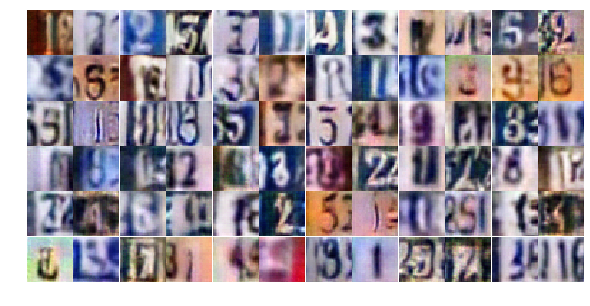

Epoch 15/25... Discriminator Loss: 0.7643... Generator Loss: 0.9200
Epoch 15/25... Discriminator Loss: 0.6019... Generator Loss: 1.3869
Epoch 15/25... Discriminator Loss: 1.2098... Generator Loss: 0.5352
Epoch 15/25... Discriminator Loss: 0.5925... Generator Loss: 1.0761
Epoch 15/25... Discriminator Loss: 0.8837... Generator Loss: 0.7865
Epoch 15/25... Discriminator Loss: 0.5343... Generator Loss: 1.2762
Epoch 15/25... Discriminator Loss: 1.3117... Generator Loss: 0.4451
Epoch 15/25... Discriminator Loss: 0.6291... Generator Loss: 1.2165
Epoch 15/25... Discriminator Loss: 0.8273... Generator Loss: 3.4941
Epoch 15/25... Discriminator Loss: 1.3190... Generator Loss: 0.4677


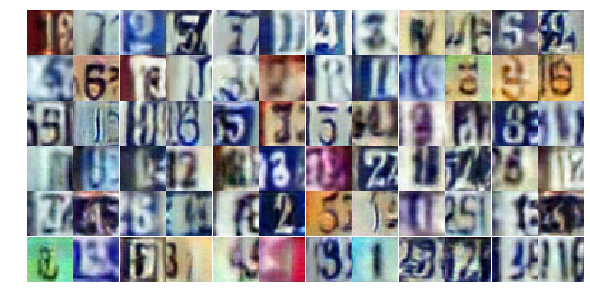

Epoch 15/25... Discriminator Loss: 1.0123... Generator Loss: 0.7326
Epoch 15/25... Discriminator Loss: 0.7669... Generator Loss: 0.8920
Epoch 15/25... Discriminator Loss: 0.4766... Generator Loss: 1.5057
Epoch 15/25... Discriminator Loss: 0.7207... Generator Loss: 1.1479
Epoch 15/25... Discriminator Loss: 1.0507... Generator Loss: 0.6644
Epoch 15/25... Discriminator Loss: 0.3688... Generator Loss: 1.7146
Epoch 15/25... Discriminator Loss: 1.1959... Generator Loss: 0.5309
Epoch 15/25... Discriminator Loss: 0.5756... Generator Loss: 1.2784
Epoch 15/25... Discriminator Loss: 0.7005... Generator Loss: 1.0998
Epoch 15/25... Discriminator Loss: 1.3567... Generator Loss: 0.4167


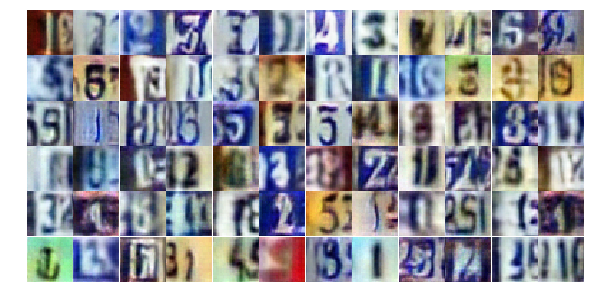

Epoch 15/25... Discriminator Loss: 0.7014... Generator Loss: 0.9733
Epoch 15/25... Discriminator Loss: 0.7078... Generator Loss: 1.0773
Epoch 15/25... Discriminator Loss: 0.4478... Generator Loss: 1.4413
Epoch 15/25... Discriminator Loss: 0.7041... Generator Loss: 1.4832
Epoch 15/25... Discriminator Loss: 0.5398... Generator Loss: 1.5611
Epoch 15/25... Discriminator Loss: 1.2352... Generator Loss: 3.1865
Epoch 15/25... Discriminator Loss: 0.6407... Generator Loss: 1.3440
Epoch 15/25... Discriminator Loss: 0.6450... Generator Loss: 0.9840
Epoch 15/25... Discriminator Loss: 0.6585... Generator Loss: 1.2744
Epoch 15/25... Discriminator Loss: 0.6358... Generator Loss: 1.1756


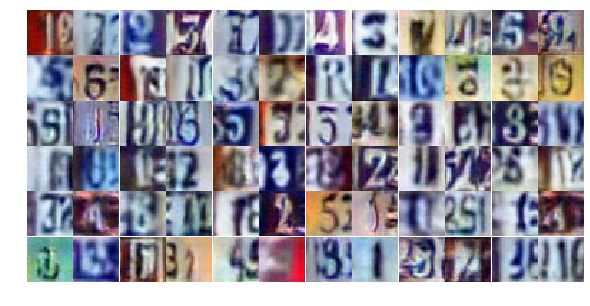

Epoch 15/25... Discriminator Loss: 0.6375... Generator Loss: 1.1392
Epoch 15/25... Discriminator Loss: 1.2276... Generator Loss: 0.5163
Epoch 15/25... Discriminator Loss: 0.8412... Generator Loss: 0.8512
Epoch 15/25... Discriminator Loss: 0.6396... Generator Loss: 1.0284
Epoch 15/25... Discriminator Loss: 0.4456... Generator Loss: 1.3602
Epoch 15/25... Discriminator Loss: 1.6513... Generator Loss: 3.5491
Epoch 15/25... Discriminator Loss: 0.7630... Generator Loss: 0.8271
Epoch 15/25... Discriminator Loss: 0.8260... Generator Loss: 1.0138
Epoch 15/25... Discriminator Loss: 0.9006... Generator Loss: 0.7673
Epoch 15/25... Discriminator Loss: 0.7866... Generator Loss: 0.9208


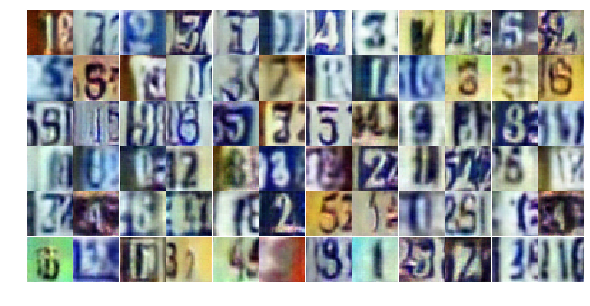

Epoch 15/25... Discriminator Loss: 0.9316... Generator Loss: 0.7193
Epoch 15/25... Discriminator Loss: 1.1504... Generator Loss: 0.5351
Epoch 15/25... Discriminator Loss: 0.6315... Generator Loss: 1.0320
Epoch 15/25... Discriminator Loss: 0.6729... Generator Loss: 1.0712
Epoch 15/25... Discriminator Loss: 0.8921... Generator Loss: 0.7134
Epoch 15/25... Discriminator Loss: 1.1646... Generator Loss: 2.8430
Epoch 15/25... Discriminator Loss: 0.9045... Generator Loss: 0.7943
Epoch 15/25... Discriminator Loss: 0.5983... Generator Loss: 1.2574
Epoch 15/25... Discriminator Loss: 1.4427... Generator Loss: 0.3964
Epoch 16/25... Discriminator Loss: 1.2789... Generator Loss: 0.4477


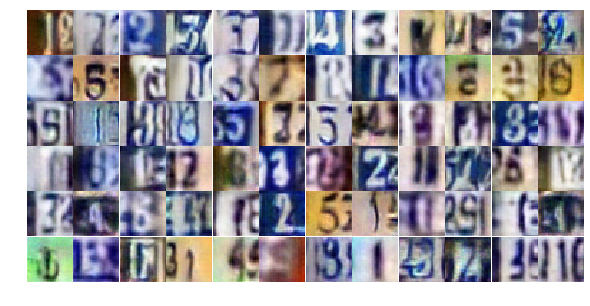

Epoch 16/25... Discriminator Loss: 0.6924... Generator Loss: 1.0291
Epoch 16/25... Discriminator Loss: 0.8735... Generator Loss: 0.7878
Epoch 16/25... Discriminator Loss: 0.8856... Generator Loss: 0.7842
Epoch 16/25... Discriminator Loss: 0.7288... Generator Loss: 1.0998
Epoch 16/25... Discriminator Loss: 0.7013... Generator Loss: 2.7508
Epoch 16/25... Discriminator Loss: 0.5869... Generator Loss: 1.9145
Epoch 16/25... Discriminator Loss: 1.1877... Generator Loss: 1.7373
Epoch 16/25... Discriminator Loss: 0.9986... Generator Loss: 0.6410
Epoch 16/25... Discriminator Loss: 0.4362... Generator Loss: 1.5811
Epoch 16/25... Discriminator Loss: 0.4388... Generator Loss: 1.4883


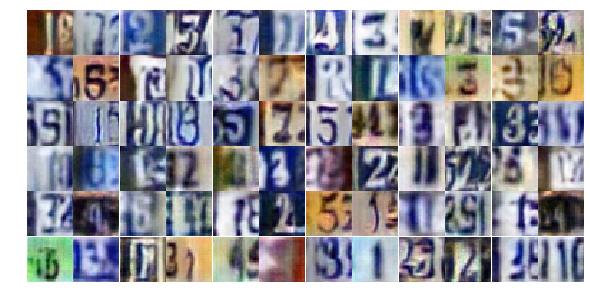

Epoch 16/25... Discriminator Loss: 1.1935... Generator Loss: 0.5451
Epoch 16/25... Discriminator Loss: 0.7245... Generator Loss: 1.0873
Epoch 16/25... Discriminator Loss: 0.8373... Generator Loss: 0.8454
Epoch 16/25... Discriminator Loss: 0.8996... Generator Loss: 0.7161
Epoch 16/25... Discriminator Loss: 0.4842... Generator Loss: 1.3938
Epoch 16/25... Discriminator Loss: 0.7487... Generator Loss: 0.8556
Epoch 16/25... Discriminator Loss: 1.2386... Generator Loss: 0.4956
Epoch 16/25... Discriminator Loss: 0.4826... Generator Loss: 1.6835
Epoch 16/25... Discriminator Loss: 0.4794... Generator Loss: 1.3274
Epoch 16/25... Discriminator Loss: 0.7886... Generator Loss: 0.8716


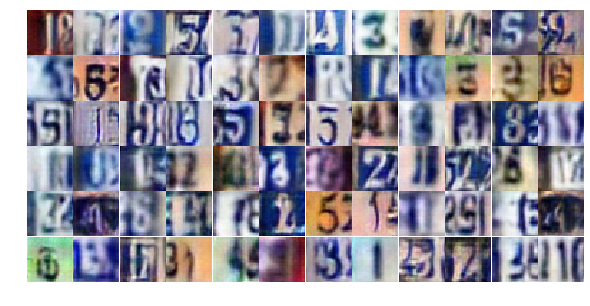

Epoch 16/25... Discriminator Loss: 1.0239... Generator Loss: 0.5950
Epoch 16/25... Discriminator Loss: 0.6830... Generator Loss: 1.2632
Epoch 16/25... Discriminator Loss: 0.5536... Generator Loss: 1.2487
Epoch 16/25... Discriminator Loss: 1.6694... Generator Loss: 0.2908
Epoch 16/25... Discriminator Loss: 0.9235... Generator Loss: 0.7886
Epoch 16/25... Discriminator Loss: 0.9541... Generator Loss: 0.7501
Epoch 16/25... Discriminator Loss: 0.7956... Generator Loss: 0.8637
Epoch 16/25... Discriminator Loss: 1.9697... Generator Loss: 4.9850
Epoch 16/25... Discriminator Loss: 0.6315... Generator Loss: 1.5338
Epoch 16/25... Discriminator Loss: 0.8279... Generator Loss: 0.8361


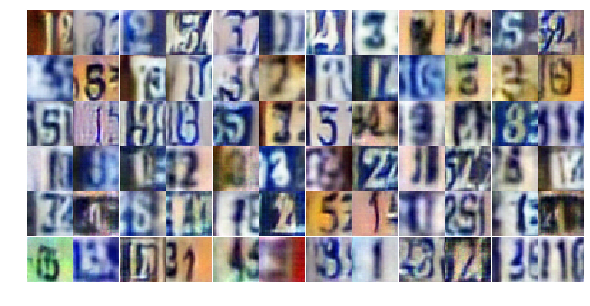

Epoch 16/25... Discriminator Loss: 0.6351... Generator Loss: 1.0759
Epoch 16/25... Discriminator Loss: 0.5184... Generator Loss: 1.2612
Epoch 16/25... Discriminator Loss: 0.6088... Generator Loss: 1.0810
Epoch 16/25... Discriminator Loss: 0.5858... Generator Loss: 1.4779
Epoch 16/25... Discriminator Loss: 0.7678... Generator Loss: 1.1313
Epoch 16/25... Discriminator Loss: 0.6385... Generator Loss: 1.2370
Epoch 16/25... Discriminator Loss: 0.8510... Generator Loss: 0.7891
Epoch 16/25... Discriminator Loss: 1.0385... Generator Loss: 0.5891
Epoch 16/25... Discriminator Loss: 0.6839... Generator Loss: 1.0168
Epoch 16/25... Discriminator Loss: 0.3602... Generator Loss: 1.7845


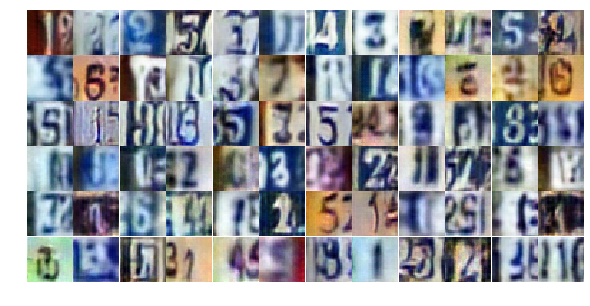

Epoch 16/25... Discriminator Loss: 0.4415... Generator Loss: 1.5424
Epoch 16/25... Discriminator Loss: 0.4821... Generator Loss: 1.9554
Epoch 16/25... Discriminator Loss: 0.9987... Generator Loss: 0.7030
Epoch 16/25... Discriminator Loss: 1.4975... Generator Loss: 0.7835
Epoch 16/25... Discriminator Loss: 0.7715... Generator Loss: 1.5375
Epoch 16/25... Discriminator Loss: 1.1929... Generator Loss: 0.5784
Epoch 16/25... Discriminator Loss: 0.5304... Generator Loss: 1.3491
Epoch 16/25... Discriminator Loss: 1.0782... Generator Loss: 0.5885
Epoch 16/25... Discriminator Loss: 0.5948... Generator Loss: 1.2091
Epoch 16/25... Discriminator Loss: 0.9539... Generator Loss: 0.7002


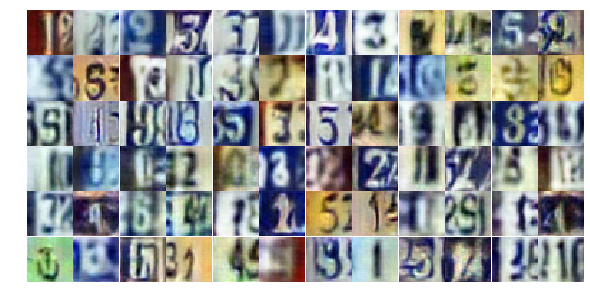

Epoch 16/25... Discriminator Loss: 1.3014... Generator Loss: 0.4490
Epoch 16/25... Discriminator Loss: 0.7514... Generator Loss: 0.9336
Epoch 16/25... Discriminator Loss: 1.3645... Generator Loss: 0.4411
Epoch 16/25... Discriminator Loss: 0.4935... Generator Loss: 2.3332
Epoch 16/25... Discriminator Loss: 0.8042... Generator Loss: 0.7895
Epoch 16/25... Discriminator Loss: 0.3981... Generator Loss: 1.8420
Epoch 17/25... Discriminator Loss: 0.5797... Generator Loss: 1.3123
Epoch 17/25... Discriminator Loss: 1.0270... Generator Loss: 0.6021
Epoch 17/25... Discriminator Loss: 0.5019... Generator Loss: 1.3193
Epoch 17/25... Discriminator Loss: 0.6763... Generator Loss: 1.0281


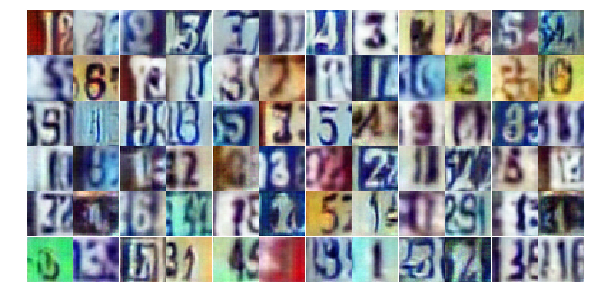

Epoch 17/25... Discriminator Loss: 0.4829... Generator Loss: 1.5307
Epoch 17/25... Discriminator Loss: 0.7438... Generator Loss: 0.9265
Epoch 17/25... Discriminator Loss: 1.2571... Generator Loss: 0.5255
Epoch 17/25... Discriminator Loss: 0.7014... Generator Loss: 1.0230
Epoch 17/25... Discriminator Loss: 0.9381... Generator Loss: 0.7523
Epoch 17/25... Discriminator Loss: 1.0369... Generator Loss: 0.6368
Epoch 17/25... Discriminator Loss: 0.7339... Generator Loss: 1.0653
Epoch 17/25... Discriminator Loss: 0.6871... Generator Loss: 0.9473
Epoch 17/25... Discriminator Loss: 0.4117... Generator Loss: 1.5326
Epoch 17/25... Discriminator Loss: 0.4909... Generator Loss: 1.5090


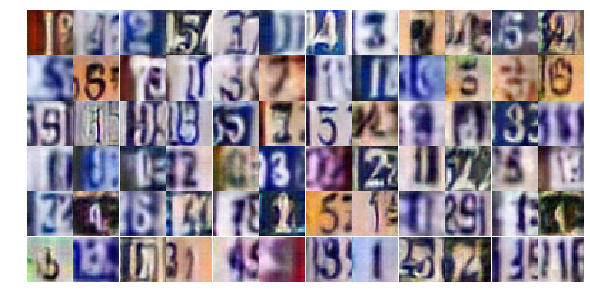

Epoch 17/25... Discriminator Loss: 0.8521... Generator Loss: 1.3976
Epoch 17/25... Discriminator Loss: 0.3940... Generator Loss: 1.9945
Epoch 17/25... Discriminator Loss: 0.6006... Generator Loss: 1.3119
Epoch 17/25... Discriminator Loss: 1.0043... Generator Loss: 1.4626
Epoch 17/25... Discriminator Loss: 0.5390... Generator Loss: 1.2138
Epoch 17/25... Discriminator Loss: 1.2333... Generator Loss: 0.5403
Epoch 17/25... Discriminator Loss: 0.6372... Generator Loss: 1.0909
Epoch 17/25... Discriminator Loss: 0.5907... Generator Loss: 1.1830
Epoch 17/25... Discriminator Loss: 0.6908... Generator Loss: 0.9367
Epoch 17/25... Discriminator Loss: 0.5321... Generator Loss: 1.3018


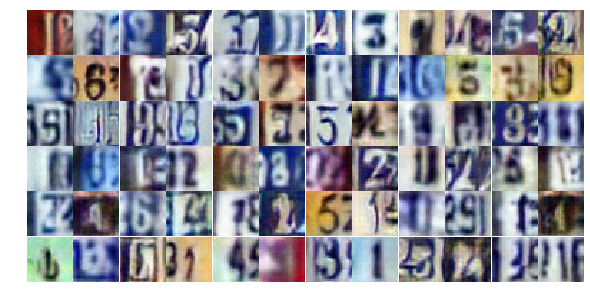

Epoch 17/25... Discriminator Loss: 1.7720... Generator Loss: 0.2502
Epoch 17/25... Discriminator Loss: 0.7212... Generator Loss: 2.5112
Epoch 17/25... Discriminator Loss: 0.5386... Generator Loss: 1.2554
Epoch 17/25... Discriminator Loss: 1.0981... Generator Loss: 0.5977
Epoch 17/25... Discriminator Loss: 0.8841... Generator Loss: 0.8099
Epoch 17/25... Discriminator Loss: 0.4322... Generator Loss: 1.6037
Epoch 17/25... Discriminator Loss: 0.5624... Generator Loss: 1.2356
Epoch 17/25... Discriminator Loss: 0.7675... Generator Loss: 0.9570
Epoch 17/25... Discriminator Loss: 1.2126... Generator Loss: 0.5458
Epoch 17/25... Discriminator Loss: 0.3791... Generator Loss: 1.8162


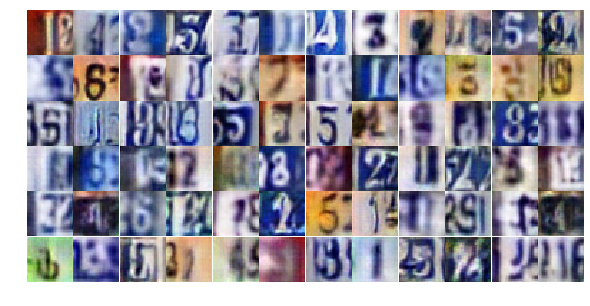

Epoch 17/25... Discriminator Loss: 0.6468... Generator Loss: 1.2601
Epoch 17/25... Discriminator Loss: 0.9451... Generator Loss: 1.0659
Epoch 17/25... Discriminator Loss: 0.8393... Generator Loss: 2.6111
Epoch 17/25... Discriminator Loss: 1.3496... Generator Loss: 0.5202
Epoch 17/25... Discriminator Loss: 0.6754... Generator Loss: 1.1648
Epoch 17/25... Discriminator Loss: 0.4487... Generator Loss: 2.5326
Epoch 17/25... Discriminator Loss: 0.9725... Generator Loss: 0.6630
Epoch 17/25... Discriminator Loss: 0.5098... Generator Loss: 1.5951
Epoch 17/25... Discriminator Loss: 0.3405... Generator Loss: 1.8412
Epoch 17/25... Discriminator Loss: 0.8133... Generator Loss: 0.8936


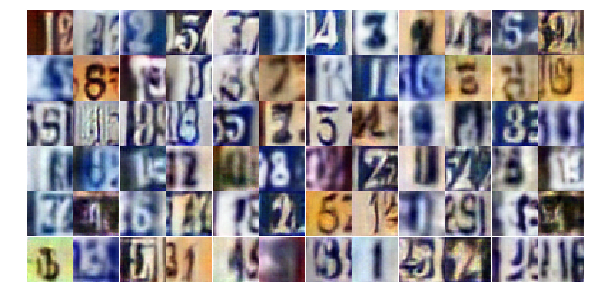

Epoch 17/25... Discriminator Loss: 1.3166... Generator Loss: 1.9248
Epoch 17/25... Discriminator Loss: 0.4312... Generator Loss: 1.7461
Epoch 17/25... Discriminator Loss: 0.7650... Generator Loss: 1.1776
Epoch 17/25... Discriminator Loss: 0.4138... Generator Loss: 1.5077
Epoch 17/25... Discriminator Loss: 0.6415... Generator Loss: 1.0204
Epoch 17/25... Discriminator Loss: 1.0256... Generator Loss: 3.1566
Epoch 17/25... Discriminator Loss: 0.7684... Generator Loss: 0.9030
Epoch 17/25... Discriminator Loss: 0.7628... Generator Loss: 0.9198
Epoch 17/25... Discriminator Loss: 0.5138... Generator Loss: 1.5455
Epoch 17/25... Discriminator Loss: 1.8228... Generator Loss: 0.2544


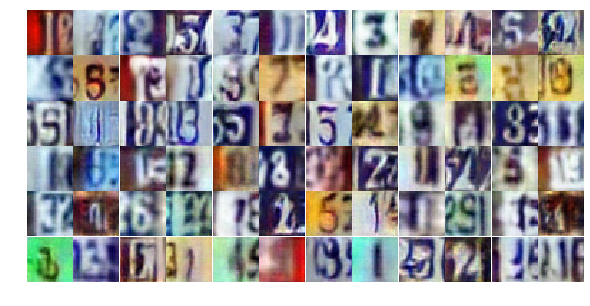

Epoch 17/25... Discriminator Loss: 0.8734... Generator Loss: 0.8490
Epoch 17/25... Discriminator Loss: 0.7227... Generator Loss: 1.6912
Epoch 17/25... Discriminator Loss: 0.5396... Generator Loss: 1.3200
Epoch 17/25... Discriminator Loss: 0.6015... Generator Loss: 1.1762
Epoch 18/25... Discriminator Loss: 0.8966... Generator Loss: 0.8256
Epoch 18/25... Discriminator Loss: 0.8070... Generator Loss: 0.8185
Epoch 18/25... Discriminator Loss: 0.8841... Generator Loss: 0.8188
Epoch 18/25... Discriminator Loss: 0.8669... Generator Loss: 0.7957
Epoch 18/25... Discriminator Loss: 1.1638... Generator Loss: 0.5386
Epoch 18/25... Discriminator Loss: 0.5778... Generator Loss: 1.4265


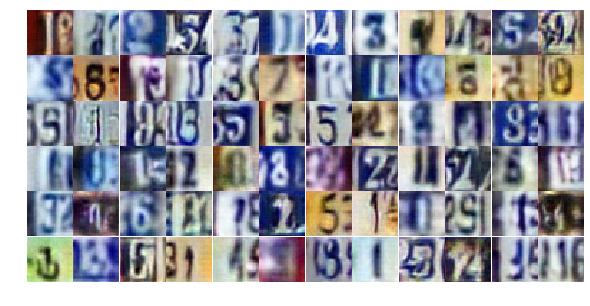

Epoch 18/25... Discriminator Loss: 0.2889... Generator Loss: 2.3080
Epoch 18/25... Discriminator Loss: 0.7628... Generator Loss: 0.9731
Epoch 18/25... Discriminator Loss: 0.8046... Generator Loss: 0.8606
Epoch 18/25... Discriminator Loss: 0.4320... Generator Loss: 1.5832
Epoch 18/25... Discriminator Loss: 0.5636... Generator Loss: 1.2354
Epoch 18/25... Discriminator Loss: 0.7474... Generator Loss: 0.9084
Epoch 18/25... Discriminator Loss: 0.5669... Generator Loss: 1.2563
Epoch 18/25... Discriminator Loss: 0.5206... Generator Loss: 1.1936
Epoch 18/25... Discriminator Loss: 0.6217... Generator Loss: 1.3597
Epoch 18/25... Discriminator Loss: 0.7580... Generator Loss: 1.0419


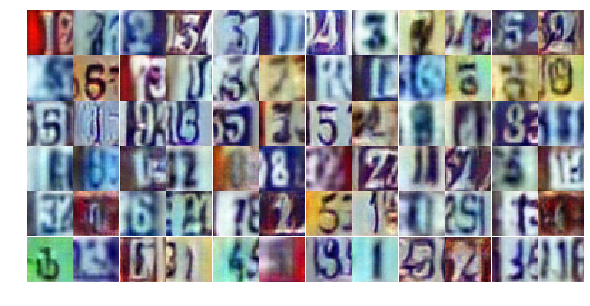

Epoch 18/25... Discriminator Loss: 0.5916... Generator Loss: 1.5288
Epoch 18/25... Discriminator Loss: 0.7904... Generator Loss: 0.9511
Epoch 18/25... Discriminator Loss: 1.2758... Generator Loss: 0.5026
Epoch 18/25... Discriminator Loss: 0.5390... Generator Loss: 1.3077
Epoch 18/25... Discriminator Loss: 1.3093... Generator Loss: 0.4761
Epoch 18/25... Discriminator Loss: 1.3876... Generator Loss: 0.4189
Epoch 18/25... Discriminator Loss: 1.2739... Generator Loss: 0.4918
Epoch 18/25... Discriminator Loss: 1.4441... Generator Loss: 0.3897
Epoch 18/25... Discriminator Loss: 0.8917... Generator Loss: 0.7691
Epoch 18/25... Discriminator Loss: 0.7712... Generator Loss: 0.8970


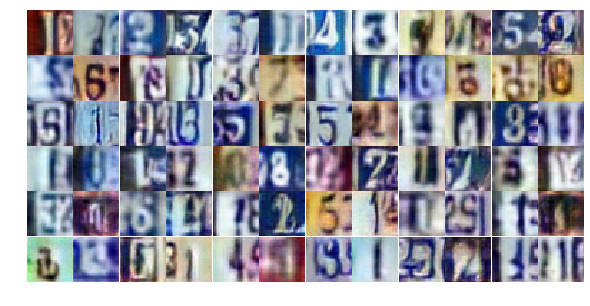

Epoch 18/25... Discriminator Loss: 0.4372... Generator Loss: 1.6149
Epoch 18/25... Discriminator Loss: 0.8417... Generator Loss: 1.7702
Epoch 18/25... Discriminator Loss: 3.2260... Generator Loss: 5.6559
Epoch 18/25... Discriminator Loss: 1.2313... Generator Loss: 0.6025
Epoch 18/25... Discriminator Loss: 1.0336... Generator Loss: 0.9421
Epoch 18/25... Discriminator Loss: 0.8747... Generator Loss: 0.8862
Epoch 18/25... Discriminator Loss: 0.6448... Generator Loss: 1.1787
Epoch 18/25... Discriminator Loss: 0.4024... Generator Loss: 1.7166
Epoch 18/25... Discriminator Loss: 0.6131... Generator Loss: 1.1616
Epoch 18/25... Discriminator Loss: 0.5631... Generator Loss: 1.3840


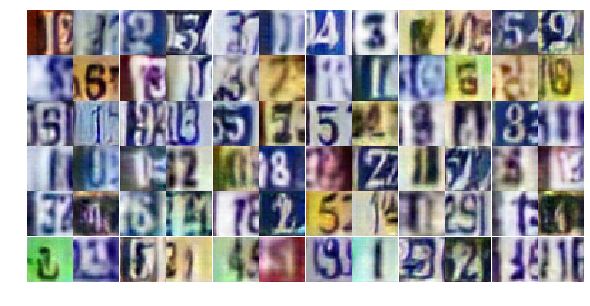

Epoch 18/25... Discriminator Loss: 0.6255... Generator Loss: 1.1572
Epoch 18/25... Discriminator Loss: 0.9581... Generator Loss: 0.6862
Epoch 18/25... Discriminator Loss: 0.6316... Generator Loss: 1.0223
Epoch 18/25... Discriminator Loss: 0.6660... Generator Loss: 1.0205
Epoch 18/25... Discriminator Loss: 0.7821... Generator Loss: 1.1176
Epoch 18/25... Discriminator Loss: 0.5489... Generator Loss: 1.2255
Epoch 18/25... Discriminator Loss: 0.8912... Generator Loss: 0.7630
Epoch 18/25... Discriminator Loss: 1.3499... Generator Loss: 3.1381
Epoch 18/25... Discriminator Loss: 1.3621... Generator Loss: 0.4004
Epoch 18/25... Discriminator Loss: 0.4239... Generator Loss: 1.4892


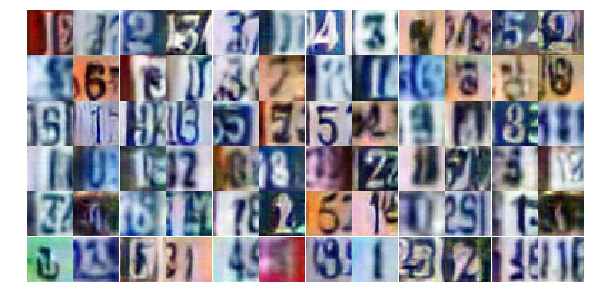

Epoch 18/25... Discriminator Loss: 0.4650... Generator Loss: 1.5076
Epoch 18/25... Discriminator Loss: 0.7624... Generator Loss: 0.9112
Epoch 18/25... Discriminator Loss: 1.1463... Generator Loss: 0.6063
Epoch 18/25... Discriminator Loss: 0.9841... Generator Loss: 0.6912
Epoch 18/25... Discriminator Loss: 0.7804... Generator Loss: 0.9425
Epoch 18/25... Discriminator Loss: 0.5288... Generator Loss: 2.0879
Epoch 18/25... Discriminator Loss: 0.6795... Generator Loss: 1.1352
Epoch 18/25... Discriminator Loss: 0.4617... Generator Loss: 1.7943
Epoch 18/25... Discriminator Loss: 1.3635... Generator Loss: 0.4210
Epoch 18/25... Discriminator Loss: 0.8355... Generator Loss: 0.7930


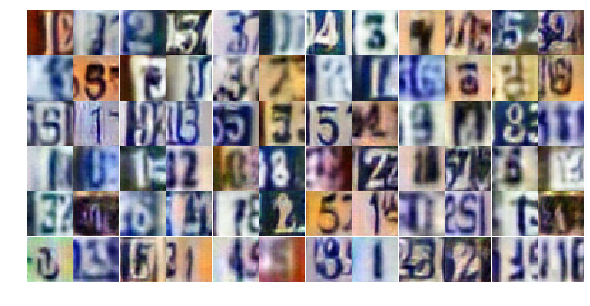

Epoch 18/25... Discriminator Loss: 0.5950... Generator Loss: 2.6360
Epoch 19/25... Discriminator Loss: 0.9437... Generator Loss: 0.7599
Epoch 19/25... Discriminator Loss: 1.2184... Generator Loss: 0.5034
Epoch 19/25... Discriminator Loss: 0.8822... Generator Loss: 0.7926
Epoch 19/25... Discriminator Loss: 0.7455... Generator Loss: 0.9039
Epoch 19/25... Discriminator Loss: 1.1467... Generator Loss: 0.5682
Epoch 19/25... Discriminator Loss: 0.5356... Generator Loss: 1.2006
Epoch 19/25... Discriminator Loss: 1.6114... Generator Loss: 0.3282
Epoch 19/25... Discriminator Loss: 0.6679... Generator Loss: 1.7805
Epoch 19/25... Discriminator Loss: 0.8825... Generator Loss: 0.7535


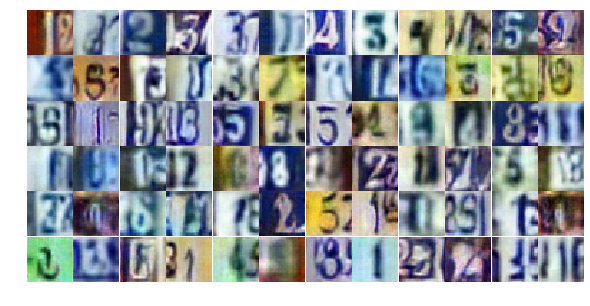

Epoch 19/25... Discriminator Loss: 0.6865... Generator Loss: 0.9050
Epoch 19/25... Discriminator Loss: 0.7125... Generator Loss: 0.8779
Epoch 19/25... Discriminator Loss: 0.8861... Generator Loss: 0.7761
Epoch 19/25... Discriminator Loss: 1.6357... Generator Loss: 0.2975
Epoch 19/25... Discriminator Loss: 1.2912... Generator Loss: 0.4575
Epoch 19/25... Discriminator Loss: 0.7010... Generator Loss: 0.9694
Epoch 19/25... Discriminator Loss: 1.3049... Generator Loss: 0.4868
Epoch 19/25... Discriminator Loss: 0.6340... Generator Loss: 1.0789
Epoch 19/25... Discriminator Loss: 0.7698... Generator Loss: 1.9295
Epoch 19/25... Discriminator Loss: 4.0627... Generator Loss: 3.2196


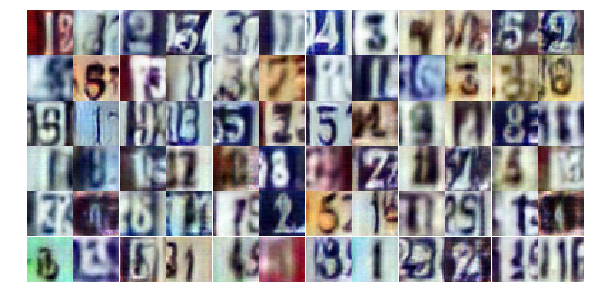

Epoch 19/25... Discriminator Loss: 1.5508... Generator Loss: 0.3982
Epoch 19/25... Discriminator Loss: 1.1533... Generator Loss: 0.6181
Epoch 19/25... Discriminator Loss: 1.2955... Generator Loss: 0.4658
Epoch 19/25... Discriminator Loss: 0.8561... Generator Loss: 0.8730
Epoch 19/25... Discriminator Loss: 1.1129... Generator Loss: 0.6271
Epoch 19/25... Discriminator Loss: 0.8953... Generator Loss: 0.7962
Epoch 19/25... Discriminator Loss: 0.7399... Generator Loss: 0.9502
Epoch 19/25... Discriminator Loss: 0.7788... Generator Loss: 0.8883
Epoch 19/25... Discriminator Loss: 0.5791... Generator Loss: 1.3915
Epoch 19/25... Discriminator Loss: 1.2344... Generator Loss: 0.5188


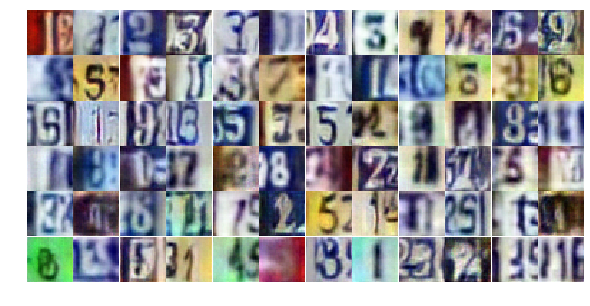

Epoch 19/25... Discriminator Loss: 1.1665... Generator Loss: 0.5552
Epoch 19/25... Discriminator Loss: 0.6976... Generator Loss: 1.0446
Epoch 19/25... Discriminator Loss: 0.9056... Generator Loss: 0.7642
Epoch 19/25... Discriminator Loss: 0.6026... Generator Loss: 1.1816
Epoch 19/25... Discriminator Loss: 0.6323... Generator Loss: 1.3289
Epoch 19/25... Discriminator Loss: 1.2836... Generator Loss: 0.4612
Epoch 19/25... Discriminator Loss: 0.6607... Generator Loss: 1.1262
Epoch 19/25... Discriminator Loss: 0.5474... Generator Loss: 1.4874
Epoch 19/25... Discriminator Loss: 0.6809... Generator Loss: 1.1289
Epoch 19/25... Discriminator Loss: 0.6921... Generator Loss: 0.8987


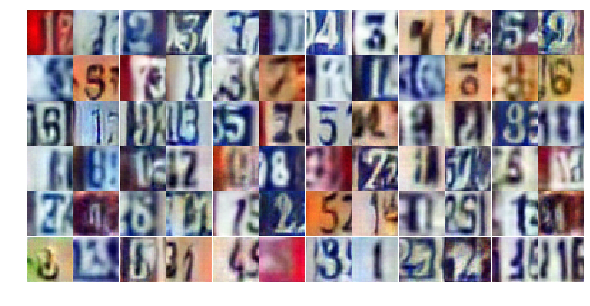

Epoch 19/25... Discriminator Loss: 0.6793... Generator Loss: 0.9115
Epoch 19/25... Discriminator Loss: 0.7079... Generator Loss: 1.0010
Epoch 19/25... Discriminator Loss: 1.0857... Generator Loss: 0.5703
Epoch 19/25... Discriminator Loss: 0.7323... Generator Loss: 0.9111
Epoch 19/25... Discriminator Loss: 0.8129... Generator Loss: 1.0137
Epoch 19/25... Discriminator Loss: 0.5267... Generator Loss: 1.4432
Epoch 19/25... Discriminator Loss: 0.7483... Generator Loss: 0.9876
Epoch 19/25... Discriminator Loss: 0.5345... Generator Loss: 1.2484
Epoch 19/25... Discriminator Loss: 0.5205... Generator Loss: 1.3192
Epoch 19/25... Discriminator Loss: 0.8227... Generator Loss: 0.9217


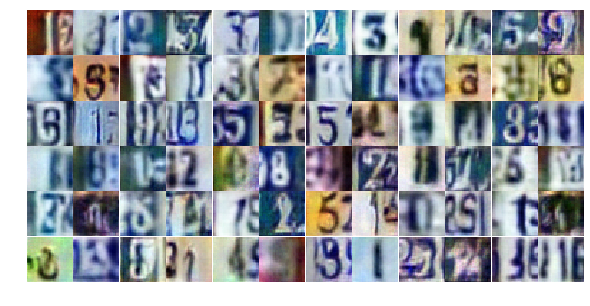

Epoch 19/25... Discriminator Loss: 0.8904... Generator Loss: 0.7636
Epoch 19/25... Discriminator Loss: 0.7335... Generator Loss: 0.9818
Epoch 19/25... Discriminator Loss: 0.8562... Generator Loss: 0.8068
Epoch 19/25... Discriminator Loss: 1.0589... Generator Loss: 0.6047
Epoch 19/25... Discriminator Loss: 0.9846... Generator Loss: 0.6560
Epoch 19/25... Discriminator Loss: 0.6372... Generator Loss: 1.1486
Epoch 19/25... Discriminator Loss: 1.5609... Generator Loss: 0.3548
Epoch 19/25... Discriminator Loss: 0.5331... Generator Loss: 1.2866
Epoch 20/25... Discriminator Loss: 0.7652... Generator Loss: 0.9608
Epoch 20/25... Discriminator Loss: 1.1911... Generator Loss: 0.5435


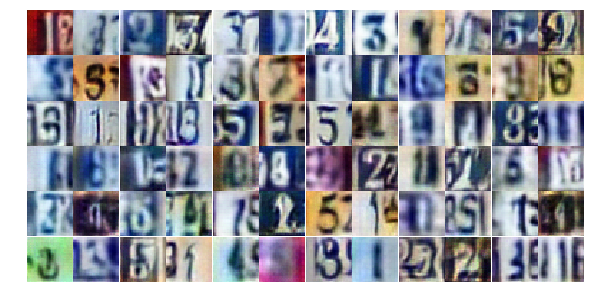

Epoch 20/25... Discriminator Loss: 0.5641... Generator Loss: 1.8284
Epoch 20/25... Discriminator Loss: 0.8966... Generator Loss: 0.8144
Epoch 20/25... Discriminator Loss: 1.6342... Generator Loss: 0.3294
Epoch 20/25... Discriminator Loss: 1.1019... Generator Loss: 0.6044
Epoch 20/25... Discriminator Loss: 0.5461... Generator Loss: 1.3193
Epoch 20/25... Discriminator Loss: 0.5504... Generator Loss: 1.2480
Epoch 20/25... Discriminator Loss: 1.0115... Generator Loss: 0.6832
Epoch 20/25... Discriminator Loss: 0.7805... Generator Loss: 0.9006
Epoch 20/25... Discriminator Loss: 1.1016... Generator Loss: 0.6804
Epoch 20/25... Discriminator Loss: 0.7708... Generator Loss: 0.8509


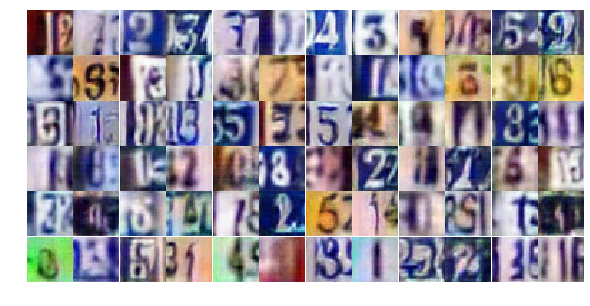

Epoch 20/25... Discriminator Loss: 1.2908... Generator Loss: 0.4804
Epoch 20/25... Discriminator Loss: 0.8918... Generator Loss: 0.7998
Epoch 20/25... Discriminator Loss: 0.6146... Generator Loss: 1.1976
Epoch 20/25... Discriminator Loss: 0.6465... Generator Loss: 1.2078
Epoch 20/25... Discriminator Loss: 1.3729... Generator Loss: 0.4290
Epoch 20/25... Discriminator Loss: 0.8538... Generator Loss: 2.2866
Epoch 20/25... Discriminator Loss: 1.1949... Generator Loss: 0.5720
Epoch 20/25... Discriminator Loss: 0.8890... Generator Loss: 0.7167
Epoch 20/25... Discriminator Loss: 0.4080... Generator Loss: 1.5876
Epoch 20/25... Discriminator Loss: 1.1065... Generator Loss: 0.5715


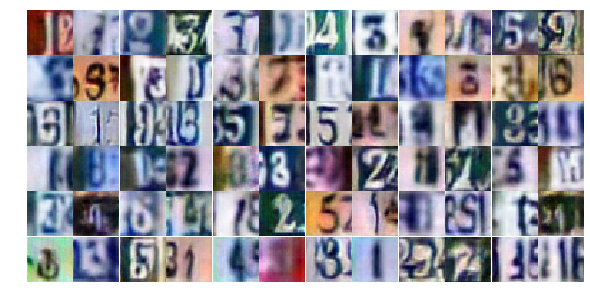

Epoch 20/25... Discriminator Loss: 0.6033... Generator Loss: 1.1792
Epoch 20/25... Discriminator Loss: 0.6410... Generator Loss: 1.0901
Epoch 20/25... Discriminator Loss: 0.3409... Generator Loss: 1.7642
Epoch 20/25... Discriminator Loss: 1.3987... Generator Loss: 0.3772
Epoch 20/25... Discriminator Loss: 1.5044... Generator Loss: 0.3822
Epoch 20/25... Discriminator Loss: 0.6838... Generator Loss: 0.9002
Epoch 20/25... Discriminator Loss: 0.5609... Generator Loss: 2.0138
Epoch 20/25... Discriminator Loss: 1.8989... Generator Loss: 0.2721
Epoch 20/25... Discriminator Loss: 0.8754... Generator Loss: 0.7739
Epoch 20/25... Discriminator Loss: 0.4598... Generator Loss: 1.4175


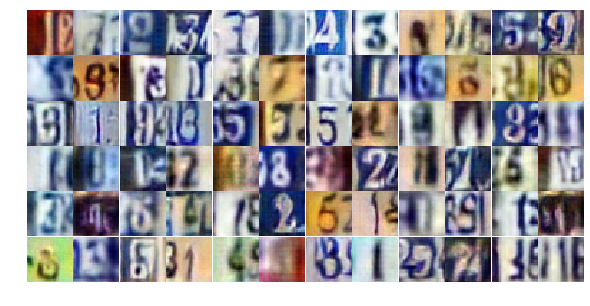

Epoch 20/25... Discriminator Loss: 0.6593... Generator Loss: 1.2188
Epoch 20/25... Discriminator Loss: 0.7362... Generator Loss: 0.9371
Epoch 20/25... Discriminator Loss: 1.0616... Generator Loss: 0.6421
Epoch 20/25... Discriminator Loss: 0.7781... Generator Loss: 0.9924
Epoch 20/25... Discriminator Loss: 0.9218... Generator Loss: 0.8045
Epoch 20/25... Discriminator Loss: 0.9246... Generator Loss: 0.7393
Epoch 20/25... Discriminator Loss: 0.6927... Generator Loss: 1.7870
Epoch 20/25... Discriminator Loss: 1.4822... Generator Loss: 0.4183
Epoch 20/25... Discriminator Loss: 0.9551... Generator Loss: 0.7390
Epoch 20/25... Discriminator Loss: 1.1346... Generator Loss: 0.5702


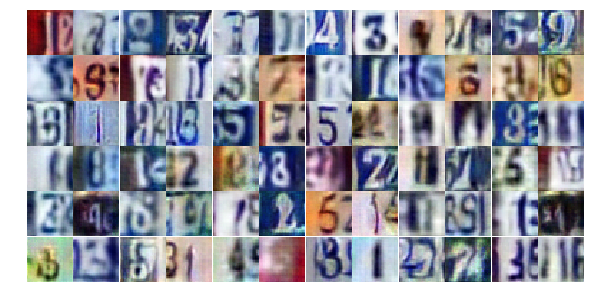

Epoch 20/25... Discriminator Loss: 2.1238... Generator Loss: 0.2327
Epoch 20/25... Discriminator Loss: 1.7222... Generator Loss: 0.2965
Epoch 20/25... Discriminator Loss: 1.2860... Generator Loss: 0.6559
Epoch 20/25... Discriminator Loss: 0.4676... Generator Loss: 1.5753
Epoch 20/25... Discriminator Loss: 0.7719... Generator Loss: 0.9044
Epoch 20/25... Discriminator Loss: 1.1285... Generator Loss: 0.5862
Epoch 20/25... Discriminator Loss: 0.8050... Generator Loss: 0.8480
Epoch 20/25... Discriminator Loss: 0.4800... Generator Loss: 1.6165
Epoch 20/25... Discriminator Loss: 0.6809... Generator Loss: 2.1272
Epoch 20/25... Discriminator Loss: 0.7010... Generator Loss: 0.9743


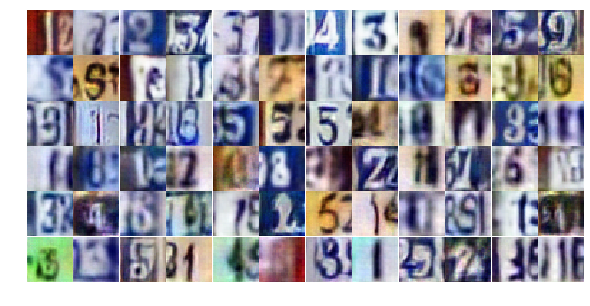

Epoch 20/25... Discriminator Loss: 0.5309... Generator Loss: 1.5887
Epoch 20/25... Discriminator Loss: 0.8803... Generator Loss: 0.8081
Epoch 20/25... Discriminator Loss: 0.4770... Generator Loss: 1.4894
Epoch 20/25... Discriminator Loss: 0.7723... Generator Loss: 1.4459
Epoch 20/25... Discriminator Loss: 0.7092... Generator Loss: 0.8980
Epoch 20/25... Discriminator Loss: 0.5576... Generator Loss: 1.0532
Epoch 21/25... Discriminator Loss: 0.7730... Generator Loss: 1.3846
Epoch 21/25... Discriminator Loss: 0.6471... Generator Loss: 1.1099
Epoch 21/25... Discriminator Loss: 1.0096... Generator Loss: 0.6987
Epoch 21/25... Discriminator Loss: 0.9068... Generator Loss: 0.7579


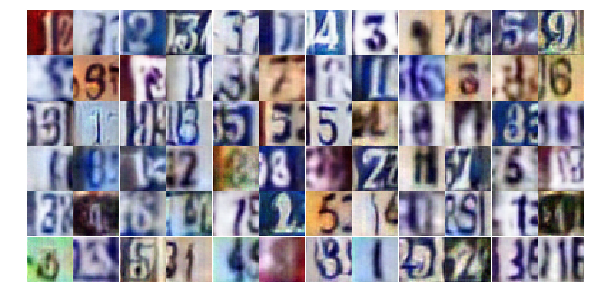

Epoch 21/25... Discriminator Loss: 0.5789... Generator Loss: 1.4425
Epoch 21/25... Discriminator Loss: 1.8414... Generator Loss: 0.2668
Epoch 21/25... Discriminator Loss: 1.5731... Generator Loss: 0.8190
Epoch 21/25... Discriminator Loss: 0.4833... Generator Loss: 2.1909
Epoch 21/25... Discriminator Loss: 0.7144... Generator Loss: 1.0239
Epoch 21/25... Discriminator Loss: 0.4177... Generator Loss: 1.5432
Epoch 21/25... Discriminator Loss: 1.3797... Generator Loss: 0.4465
Epoch 21/25... Discriminator Loss: 0.8698... Generator Loss: 0.7844
Epoch 21/25... Discriminator Loss: 0.6296... Generator Loss: 1.0705
Epoch 21/25... Discriminator Loss: 0.9290... Generator Loss: 0.7370


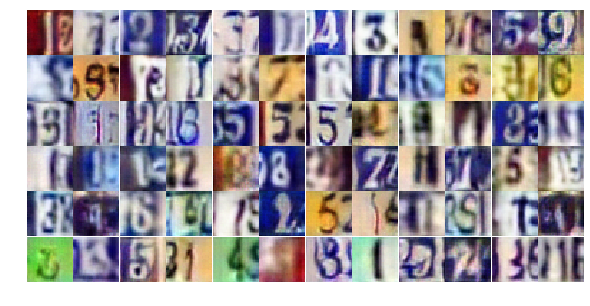

Epoch 21/25... Discriminator Loss: 0.3523... Generator Loss: 2.0340
Epoch 21/25... Discriminator Loss: 1.0276... Generator Loss: 0.6052
Epoch 21/25... Discriminator Loss: 2.2283... Generator Loss: 0.2314
Epoch 21/25... Discriminator Loss: 1.9049... Generator Loss: 0.2693
Epoch 21/25... Discriminator Loss: 0.6688... Generator Loss: 1.2760
Epoch 21/25... Discriminator Loss: 1.0071... Generator Loss: 0.6786
Epoch 21/25... Discriminator Loss: 1.0672... Generator Loss: 0.5764
Epoch 21/25... Discriminator Loss: 0.4320... Generator Loss: 1.6486
Epoch 21/25... Discriminator Loss: 0.4730... Generator Loss: 1.6088
Epoch 21/25... Discriminator Loss: 0.9493... Generator Loss: 0.7248


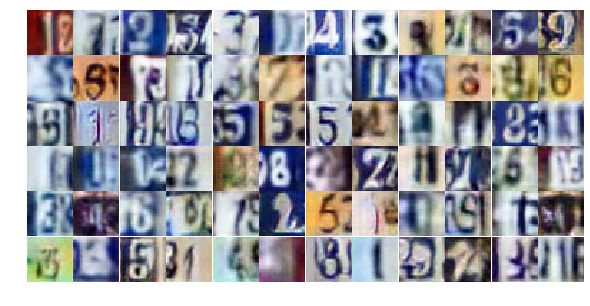

Epoch 21/25... Discriminator Loss: 1.2800... Generator Loss: 0.4815
Epoch 21/25... Discriminator Loss: 0.3705... Generator Loss: 1.7330
Epoch 21/25... Discriminator Loss: 1.3812... Generator Loss: 0.4773
Epoch 21/25... Discriminator Loss: 0.8696... Generator Loss: 0.7877
Epoch 21/25... Discriminator Loss: 0.7341... Generator Loss: 0.9323
Epoch 21/25... Discriminator Loss: 0.9872... Generator Loss: 0.6980
Epoch 21/25... Discriminator Loss: 0.3505... Generator Loss: 1.9910
Epoch 21/25... Discriminator Loss: 1.8424... Generator Loss: 0.2651
Epoch 21/25... Discriminator Loss: 0.9409... Generator Loss: 0.7756
Epoch 21/25... Discriminator Loss: 1.5729... Generator Loss: 0.4096


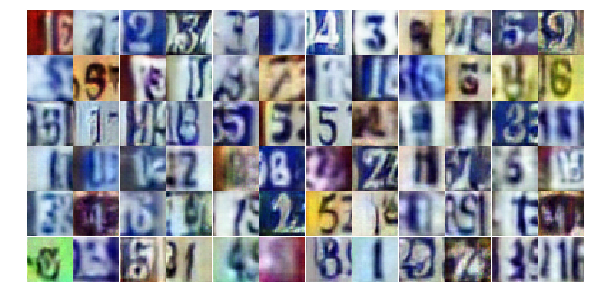

Epoch 21/25... Discriminator Loss: 1.0615... Generator Loss: 0.5863
Epoch 21/25... Discriminator Loss: 0.6301... Generator Loss: 1.0599
Epoch 21/25... Discriminator Loss: 1.4207... Generator Loss: 0.4284
Epoch 21/25... Discriminator Loss: 0.5055... Generator Loss: 1.2329
Epoch 21/25... Discriminator Loss: 0.5566... Generator Loss: 1.1824
Epoch 21/25... Discriminator Loss: 0.6487... Generator Loss: 1.1164
Epoch 21/25... Discriminator Loss: 0.6961... Generator Loss: 1.0278
Epoch 21/25... Discriminator Loss: 1.6720... Generator Loss: 0.3996
Epoch 21/25... Discriminator Loss: 0.7091... Generator Loss: 0.9793
Epoch 21/25... Discriminator Loss: 0.6475... Generator Loss: 1.2306


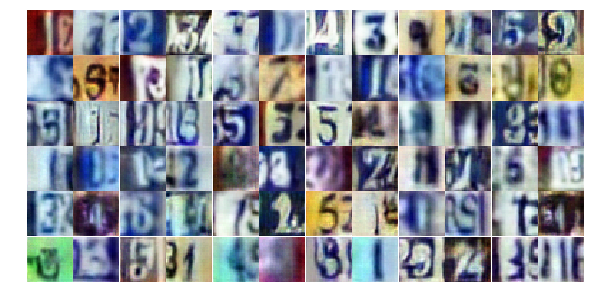

Epoch 21/25... Discriminator Loss: 0.7525... Generator Loss: 1.5333
Epoch 21/25... Discriminator Loss: 1.2160... Generator Loss: 0.5710
Epoch 21/25... Discriminator Loss: 0.6167... Generator Loss: 1.1564
Epoch 21/25... Discriminator Loss: 0.7174... Generator Loss: 0.9664
Epoch 21/25... Discriminator Loss: 0.4881... Generator Loss: 1.4113
Epoch 21/25... Discriminator Loss: 0.6599... Generator Loss: 1.1847
Epoch 21/25... Discriminator Loss: 0.7674... Generator Loss: 0.8334
Epoch 21/25... Discriminator Loss: 1.1756... Generator Loss: 0.5452
Epoch 21/25... Discriminator Loss: 0.8287... Generator Loss: 0.8080
Epoch 21/25... Discriminator Loss: 0.5254... Generator Loss: 1.3482


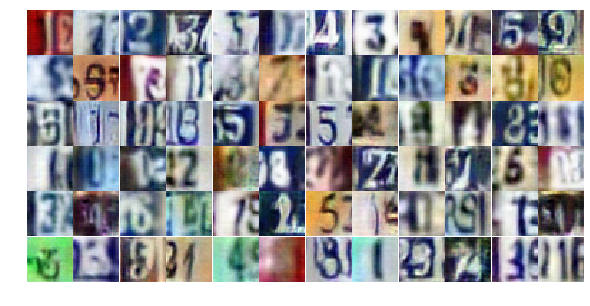

Epoch 21/25... Discriminator Loss: 0.6841... Generator Loss: 1.0669
Epoch 21/25... Discriminator Loss: 1.1117... Generator Loss: 0.5616
Epoch 21/25... Discriminator Loss: 0.5488... Generator Loss: 1.4847
Epoch 22/25... Discriminator Loss: 0.7680... Generator Loss: 1.1474
Epoch 22/25... Discriminator Loss: 0.7276... Generator Loss: 1.0484
Epoch 22/25... Discriminator Loss: 1.2291... Generator Loss: 0.5108
Epoch 22/25... Discriminator Loss: 0.6445... Generator Loss: 1.1477
Epoch 22/25... Discriminator Loss: 0.5619... Generator Loss: 1.2188
Epoch 22/25... Discriminator Loss: 1.3454... Generator Loss: 0.4351
Epoch 22/25... Discriminator Loss: 0.8445... Generator Loss: 0.8954


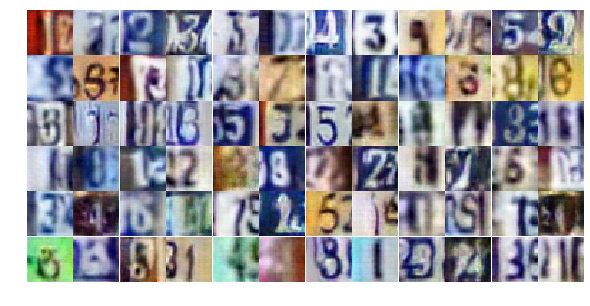

Epoch 22/25... Discriminator Loss: 0.5786... Generator Loss: 1.5401
Epoch 22/25... Discriminator Loss: 0.7005... Generator Loss: 1.2316
Epoch 22/25... Discriminator Loss: 1.3574... Generator Loss: 0.5284
Epoch 22/25... Discriminator Loss: 0.9307... Generator Loss: 0.7169
Epoch 22/25... Discriminator Loss: 1.0312... Generator Loss: 0.6232
Epoch 22/25... Discriminator Loss: 0.7001... Generator Loss: 0.9207
Epoch 22/25... Discriminator Loss: 0.7232... Generator Loss: 1.1846
Epoch 22/25... Discriminator Loss: 0.4397... Generator Loss: 1.4210
Epoch 22/25... Discriminator Loss: 0.7293... Generator Loss: 1.0165
Epoch 22/25... Discriminator Loss: 1.7079... Generator Loss: 0.3056


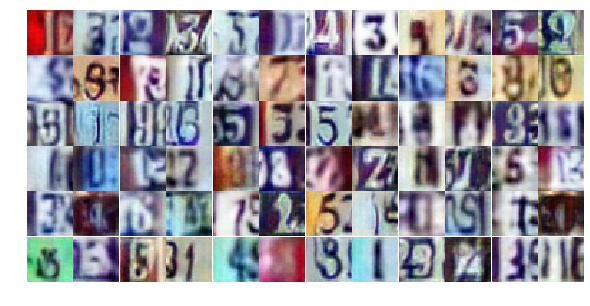

Epoch 22/25... Discriminator Loss: 1.1510... Generator Loss: 0.6313
Epoch 22/25... Discriminator Loss: 0.6243... Generator Loss: 2.5519
Epoch 22/25... Discriminator Loss: 0.8713... Generator Loss: 0.8221
Epoch 22/25... Discriminator Loss: 0.5417... Generator Loss: 1.2693
Epoch 22/25... Discriminator Loss: 0.6034... Generator Loss: 1.0761
Epoch 22/25... Discriminator Loss: 1.0483... Generator Loss: 0.6110
Epoch 22/25... Discriminator Loss: 0.4702... Generator Loss: 1.8278
Epoch 22/25... Discriminator Loss: 0.5989... Generator Loss: 3.1878
Epoch 22/25... Discriminator Loss: 0.4496... Generator Loss: 1.6790
Epoch 22/25... Discriminator Loss: 0.9596... Generator Loss: 0.8030


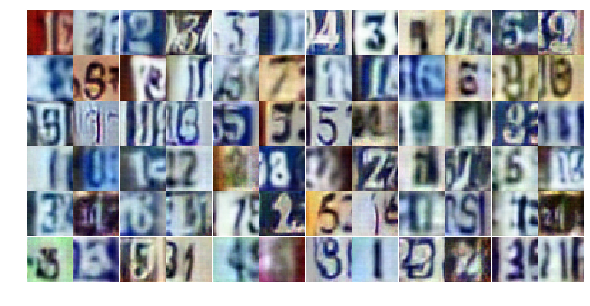

Epoch 22/25... Discriminator Loss: 0.4881... Generator Loss: 1.2456
Epoch 22/25... Discriminator Loss: 0.6723... Generator Loss: 1.0897
Epoch 22/25... Discriminator Loss: 0.9982... Generator Loss: 0.6871
Epoch 22/25... Discriminator Loss: 0.7167... Generator Loss: 0.9438
Epoch 22/25... Discriminator Loss: 1.0993... Generator Loss: 0.5898
Epoch 22/25... Discriminator Loss: 0.8501... Generator Loss: 0.8573
Epoch 22/25... Discriminator Loss: 2.0356... Generator Loss: 0.2202
Epoch 22/25... Discriminator Loss: 0.4867... Generator Loss: 1.9384
Epoch 22/25... Discriminator Loss: 0.8185... Generator Loss: 0.9957
Epoch 22/25... Discriminator Loss: 0.7362... Generator Loss: 0.9475


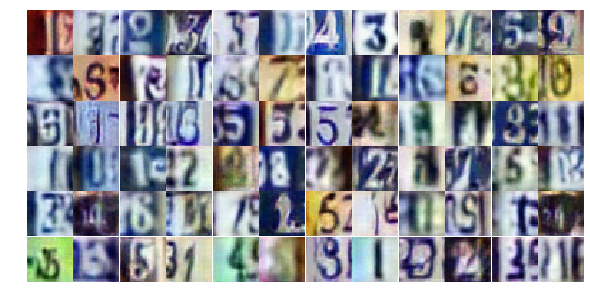

Epoch 22/25... Discriminator Loss: 0.7056... Generator Loss: 1.6691
Epoch 22/25... Discriminator Loss: 0.6031... Generator Loss: 1.2757
Epoch 22/25... Discriminator Loss: 0.3638... Generator Loss: 1.6960
Epoch 22/25... Discriminator Loss: 0.8059... Generator Loss: 0.8392
Epoch 22/25... Discriminator Loss: 0.6466... Generator Loss: 0.9693
Epoch 22/25... Discriminator Loss: 0.4258... Generator Loss: 1.3968
Epoch 22/25... Discriminator Loss: 0.9816... Generator Loss: 0.7529
Epoch 22/25... Discriminator Loss: 1.9415... Generator Loss: 2.6172
Epoch 22/25... Discriminator Loss: 1.3060... Generator Loss: 0.6851
Epoch 22/25... Discriminator Loss: 1.2454... Generator Loss: 0.7793


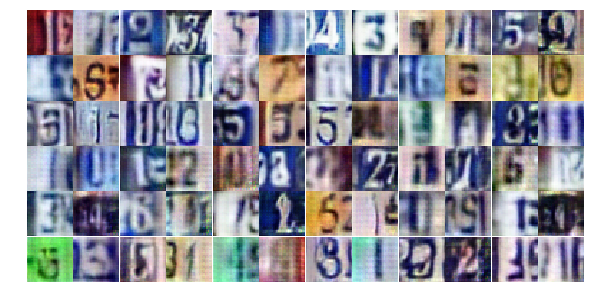

Epoch 22/25... Discriminator Loss: 1.7930... Generator Loss: 3.2725
Epoch 22/25... Discriminator Loss: 0.8138... Generator Loss: 1.6703
Epoch 22/25... Discriminator Loss: 0.8788... Generator Loss: 0.8465
Epoch 22/25... Discriminator Loss: 0.8367... Generator Loss: 0.9318
Epoch 22/25... Discriminator Loss: 0.8701... Generator Loss: 0.8368
Epoch 22/25... Discriminator Loss: 0.7367... Generator Loss: 1.1733
Epoch 22/25... Discriminator Loss: 0.9200... Generator Loss: 1.3014
Epoch 22/25... Discriminator Loss: 0.6559... Generator Loss: 1.1980
Epoch 22/25... Discriminator Loss: 0.9984... Generator Loss: 1.9254
Epoch 22/25... Discriminator Loss: 0.8832... Generator Loss: 0.8914


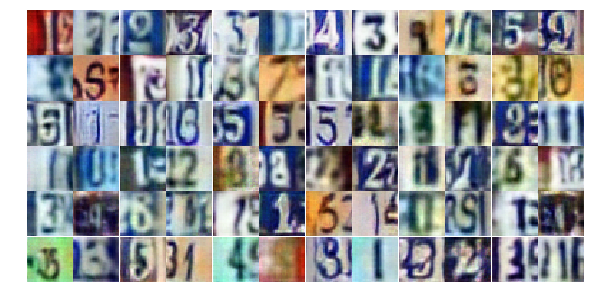

Epoch 23/25... Discriminator Loss: 0.5149... Generator Loss: 1.3502
Epoch 23/25... Discriminator Loss: 0.5235... Generator Loss: 1.2252
Epoch 23/25... Discriminator Loss: 0.9846... Generator Loss: 0.6546
Epoch 23/25... Discriminator Loss: 0.5056... Generator Loss: 1.3280
Epoch 23/25... Discriminator Loss: 0.8329... Generator Loss: 0.8273
Epoch 23/25... Discriminator Loss: 0.8284... Generator Loss: 1.4527
Epoch 23/25... Discriminator Loss: 1.1171... Generator Loss: 0.6373
Epoch 23/25... Discriminator Loss: 0.8367... Generator Loss: 0.8555
Epoch 23/25... Discriminator Loss: 0.7603... Generator Loss: 0.8507
Epoch 23/25... Discriminator Loss: 0.3932... Generator Loss: 1.5184


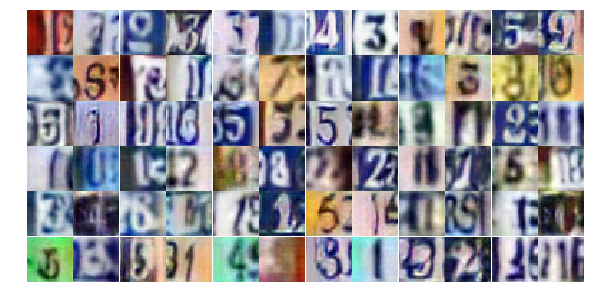

Epoch 23/25... Discriminator Loss: 0.5266... Generator Loss: 1.2988
Epoch 23/25... Discriminator Loss: 0.5922... Generator Loss: 1.1158
Epoch 23/25... Discriminator Loss: 0.8589... Generator Loss: 0.7796
Epoch 23/25... Discriminator Loss: 0.9781... Generator Loss: 0.6758
Epoch 23/25... Discriminator Loss: 0.5404... Generator Loss: 1.2564
Epoch 23/25... Discriminator Loss: 0.7800... Generator Loss: 0.9052
Epoch 23/25... Discriminator Loss: 0.8300... Generator Loss: 0.8351
Epoch 23/25... Discriminator Loss: 0.8624... Generator Loss: 2.9178
Epoch 23/25... Discriminator Loss: 1.0903... Generator Loss: 2.3901
Epoch 23/25... Discriminator Loss: 1.1445... Generator Loss: 0.6024


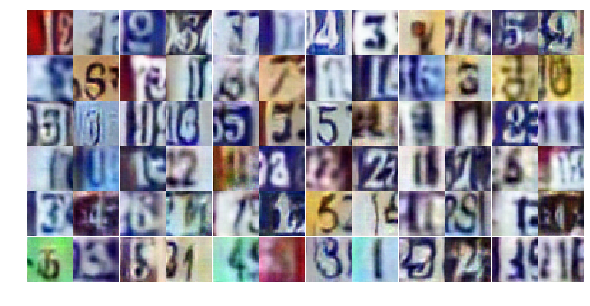

Epoch 23/25... Discriminator Loss: 1.1633... Generator Loss: 0.5208
Epoch 23/25... Discriminator Loss: 0.8892... Generator Loss: 0.7616
Epoch 23/25... Discriminator Loss: 0.8094... Generator Loss: 0.8554
Epoch 23/25... Discriminator Loss: 0.6581... Generator Loss: 1.0993
Epoch 23/25... Discriminator Loss: 0.5789... Generator Loss: 1.1927
Epoch 23/25... Discriminator Loss: 0.7142... Generator Loss: 1.1625
Epoch 23/25... Discriminator Loss: 0.5710... Generator Loss: 1.3388
Epoch 23/25... Discriminator Loss: 0.7621... Generator Loss: 0.8737
Epoch 23/25... Discriminator Loss: 0.7247... Generator Loss: 0.9714
Epoch 23/25... Discriminator Loss: 0.7126... Generator Loss: 2.2795


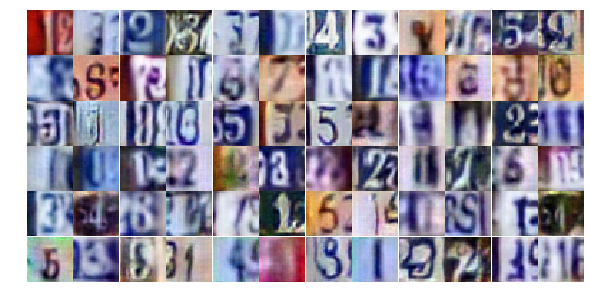

Epoch 23/25... Discriminator Loss: 0.6308... Generator Loss: 1.0071
Epoch 23/25... Discriminator Loss: 0.5674... Generator Loss: 1.3740
Epoch 23/25... Discriminator Loss: 0.4318... Generator Loss: 1.8831
Epoch 23/25... Discriminator Loss: 1.1572... Generator Loss: 0.5534
Epoch 23/25... Discriminator Loss: 0.7330... Generator Loss: 1.0505
Epoch 23/25... Discriminator Loss: 0.8709... Generator Loss: 0.7996
Epoch 23/25... Discriminator Loss: 1.1843... Generator Loss: 0.5798
Epoch 23/25... Discriminator Loss: 0.8830... Generator Loss: 0.7821
Epoch 23/25... Discriminator Loss: 0.3635... Generator Loss: 1.9018
Epoch 23/25... Discriminator Loss: 0.5083... Generator Loss: 1.4538


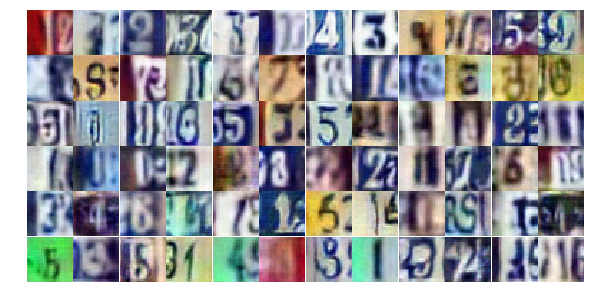

Epoch 23/25... Discriminator Loss: 0.9185... Generator Loss: 0.8383
Epoch 23/25... Discriminator Loss: 0.6328... Generator Loss: 1.0324
Epoch 23/25... Discriminator Loss: 1.5198... Generator Loss: 0.3490
Epoch 23/25... Discriminator Loss: 0.4869... Generator Loss: 1.6293
Epoch 23/25... Discriminator Loss: 0.9250... Generator Loss: 2.4799
Epoch 23/25... Discriminator Loss: 0.8133... Generator Loss: 0.9289
Epoch 23/25... Discriminator Loss: 1.1348... Generator Loss: 0.6270
Epoch 23/25... Discriminator Loss: 0.9374... Generator Loss: 0.8006
Epoch 23/25... Discriminator Loss: 0.8585... Generator Loss: 0.7500
Epoch 23/25... Discriminator Loss: 0.7026... Generator Loss: 1.1200


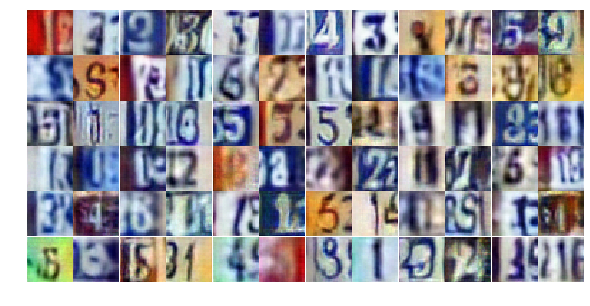

Epoch 23/25... Discriminator Loss: 0.6913... Generator Loss: 0.9938
Epoch 23/25... Discriminator Loss: 1.3328... Generator Loss: 0.4466
Epoch 23/25... Discriminator Loss: 0.9915... Generator Loss: 0.6971
Epoch 23/25... Discriminator Loss: 0.3641... Generator Loss: 1.5705
Epoch 23/25... Discriminator Loss: 1.1661... Generator Loss: 0.5498
Epoch 23/25... Discriminator Loss: 0.9007... Generator Loss: 0.7193
Epoch 23/25... Discriminator Loss: 1.0381... Generator Loss: 0.6198
Epoch 24/25... Discriminator Loss: 0.6449... Generator Loss: 1.1248
Epoch 24/25... Discriminator Loss: 0.7989... Generator Loss: 1.3713
Epoch 24/25... Discriminator Loss: 1.3762... Generator Loss: 0.4712


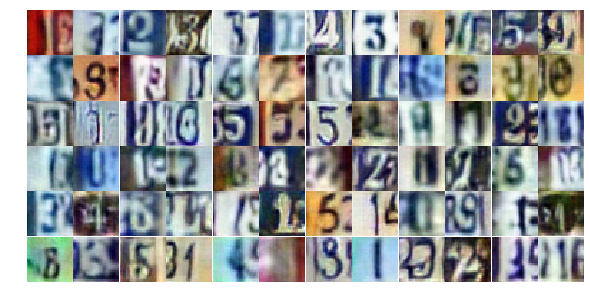

Epoch 24/25... Discriminator Loss: 0.5805... Generator Loss: 1.5778
Epoch 24/25... Discriminator Loss: 0.7154... Generator Loss: 0.9867
Epoch 24/25... Discriminator Loss: 0.6829... Generator Loss: 0.9635
Epoch 24/25... Discriminator Loss: 0.7410... Generator Loss: 1.1100
Epoch 24/25... Discriminator Loss: 1.0870... Generator Loss: 0.5812
Epoch 24/25... Discriminator Loss: 0.5272... Generator Loss: 1.2852
Epoch 24/25... Discriminator Loss: 0.8720... Generator Loss: 0.8011
Epoch 24/25... Discriminator Loss: 1.0425... Generator Loss: 0.6623
Epoch 24/25... Discriminator Loss: 0.4307... Generator Loss: 1.4544
Epoch 24/25... Discriminator Loss: 0.3957... Generator Loss: 1.7849


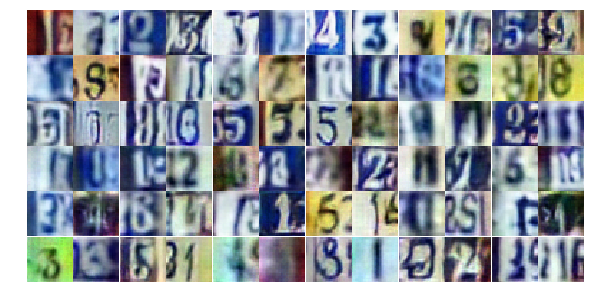

Epoch 24/25... Discriminator Loss: 0.9688... Generator Loss: 0.7263
Epoch 24/25... Discriminator Loss: 0.9217... Generator Loss: 1.0344
Epoch 24/25... Discriminator Loss: 0.9325... Generator Loss: 0.7910
Epoch 24/25... Discriminator Loss: 0.6542... Generator Loss: 0.9449
Epoch 24/25... Discriminator Loss: 0.8855... Generator Loss: 2.2729
Epoch 24/25... Discriminator Loss: 1.0533... Generator Loss: 0.7882
Epoch 24/25... Discriminator Loss: 0.6819... Generator Loss: 1.0256
Epoch 24/25... Discriminator Loss: 1.3198... Generator Loss: 0.4408
Epoch 24/25... Discriminator Loss: 0.7746... Generator Loss: 1.0271
Epoch 24/25... Discriminator Loss: 1.2418... Generator Loss: 0.4715


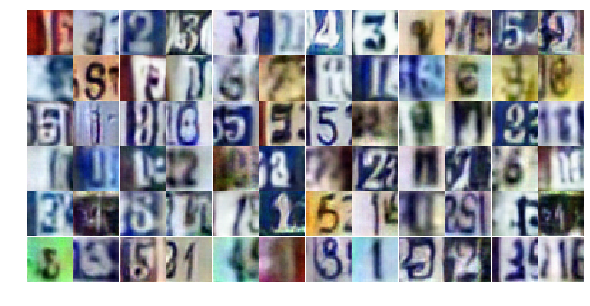

Epoch 24/25... Discriminator Loss: 0.6513... Generator Loss: 1.4625
Epoch 24/25... Discriminator Loss: 0.4575... Generator Loss: 1.6794
Epoch 24/25... Discriminator Loss: 0.5751... Generator Loss: 1.6497
Epoch 24/25... Discriminator Loss: 1.6066... Generator Loss: 0.3244
Epoch 24/25... Discriminator Loss: 0.9316... Generator Loss: 0.7587
Epoch 24/25... Discriminator Loss: 0.7137... Generator Loss: 0.9842
Epoch 24/25... Discriminator Loss: 0.4767... Generator Loss: 1.2647
Epoch 24/25... Discriminator Loss: 0.6666... Generator Loss: 0.9655
Epoch 24/25... Discriminator Loss: 0.6971... Generator Loss: 1.0400
Epoch 24/25... Discriminator Loss: 0.6142... Generator Loss: 1.4263


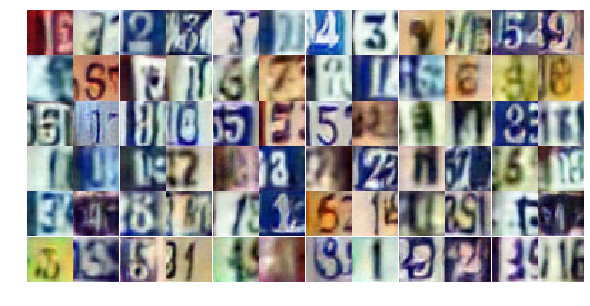

Epoch 24/25... Discriminator Loss: 0.5674... Generator Loss: 1.2672
Epoch 24/25... Discriminator Loss: 0.3570... Generator Loss: 1.7070
Epoch 24/25... Discriminator Loss: 1.4177... Generator Loss: 0.4387
Epoch 24/25... Discriminator Loss: 1.6003... Generator Loss: 0.3652
Epoch 24/25... Discriminator Loss: 0.7263... Generator Loss: 1.0176
Epoch 24/25... Discriminator Loss: 0.6163... Generator Loss: 1.1113
Epoch 24/25... Discriminator Loss: 1.2715... Generator Loss: 0.5493
Epoch 24/25... Discriminator Loss: 0.7348... Generator Loss: 0.9401
Epoch 24/25... Discriminator Loss: 0.7259... Generator Loss: 1.0634
Epoch 24/25... Discriminator Loss: 0.5569... Generator Loss: 1.4730


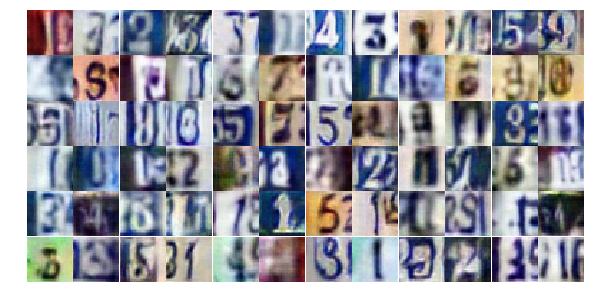

Epoch 24/25... Discriminator Loss: 0.6484... Generator Loss: 1.0167
Epoch 24/25... Discriminator Loss: 0.8260... Generator Loss: 0.8430
Epoch 24/25... Discriminator Loss: 1.0731... Generator Loss: 0.6181
Epoch 24/25... Discriminator Loss: 1.1122... Generator Loss: 1.6089
Epoch 24/25... Discriminator Loss: 1.5275... Generator Loss: 0.4414
Epoch 24/25... Discriminator Loss: 0.7230... Generator Loss: 1.0644
Epoch 24/25... Discriminator Loss: 1.2060... Generator Loss: 0.5503
Epoch 24/25... Discriminator Loss: 0.6478... Generator Loss: 1.0485
Epoch 24/25... Discriminator Loss: 0.8335... Generator Loss: 0.8393
Epoch 24/25... Discriminator Loss: 1.2635... Generator Loss: 2.9616


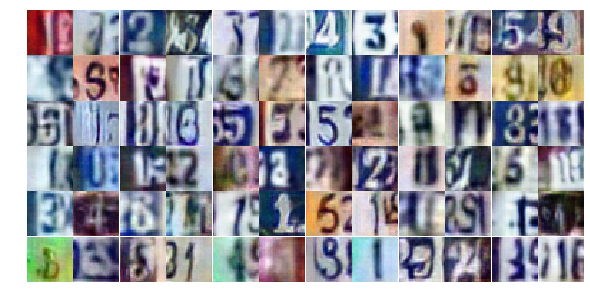

Epoch 24/25... Discriminator Loss: 1.1970... Generator Loss: 0.6616
Epoch 24/25... Discriminator Loss: 1.5000... Generator Loss: 0.4250
Epoch 24/25... Discriminator Loss: 1.7185... Generator Loss: 0.2948
Epoch 24/25... Discriminator Loss: 0.6485... Generator Loss: 1.0273
Epoch 24/25... Discriminator Loss: 1.0324... Generator Loss: 0.6510
Epoch 25/25... Discriminator Loss: 0.8629... Generator Loss: 0.8267
Epoch 25/25... Discriminator Loss: 0.5089... Generator Loss: 1.4885
Epoch 25/25... Discriminator Loss: 0.7999... Generator Loss: 0.8960
Epoch 25/25... Discriminator Loss: 0.8786... Generator Loss: 0.7438
Epoch 25/25... Discriminator Loss: 1.3742... Generator Loss: 0.4228


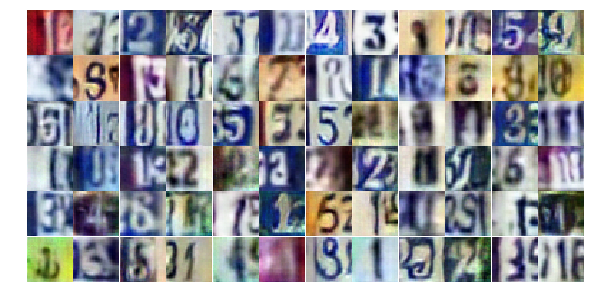

Epoch 25/25... Discriminator Loss: 0.9056... Generator Loss: 0.7658
Epoch 25/25... Discriminator Loss: 1.1269... Generator Loss: 0.5792
Epoch 25/25... Discriminator Loss: 0.7103... Generator Loss: 0.9432
Epoch 25/25... Discriminator Loss: 0.7443... Generator Loss: 1.1634
Epoch 25/25... Discriminator Loss: 0.9118... Generator Loss: 1.0078
Epoch 25/25... Discriminator Loss: 1.2265... Generator Loss: 0.5440
Epoch 25/25... Discriminator Loss: 0.5818... Generator Loss: 1.1629
Epoch 25/25... Discriminator Loss: 0.7757... Generator Loss: 0.9185
Epoch 25/25... Discriminator Loss: 0.4134... Generator Loss: 1.5435
Epoch 25/25... Discriminator Loss: 1.2720... Generator Loss: 0.5098


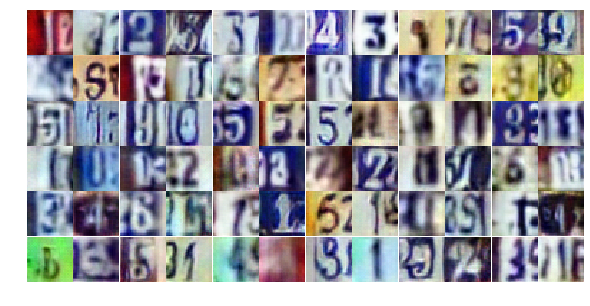

Epoch 25/25... Discriminator Loss: 0.7038... Generator Loss: 1.8303
Epoch 25/25... Discriminator Loss: 0.4696... Generator Loss: 3.3193
Epoch 25/25... Discriminator Loss: 1.4395... Generator Loss: 0.5092
Epoch 25/25... Discriminator Loss: 1.0622... Generator Loss: 0.6594
Epoch 25/25... Discriminator Loss: 1.0330... Generator Loss: 0.6730
Epoch 25/25... Discriminator Loss: 0.4750... Generator Loss: 1.4836
Epoch 25/25... Discriminator Loss: 0.9283... Generator Loss: 0.7846
Epoch 25/25... Discriminator Loss: 1.8610... Generator Loss: 0.2706
Epoch 25/25... Discriminator Loss: 0.7185... Generator Loss: 0.9803
Epoch 25/25... Discriminator Loss: 1.1498... Generator Loss: 0.6669


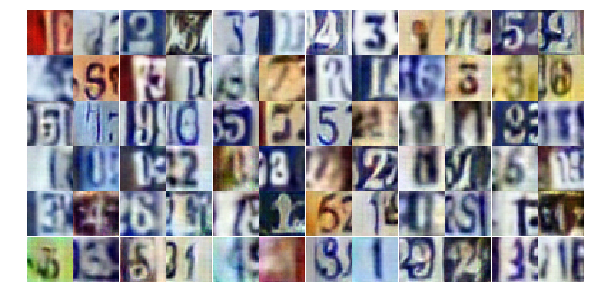

Epoch 25/25... Discriminator Loss: 1.0138... Generator Loss: 0.6782
Epoch 25/25... Discriminator Loss: 0.6072... Generator Loss: 2.3220
Epoch 25/25... Discriminator Loss: 1.3959... Generator Loss: 0.4812
Epoch 25/25... Discriminator Loss: 0.5490... Generator Loss: 1.3552
Epoch 25/25... Discriminator Loss: 0.8201... Generator Loss: 0.8745
Epoch 25/25... Discriminator Loss: 0.4469... Generator Loss: 1.3851
Epoch 25/25... Discriminator Loss: 0.8281... Generator Loss: 0.8376
Epoch 25/25... Discriminator Loss: 0.7513... Generator Loss: 1.0771
Epoch 25/25... Discriminator Loss: 0.9126... Generator Loss: 0.9998
Epoch 25/25... Discriminator Loss: 0.3999... Generator Loss: 1.8873


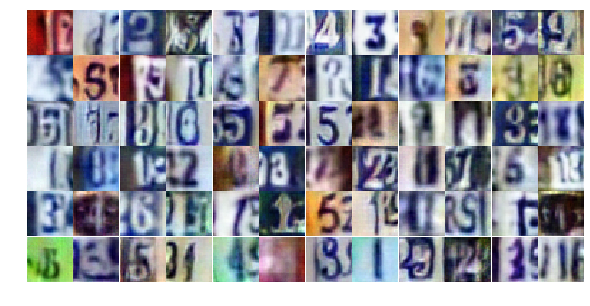

Epoch 25/25... Discriminator Loss: 0.9705... Generator Loss: 0.7291
Epoch 25/25... Discriminator Loss: 0.4886... Generator Loss: 1.3186
Epoch 25/25... Discriminator Loss: 0.7214... Generator Loss: 0.9985
Epoch 25/25... Discriminator Loss: 0.6264... Generator Loss: 1.0494
Epoch 25/25... Discriminator Loss: 1.0374... Generator Loss: 0.6619
Epoch 25/25... Discriminator Loss: 0.9518... Generator Loss: 0.6626
Epoch 25/25... Discriminator Loss: 0.5894... Generator Loss: 1.1004
Epoch 25/25... Discriminator Loss: 0.4155... Generator Loss: 1.5063
Epoch 25/25... Discriminator Loss: 2.0309... Generator Loss: 0.3340
Epoch 25/25... Discriminator Loss: 0.3874... Generator Loss: 1.8927


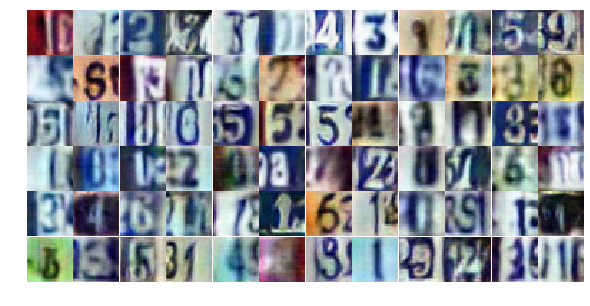

Epoch 25/25... Discriminator Loss: 1.0789... Generator Loss: 0.6949
Epoch 25/25... Discriminator Loss: 1.2910... Generator Loss: 0.5030
Epoch 25/25... Discriminator Loss: 0.8923... Generator Loss: 0.8614
Epoch 25/25... Discriminator Loss: 1.0187... Generator Loss: 0.6577
Epoch 25/25... Discriminator Loss: 1.0072... Generator Loss: 0.6545
Epoch 25/25... Discriminator Loss: 0.5360... Generator Loss: 1.1312
Epoch 25/25... Discriminator Loss: 0.9546... Generator Loss: 0.7398
Epoch 25/25... Discriminator Loss: 0.4966... Generator Loss: 1.3978
Epoch 25/25... Discriminator Loss: 0.6644... Generator Loss: 1.6532
Epoch 25/25... Discriminator Loss: 1.1088... Generator Loss: 0.6266


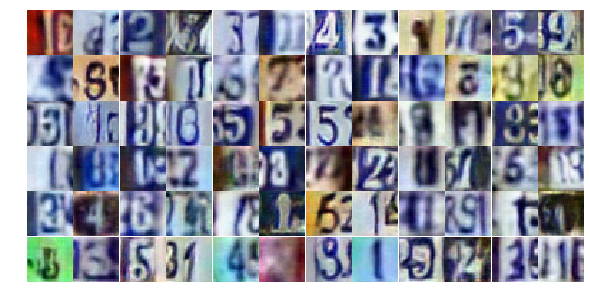

Epoch 25/25... Discriminator Loss: 0.7373... Generator Loss: 1.1639
Epoch 25/25... Discriminator Loss: 2.0988... Generator Loss: 0.2097


In [44]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

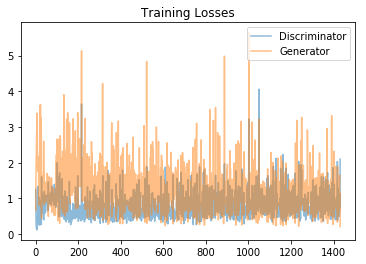

In [45]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

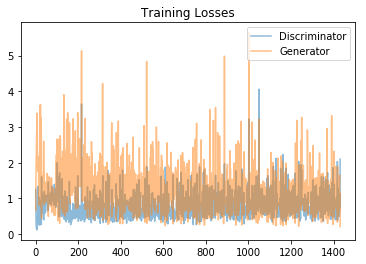

In [46]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


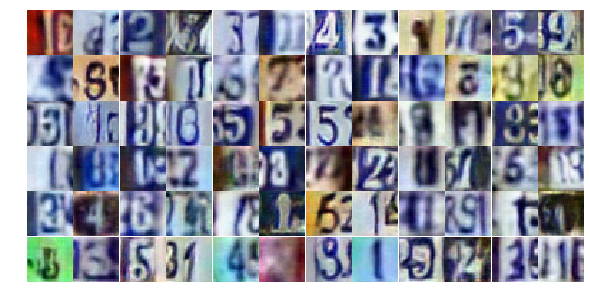

In [47]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


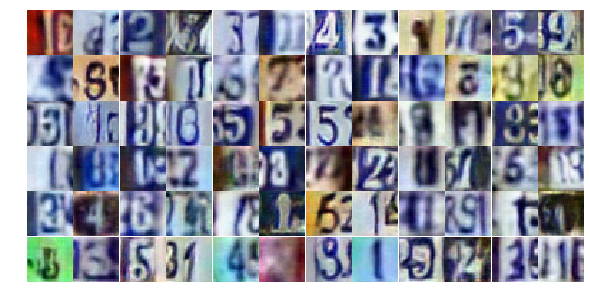

In [48]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))